# SEN163B Responsible Data Analytics

Group 3:
*   Machiel van der Wal	4944429,
*   Michiel Hutschemaekers	4968069,
*   Sam van de Kerkhove	4871766,
*   Tomás Franco	5899079,
*   Tycho van der Kruijk 4935632. 	

This notebooks includes all the code produced by group 3 for the SEN163B Responsible Data Analytics project. The notebook follows the same structure as produced in the report. For every part explanation and interpretation is provided in text boxes (similar to this one) and within the code itself. All pre-processed datasets and saved/loaded models will be provided with the notebook. 

Note however that the notebook is more extensive than the report itself. This notebook is build up by a lot of "doing by trying" and these steps are still included in the notebook, but not in the report itself. The structure of this notebook is as follows:


1.   Preliminary Analytics - pre-processing steps (feature selection and missing data)
2.   Descriptive Analytics - exploration of dataset through visualizations and statistics
3.   Diagnostic Analytics - exploring relationships (correlations and regression)
4.   Predictive Analytics - build predictive models
5.   Prescriptive Analtyics - models validation and improvements

The idea is that every part is runniable on its own by saving / loading edited datasets and models at every step

Link to the original dataset + metadata information: https://data.cityofnewyork.us/Public-Safety/NYPD-Complaint-Data-Historic/qgea-i56i







# 0. First step: loading the dataset

NOTE: loading the data can take a few minutes

In [3]:
import os
print(os.getcwd())

C:\Users\MichielHutschemaeker\OneDrive - NucleusX BV\Desktop\SEN163B


In [4]:
import pandas as pd

In [5]:
# downloaded from: https://data.cityofnewyork.us/Public-Safety/NYPD-Complaint-Data-Historic/qgea-i56i
Data = pd.read_csv(r'C:/Users/MichielHutschemaeker/OneDrive - NucleusX BV/Desktop/SEN163B/Data/NYPD_Complaint_Data_Historic.csv')

C:\Users\MichielHutschemaeker\AppData\Local\Temp\ipykernel_17768\2012800712.py:2: DtypeWarning: Columns (18,20) have mixed types. Specify dtype option on import or set low_memory=False.
  Data = pd.read_csv(r'C:/Users/MichielHutschemaeker/OneDrive - NucleusX BV/Desktop/SEN163B/Data/NYPD_Complaint_Data_Historic.csv')


# 1. Preliminary Analysis

The prelimninary Analysis is structured as follows:
1.   Feature selecting - exploring the features and selecting the relevant features
2.   Data Point Cleaning - selecting the relevant data points for this research
3.   Missing Value Cleaning - steps to deal with the missing values in the dataset
4.   Merging dataset A without EMS with dataset B with EMS

The idea is that every sub-part starts with loading the dataset and ends with writing the updated dataset. This way, once the program crashes, we do not have to start all over.

## 1.1 Feature Selecting

The first step when working with a dataset is knowing what information can be found in it. 

Therefore, we first analyze its metadata, looking for the number of features and their data type, and the number of the respective data points.


In [6]:
# Number of observations and number of variables
print("Number of Observations: ", Data.shape[0])
print("Number of Variables: ", Data.shape[1])

print("")
# Variable Types
print(Data.dtypes)


Number of Observations:  7825499
Number of Variables:  35

CMPLNT_NUM             int64
CMPLNT_FR_DT          object
CMPLNT_FR_TM          object
CMPLNT_TO_DT          object
CMPLNT_TO_TM          object
ADDR_PCT_CD          float64
RPT_DT                object
KY_CD                  int64
OFNS_DESC             object
PD_CD                float64
PD_DESC               object
CRM_ATPT_CPTD_CD      object
LAW_CAT_CD            object
BORO_NM               object
LOC_OF_OCCUR_DESC     object
PREM_TYP_DESC         object
JURIS_DESC            object
JURISDICTION_CODE    float64
PARKS_NM              object
HADEVELOPT            object
HOUSING_PSA           object
X_COORD_CD           float64
Y_COORD_CD           float64
SUSP_AGE_GROUP        object
SUSP_RACE             object
SUSP_SEX              object
TRANSIT_DISTRICT     float64
Latitude             float64
Longitude            float64
Lat_Lon               object
PATROL_BORO           object
STATION_NAME          object
VIC_AGE_GROUP

The second step is to look at the missing values per variable.

The percentage of missing values for each of the features is computed to evaluate the amount of missing data (due to for example, unproper information collection, or insufficient information at the time of registration) and to identify possible structural problems in the data collection process, and to give a first glimpse in which features might be of greater value for our analysis.

The percentage of data points with one or more data values missing is also computed, to assess how propagated the missing values are in the data. With the variables considered, virtually every data point has a missing value for one or more features.



In [7]:
# Percentage of missing values for each variable
Variables_NA = (Data.isna().sum()/Data.shape[0]*100).sort_values(ascending=False)
print(Variables_NA)

print("")
#Percentage rows with at least one missing value
Rows_NA = (Data.shape[0] - Data.dropna().shape[0]) / Data.shape[0]
print(Rows_NA)

PARKS_NM             99.605712
STATION_NAME         97.795987
TRANSIT_DISTRICT     97.795987
HADEVELOPT           95.548028
HOUSING_PSA          92.341792
SUSP_AGE_GROUP       62.403292
SUSP_SEX             46.618650
SUSP_RACE            44.915065
CMPLNT_TO_DT         22.289876
CMPLNT_TO_TM         22.228346
VIC_AGE_GROUP        20.937259
LOC_OF_OCCUR_DESC    20.676803
PREM_TYP_DESC         0.536899
OFNS_DESC             0.240649
Y_COORD_CD            0.221571
X_COORD_CD            0.221571
Lat_Lon               0.221571
Latitude              0.221571
Longitude             0.221571
BORO_NM               0.159479
PATROL_BORO           0.092237
PD_DESC               0.086397
PD_CD                 0.086397
JURISDICTION_CODE     0.086397
ADDR_PCT_CD           0.027679
CMPLNT_FR_DT          0.008370
VIC_RACE              0.004984
VIC_SEX               0.003936
CRM_ATPT_CPTD_CD      0.002147
CMPLNT_FR_TM          0.000613
JURIS_DESC            0.000000
LAW_CAT_CD            0.000000
KY_CD   

The third step is to look at the categorical values

In terms of data, tables with all the unique possible values for categorical features are extracted. This way, the value range of the different features is deduced. Doing this helps identify irregularities in the value ranges of the respective features.

The following tables were extracted:

*   KY_Table - KY_CD codes and their respective description
*   PD_Table - PD_CD codes and their respective description
*   KY_PD_Table - Correspondence of KY_CD and PD_CD codes and their respective descriptions
*   ADDR_PCT_Table - Precinct codes where the incidents took place
*   PREM_TYP_Table - Types of premises in which the incidents took place
*   SUSP_AGE_GROUP_Table - Age groups of the suspect
*   VIC_AGE_GROUP_Table - Age groups of the victim

NOTE: This part of the analysis was more for understanding the data and therefore a # is put before the code

The KY_Table and PD_Table give insight about which crimes might lead to the  need of an EMS intervention.

In [8]:
# Get the KY_CD codes and their respective OFNS_DESC descriptions

#KY_Table = Data[['KY_CD', 'OFNS_DESC']].loc[Data[['KY_CD', 'OFNS_DESC']].drop_duplicates(subset=['KY_CD']).index]
#KY_Table.to_excel(r"/content/drive/My Drive/Colab Notebooks/SEN163B/Tables/KY_Table.xlsx")

In [9]:
# Get the PD_CD codes and their respective PD_DESC descriptions

#PD_Table = Data[['PD_CD', 'PD_DESC']].loc[Data[['PD_CD', 'PD_DESC']].drop_duplicates(subset=['PD_CD']).index]
#PD_Table.to_excel(r"/content/drive/My Drive/Colab Notebooks/PD_Table.xlsx")

The KY_CD_Table shows the correspondence of the PD_CD codes to the KY_CD codes, enabling a deeper understanding of the types of incidents identifies by the KY_CD codes. It also makes it possible to, further in the analysis, to filter out some types of incidents within a KY_CD code that are not aligned with the criteria established for an EMS intervention to be needed.  

In [10]:
# Create Excel Sheet with KY Codes and PD Codes

#KY_PD_Table = Data[['KY_CD', 'PD_CD']].loc[Data[['KY_CD', 'PD_CD']].drop_duplicates(subset=['PD_CD']).index]
#KY_PD_Table.to_excel(r"/content/drive/My Drive/Colab Notebooks/KY_PD_Table_It2.xlsx")

The ADDR_PCT_Table categorizes the NY Police precinct codes where the incidents happened, but does not provide a description of the different places.

In [11]:
# Get the ADDR_PCT_CD possible values

#ADDR_PCT_Table = Data.drop_duplicates(subset=['ADDR_PCT_CD'])['ADDR_PCT_CD']
#ADDR_PCT_Table.to_excel(r"/content/drive/My Drive/Colab Notebooks/ADDR_PCT_CD.xlsx")

The PREM_TYP_Table provides information about the type of space where the incidents have happened. One may see that there are 74 different premise categories. 



After exploring the different categorical variables, the next step is to simplify some variables 


To categorize the different premises even further to prevent unnecessary complexity in future operations, the existing categories were condensed in 18 urban space categories (4 main categories, and 14 subcategories - each former category is allocated to one main category and one subcategory), having [M. Carmona's "Urban Space Types" Table in Contemporary Public Space, Part Two:
Classification (2010)](http://urbandesign.ir/wp-content/uploads/2017/11/Contemporary-Public-Space-Part-Two-Classification.pdf) as fundament for this classification. (source also in the reference of the report)

This process involved the creation of dummy variables representing the different urban space types and combining the different premise types with the latter. For this purpose, a table (PREM_Table_Dummies) was manually created.

In [12]:
# Get the PREM_TYP_DESC descriptions

#PREM_Table = Data.drop_duplicates(subset=['PREM_TYP_DESC'])['PREM_TYP_DESC']
#PREM_Table.to_excel(r"/content/drive/My Drive/Colab Notebooks/PREM_Table.xlsx")

The SUSP_AGE_GROUP_Table and VIC_AGE_GROUP_Table help identify an error that comprises a small fraction of the data values. Instead of identifying an age range, the values are numerical, comprising negative and positive integers. For data points in which this is verified, the age group feature value will be changed to "Unknown", as it doesn't seem to be possible to infer the age group from the given values.

In [13]:
# Get the SUSP_AGE_GROUP possible values

#SUSP_AGE_Table = Data.drop_duplicates(subset=['SUSP_AGE_GROUP'])['SUSP_AGE_GROUP']
#SUSP_AGE_Table.to_excel(r"/content/drive/My Drive/Colab Notebooks/SUSP_AGE.xlsx")

In [14]:
Data['SUSP_AGE_GROUP'] = Data['SUSP_AGE_GROUP'].apply(lambda x: (x if x == "<18"
or x == "18-24"
or x == "25-44" 
or x == "45-64"
or x == "65+"
or x == "UNKNOWN" else "UNKNOWN"))

In [15]:
# Get the VIC_AGE_GROUP possible values

#VIC_AGE_Table = Data.drop_duplicates(subset=['VIC_AGE_GROUP'])['VIC_AGE_GROUP']
#VIC_AGE_Table.to_excel(r"/content/drive/My Drive/Colab Notebooks/VIC_AGE.xlsx")

In [16]:
Data['VIC_AGE_GROUP'] = Data['VIC_AGE_GROUP'].apply(lambda x: (x if x == "<18"
or x == "18-24"
or x == "25-44" 
or x == "45-64"
or x == "65+"
or x == "UNKNOWN" else "UNKNOWN"))


As a first step in defining the dataset to be used in further analysis, priorities are defined in terms of which features shall be included and excluded. Features to be included shall be in accordance with the following principles:

*   Included features bring to light new information about the data point, that cannot be derived from already known features. (Redundancy)
*   Included features are believed to be helpful in identifying patterns/correlations that may help in the response to the research questions. (Relevance)

Having this in mind, a set of features have been filtered out from the dataset, for both their redundancy and irrelevance for the proposed research
These comprise the following:

*   CMPLNT_NUM - Randomly generated persistent ID for each complaint
> A general ID generated by pandas will be used instead. This feature does not contain any useful information about a registered occurrence.

*   OFNS_DESC - Description of offense corresponding with key code
> The KY_Table may be used to find the description of the respective code in each data point. This way, redundant information is removed from the dataset. (Approximation to Database normalized design and performance optimization)

*   PD_DESC - Description of internal classification corresponding with PD code (more granular than Offense Description)
> The PD_Table may be used to find the description of the respective code in each data point. This way, redundant information is removed from the dataset. (Approximation to Database normalized design and performance optimization)

*   CRM_ATPT_CPTD_CD - Indicator of whether crime was successfully completed or attempted, but failed or was interrupted prematurely
> Whether a crime is successful or not, if it might need EMS intervention due to its nature, shall not change the decision of activiting a EMS response or not. To optimize the EMS response shall not comprise assessing if a crime might fail or not. It a service to be provided regardless of the outcome, which is considered to not be predictable, for ethical reasons.

*   JURIS_DESC - Jurisdiction responsible for incident. Either internal, like Police, Transit, and Housing; or external, like Correction, Port Authority, etc.
> The JURIS_Table may be used to find the description of the respective code in each data point. This way, redundant information is removed from the dataset. (Approximation to Database normalized design and performance optimization)

In the case of this particular dataset, it was decided to be reasonable to filter out features that have a big fraction of missing data. This is the case for the features PARKS_NM, STATION_NAME, TRANSIT_DISTRICT, HADEVELOPT, HOUSING_PSA, which have a percentage of missing values all above 90%.

*   PARKS_NM - Name of NYC park, playground or greenspace of 
occurrence, if applicable (state parks are not included)
> As seen before, this variable has a percentage of 99.60% blank values, meaning that almost all of the data points do not have a value for this feature. 

*   STATION_NAME - Name of the subway station where the incident happened
> As this only applies for crimes that happen in the subway (97.76% of missing values), and there is already information about the premise through the PREM_Table_Dummies, there is no need to know the specific name of the station, as the analysis of crimes needing EMS intervention in different subway stations is out of the scope of the proposed project questions.

*   TRANSIT_DISTRICT - Transit District in which the incident happened
> Also having to do with crimes happening in subway stations (97.76% of missing values), this feature is considered to be ignorable.

*   HADEVELOPT - Name of NYCHA housing development of occurrence, if 
applicable
> Having a percentage of 95.55% missing values, this feature only has a defined value when a crime takes place in one of NYCHA house developments. As there is already information about the premise through the PREM_Table_Dummies, its borough and coordinates, for the purpose of this research, it is not necessary to know the specific name of the private space the incident happens.

*   HOUSING_PSA - Development Level Code
>With 92.34% of missing values, this feature is  only used when an incident has occured in Public Housing. As there is already information about the premise through the PREM_Table_Dummies, its borough and coordinates, for the purpose of this research, it is not necessary to know the specific name of the private space the incident happens.

*   X_COORD_CD - X-coordinate for New York State Plane Coordinate System
*   Y_COORD_CD - Y-coordinate for New York State Plane Coordinate System
> As coordinates using the Global Coordinate System are also given, this specific local system is dropped. 


*   Lat_Lon -  Concatenation of X- and Y-Coordinates using the Global Coordinate System
> Both coordinates are already given. If needed, this string can be computed.

In [17]:
# Eliminate variables that are out-of-scope or are not needed for the project questions defined

Data.drop(['CMPLNT_NUM','OFNS_DESC','PD_DESC','CRM_ATPT_CPTD_CD','JURIS_DESC', 'PARKS_NM', 'HADEVELOPT', 'HOUSING_PSA', 
           'TRANSIT_DISTRICT', 'Lat_Lon', 'X_COORD_CD', 'Y_COORD_CD', 'STATION_NAME'],axis='columns', inplace=True)

The metadata is again evaluated. 13 out of 35 variables have been eliminated.

In [18]:
# Number of observations and number of variables
print("Number of Observations: ", Data.shape[0])
print("Number of Variables: ", Data.shape[1])

print("")
# Variable Types
print(Data.dtypes)


Number of Observations:  7825499
Number of Variables:  22

CMPLNT_FR_DT          object
CMPLNT_FR_TM          object
CMPLNT_TO_DT          object
CMPLNT_TO_TM          object
ADDR_PCT_CD          float64
RPT_DT                object
KY_CD                  int64
PD_CD                float64
LAW_CAT_CD            object
BORO_NM               object
LOC_OF_OCCUR_DESC     object
PREM_TYP_DESC         object
JURISDICTION_CODE    float64
SUSP_AGE_GROUP        object
SUSP_RACE             object
SUSP_SEX              object
Latitude             float64
Longitude            float64
PATROL_BORO           object
VIC_AGE_GROUP         object
VIC_RACE              object
VIC_SEX               object
dtype: object


Now, the feature with the greatest percentage of missing values is the SUSP_SEX, with 46.62%, followed by SUSP_Race. Although one may feel tempted to try to treat these missing values at this stage, it is also expected that these missing values may decrease (or disappear) with the filtering of crimes that are not related to the project questions proposed. Therefore, these two features, along with the characteristics of the victim (VIC_RACE and VIC_SEX) will be evaluated after all other filtering operations have been carried out and treated according to the nature of the missing values.

Also, one can see that now 34.43% of the data points have values for all different features.

In [19]:
# Percentage of missing values for each variable
Variables_NA = (Data.isna().sum()/Data.shape[0]*100).sort_values(ascending=False)
print(Variables_NA)

print("")

# Percentage rows with at least one missing value
Rows_NA = (Data.shape[0] - Data.dropna().shape[0]) / Data.shape[0]
print(Rows_NA)

SUSP_SEX             46.618650
SUSP_RACE            44.915065
CMPLNT_TO_DT         22.289876
CMPLNT_TO_TM         22.228346
LOC_OF_OCCUR_DESC    20.676803
PREM_TYP_DESC         0.536899
Longitude             0.221571
Latitude              0.221571
BORO_NM               0.159479
PATROL_BORO           0.092237
PD_CD                 0.086397
JURISDICTION_CODE     0.086397
ADDR_PCT_CD           0.027679
CMPLNT_FR_DT          0.008370
VIC_RACE              0.004984
VIC_SEX               0.003936
CMPLNT_FR_TM          0.000613
SUSP_AGE_GROUP        0.000000
LAW_CAT_CD            0.000000
KY_CD                 0.000000
RPT_DT                0.000000
VIC_AGE_GROUP         0.000000
dtype: float64

0.6556632362996916


One can still see that there is a significant percentage of values missing for the CMPLNT_TO_DT, CMPLNT_TO_TM and LOC_OF_OCCUR_DESC features. 

Regarding the former, the features will be converted to the datetime data type and will be assigned the same value as their CMPLNT_FR_DT and CMPLNT_FR_TM counterparts, assuming so that the occurence was punctual if the FR dates and times do not exist, the inverse process is carried out. If data is still missing, dates are given the value "Date Unknown" and times the value "Time Unknown".

This decision could potentially have a lot of impact on the further analyis. However, all the variables regarding dates is for the rest of the analysis not an important feature

NOTE: The following code may take some time to run

In [20]:
import datetime as dt

# Convert dates from Object type to DateTime

Data['RPT_DT'] = pd.to_datetime(Data['RPT_DT'])
Data['CMPLNT_FR_DT'] = pd.to_datetime(Data['CMPLNT_FR_DT'], errors='coerce')
Data['CMPLNT_FR_TM'] = pd.to_datetime(Data['CMPLNT_FR_TM'], errors='coerce', format="%H:%M:%S")
Data['CMPLNT_TO_DT'] = pd.to_datetime(Data['CMPLNT_TO_DT'], errors='coerce')
Data['CMPLNT_TO_TM'] = pd.to_datetime(Data['CMPLNT_TO_TM'], errors='coerce', format="%H:%M:%S")

# Fill missing values (CMPLNT_TO_DT and CMPLNT_FR_DT)
Data['CMPLNT_TO_DT'].fillna(Data['CMPLNT_FR_DT'], axis = 0, inplace = True)
Data['CMPLNT_FR_DT'].fillna(Data['CMPLNT_TO_DT'], axis = 0, inplace = True)
Data['CMPLNT_FR_DT'].fillna("Date Unknown", axis = 0, inplace = True)
Data['CMPLNT_TO_DT'].fillna("Date Unknown", axis = 0, inplace = True)

# Fill missing values (COMPLNT_TO_DT)
Data['CMPLNT_TO_TM'].fillna(Data['CMPLNT_FR_TM'], axis = 0, inplace = True)
Data['CMPLNT_FR_TM'].fillna(Data['CMPLNT_TO_TM'], axis = 0, inplace = True)
Data['CMPLNT_FR_TM'].fillna("Time Unknown", axis = 0, inplace = True)
Data['CMPLNT_TO_TM'].fillna("Time Unknown", axis = 0, inplace = True)

Results: there are no more missing values concerning the complaint dates and times. The percentage of data points without missing values also rose to 43.69%

In [21]:
# Percentage of missing values for each variable
Variables_NA = (Data.isna().sum()/Data.shape[0]*100).sort_values(ascending=False)
print(Variables_NA)

print("")
# Percentage of rows with at least one missing value
Rows_NA = (Data.shape[0] - Data.dropna().shape[0]) / Data.shape[0]
print(Rows_NA)

SUSP_SEX             46.618650
SUSP_RACE            44.915065
LOC_OF_OCCUR_DESC    20.676803
PREM_TYP_DESC         0.536899
Longitude             0.221571
Latitude              0.221571
BORO_NM               0.159479
PATROL_BORO           0.092237
JURISDICTION_CODE     0.086397
PD_CD                 0.086397
ADDR_PCT_CD           0.027679
VIC_RACE              0.004984
VIC_SEX               0.003936
SUSP_AGE_GROUP        0.000000
CMPLNT_FR_TM          0.000000
LAW_CAT_CD            0.000000
KY_CD                 0.000000
RPT_DT                0.000000
CMPLNT_TO_TM          0.000000
VIC_AGE_GROUP         0.000000
CMPLNT_TO_DT          0.000000
CMPLNT_FR_DT          0.000000
dtype: float64

0.5631084995346622


The feature LOC_OF_OCCUR_DESC is a detail in terms of spatial location of the incident. For this analysis, it may be of great importance to know in which part of a premise the incident occurs (inside, opposite of, front of, rear of), specially in the case of buildings, as it may require different approaches by an ambulance of the EMS and the respective operational staff. According to the dataset, values seem to be missing in cases where the possible values for this variable aren´t helpful in determining the incident's specific location (e. g. Street, or, in general, open spaces or confined spaces)

This way, missing values are replaced with "Not applicable".

In [22]:
Data['LOC_OF_OCCUR_DESC'].fillna("Not Applicable", axis = 0, inplace = True)

Results: the percentage of data points without missing values increased to 53.07%. The remaining variables with missing values will be evaluated at the end of the cleaning process, as some of the missing data might be related to a specific set of types of crimes, that are not part of the scope of this project.

In [23]:
# Percentage of missing values for each variable
Variables_NA = (Data.isna().sum()/Data.shape[0]*100).sort_values(ascending=False)
print(Variables_NA)

print("")
# Percentage of rows with at least one missing value
Rows_NA = (Data.shape[0] - Data.dropna().shape[0]) / Data.shape[0]
print(Rows_NA)

SUSP_SEX             46.618650
SUSP_RACE            44.915065
PREM_TYP_DESC         0.536899
Longitude             0.221571
Latitude              0.221571
BORO_NM               0.159479
PATROL_BORO           0.092237
JURISDICTION_CODE     0.086397
PD_CD                 0.086397
ADDR_PCT_CD           0.027679
VIC_RACE              0.004984
VIC_SEX               0.003936
CMPLNT_FR_TM          0.000000
SUSP_AGE_GROUP        0.000000
LOC_OF_OCCUR_DESC     0.000000
LAW_CAT_CD            0.000000
KY_CD                 0.000000
RPT_DT                0.000000
CMPLNT_TO_TM          0.000000
VIC_AGE_GROUP         0.000000
CMPLNT_TO_DT          0.000000
CMPLNT_FR_DT          0.000000
dtype: float64

0.46934233842468065


To get a grasp on the degree of urgency of different incidents, an engineered feature composed of the difference between the date of the occurence and the date of report to Police is added to the dataset.

NOTE: The following code can take some time to run

In [24]:
# Data['CMPLNT_FR_DT'] = Data['CMPLNT_FR_DT'].apply(lambda x: (x[:-4] + '2' + x[-3:] if x[-4] == "2" else x))
# Data['CMPLNT_FR_DT'] = Data['CMPLNT_FR_DT'].apply(lambda x: dt.datetime.strptime(x,'%m/%d/%Y') if type(x)==str else pd.NaT)
Data['Occurrence_Report_Interval'] = Data.apply(lambda x: (x['RPT_DT'] - x['CMPLNT_FR_DT']).days if x['CMPLNT_FR_DT'] != "Date Unknown" else "Unknown", axis=1)


The resulting dataset will be saved into a new file: **Data_Feat_Clean.cvs**

In [25]:
Data.to_csv(r'C:/Users/MichielHutschemaeker/OneDrive - NucleusX BV/Desktop/SEN163B/Data/Data_Feat_Clean.csv')


The rest of this project will work with two different datasets. One where all crimes that are not likely to require EMS are removed (for now refered to as dataset A) and one where there is a binary variable added with a 1 for likely to require EMS and a 0 for not likely to require EMS (now refered to as dataset B)

The rest of the preliminary analysis will also differentiate between these two datasets. First the preprocess steps for the dataset with crimes not likely to require EMS are explained and after, the preprocess steps for the dataset with the binary EMS variable. 

In [26]:
# clear RAM with a garbage collect 
import gc
gc.collect()

0

## 1.2.A Data Point Analysis (Dataset A)

With all the irrelevant features excluded, the next step is to look at the data points. But first,  load the dataset  

In [27]:
Data = pd.read_csv(r'C:/Users/MichielHutschemaeker/OneDrive - NucleusX BV/Desktop/SEN163B/Data/Data_Feat_Clean.csv')

C:\Users\MichielHutschemaeker\AppData\Local\Temp\ipykernel_17768\1948515101.py:1: DtypeWarning: Columns (23) have mixed types. Specify dtype option on import or set low_memory=False.
  Data = pd.read_csv(r'C:/Users/MichielHutschemaeker/OneDrive - NucleusX BV/Desktop/SEN163B/Data/Data_Feat_Clean.csv')


In [28]:
Data.head()

,Unnamed: 0,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,ADDR_PCT_CD,RPT_DT,KY_CD,PD_CD,LAW_CAT_CD,...,SUSP_AGE_GROUP,SUSP_RACE,SUSP_SEX,Latitude,Longitude,PATROL_BORO,VIC_AGE_GROUP,VIC_RACE,VIC_SEX,Occurrence_Report_Interval
0,0,2018-03-29 00:00:00,1900-01-01 20:30:00,2018-03-29 00:00:00,1900-01-01 20:30:00,32.0,2018-03-30,351,254.0,MISDEMEANOR,...,UNKNOWN,NaN,NaN,40.810877,-73.941064,PATROL BORO MAN NORTH,25-44,WHITE,F,1
1,1,2018-02-06 00:00:00,1900-01-01 23:15:00,2018-02-06 00:00:00,1900-01-01 23:15:00,52.0,2018-02-07,341,333.0,MISDEMEANOR,...,45-64,BLACK,F,40.873671,-73.908014,PATROL BORO BRONX,UNKNOWN,UNKNOWN,D,1
2,2,2018-11-21 00:00:00,1900-01-01 00:15:00,2018-11-21 00:00:00,1900-01-01 00:20:00,75.0,2018-11-21,341,321.0,MISDEMEANOR,...,25-44,WHITE HISPANIC,F,40.651782,-73.885457,PATROL BORO BKLYN NORTH,UNKNOWN,UNKNOWN,D,0
3,3,2018-06-09 00:00:00,1900-01-01 21:42:00,2018-06-09 00:00:00,1900-01-01 21:43:00,10.0,2018-06-10,361,639.0,MISDEMEANOR,...,25-44,WHITE HISPANIC,M,40.759310,-73.994706,PATROL BORO MAN SOUTH,18-24,WHITE HISPANIC,F,1
4,4,2018-11-10 00:00:00,1900-01-01 19:40:00,2018-11-10 00:00:00,1900-01-01 19:45:00,19.0,2018-11-10,341,333.0,MISDEMEANOR,...,<18,BLACK HISPANIC,F,40.764536,-73.970728,PATROL BORO MAN NORTH,UNKNOWN,UNKNOWN,D,0


### 1.2.A.1 First Iteration (EMS identification)

At this stage, types of crimes (characterized by the KY_CD codes) that do not present an obvious need for intervention by the EMS are disconsidered. The criteria used to evaluate the need for the EMS were the following:

*   Imminent or actual physical harm inflicted onto the victim through direct physical contact with the offender or tools used by the latter.
*   Imminent or actual physical harm of victim during the offense not directly inflicted by the offender, but by the victim themself or its surrounding environment.

Having these two criteria in mind, the following KY_CD codes were removed from analysis (some of the codes have been mantained due to missing information about their nature. Their relevance will be assessed further on when combined with the granular PD_CD code):

* 107	BURGLARY
* 109	GRAND LARCENY
* 110	GRAND LARCENY OF MOTOR VEHICLE
* 111	POSSESSION OF STOLEN PROPERTY
* 112	THEFT-FRAUD
* 113	FORGERY
* 115	PROSTITUTION & RELATED OFFENSES
* 120	CHILD ABANDONMENT/NON SUPPORT
* 121	CRIMINAL MISCHIEF & RELATED OF
* 122	GAMBLING
* 123	ABORTION
* 231	BURGLAR'S TOOLS
* 232	POSSESSION OF STOLEN PROPERTY
* 237	ESCAPE 3
* 238	FRAUDULENT ACCOSTING
* 340	FRAUDS
* 341	PETIT LARCENY
* 342	PETIT LARCENY OF MOTOR VEHICLE
* 343	OTHER OFFENSES RELATED TO THEF
* 349	DISRUPTION OF A RELIGIOUS SERV
* 350	GAMBLING
* 351	CRIMINAL MISCHIEF & RELATED OF
* 352	CRIMINAL TRESPASS
* 353	UNAUTHORIZED USE OF A VEHICLE
* 357	FORTUNE TELLING
* 358	OFFENSES INVOLVING FRAUD
* 359 OFFENSES AGAINST PUBLIC ADMINI
* 362	OFFENSES AGAINST MARRIAGE UNCL
* 364	OTHER STATE LAWS (NON PENAL LA
* 365	ADMINISTRATIVE CODE
* 455	UNLAWFUL POSS. WEAP. ON SCHOOL
* 460	LOITERING/DEVIATE SEX
* 571	LOITERING/GAMBLING (CARDS, DIC
* 672	LOITERING
* 675	ADMINISTRATIVE CODE
* 685	ADMINISTRATIVE CODES
* 881	OTHER TRAFFIC INFRACTION

In [29]:
# Eliminate lines by types of crime that do not present an obvious need for interventions of the EMS

Data = Data.drop(Data[Data.KY_CD.isin([107,109,110,111,112,113,115,120,121,122,123,231,232,234,237,238,340,341,
                                342,343,349,350,351,352,353,357,358,359,362,364,365,455,460,571,672,675,685,881])].index)

With this filtering action, more than 3.5 million data points were removed from the dataset.

In [30]:
# Number of observations and number of variables
print("Observations: ", Data.shape[0])
print("Variables: ", Data.shape[1])

print("")
# Variable Types
print(Data.dtypes)

Observations:  4032972
Variables:  24

Unnamed: 0                      int64
CMPLNT_FR_DT                   object
CMPLNT_FR_TM                   object
CMPLNT_TO_DT                   object
CMPLNT_TO_TM                   object
ADDR_PCT_CD                   float64
RPT_DT                         object
KY_CD                           int64
PD_CD                         float64
LAW_CAT_CD                     object
BORO_NM                        object
LOC_OF_OCCUR_DESC              object
PREM_TYP_DESC                  object
JURISDICTION_CODE             float64
SUSP_AGE_GROUP                 object
SUSP_RACE                      object
SUSP_SEX                       object
Latitude                      float64
Longitude                     float64
PATROL_BORO                    object
VIC_AGE_GROUP                  object
VIC_RACE                       object
VIC_SEX                        object
Occurrence_Report_Interval     object
dtype: object


One can see that through this process the percentage of missing values concerning the crime suspects dropped between 10 and 15 percentual points, which could be explained by the nature of the dropped incidents and strengthens the criteria chosen to filter out the types of crimes. The percentage of data point without missing values also increased, about 15 pp.

In [31]:
# Percentage of missing values for each variable
Variables_NA = (Data.isna().sum()/Data.shape[0]*100).sort_values(ascending=False)
print(Variables_NA)

print("")
# Percentage rows with at least one missing value
Rows_NA = (Data.shape[0] - Data.dropna().shape[0]) / Data.shape[0]
print(Rows_NA)

SUSP_SEX                      31.563795
SUSP_RACE                     30.266885
PREM_TYP_DESC                  0.578581
BORO_NM                        0.234542
Longitude                      0.227128
Latitude                       0.227128
PATROL_BORO                    0.171586
PD_CD                          0.167643
JURISDICTION_CODE              0.167643
ADDR_PCT_CD                    0.047211
VIC_SEX                        0.004662
VIC_RACE                       0.004662
SUSP_AGE_GROUP                 0.000000
VIC_AGE_GROUP                  0.000000
Unnamed: 0                     0.000000
CMPLNT_FR_DT                   0.000000
LOC_OF_OCCUR_DESC              0.000000
LAW_CAT_CD                     0.000000
KY_CD                          0.000000
RPT_DT                         0.000000
CMPLNT_TO_TM                   0.000000
CMPLNT_TO_DT                   0.000000
CMPLNT_FR_TM                   0.000000
Occurrence_Report_Interval     0.000000
dtype: float64

0.32016835227222007


### 1.2.A.2 Second Iteration (EMS identification)



After filtering out KY_CD codes that aren't considered to need EMS intervention, the remaining codes are to be analyzed together with the respective PD_CD codes. This way, some crimes with certain PD_CD codes, that are out-of-scope, may be left out, or might lead to the conclusion that some chosen KY_CD don't have the expected relevance, and can also be removed from the analysis.

In terms of KY_CD codes that were defined as relevant in the previous iteration, but were found not to be related to the need for emergency service, the respective data regarding the following codes was removed:

* 117 DANGEROUS DRUGS
* 118 DANGEROUS WEAPONS
* 234 PROSTITUTION & RELATED OFFENSES
* 235 DANGEROUS DRUGS
* 236 DANGEROUS WEAPONS
* 354 ANTICIPATORY OFFENSES
* 356 PROSTITUTION & RELATED OFFENSES
* 360 (?)



Concerning the more granular classification of the offenses through the use of the PD_CD code, the following classes were considered to describe crimes that do not pose an immediate threat to a person's physical integrity, and, as such, do not require the immediate response by an emergency service.

* 186 LURING A CHILD
* 193 CUSTODIAL INTERFERENCE 
* 204 TRESPASS 1, CRIMINAL
* 248 RADIO DEVICES
* 275	POSTING ADVERTISEMENTS
* 277	RECKLESS ENDANGERMENT OF PROPE
* 281	SOLICITATION 5,CRIMINAL
* 285	SOLICITATION 3,2,1, CRIMINAL
* 291	CONSPIRACY 4, 3
* 293	CONSPIRACY 2, 1
* 299	FACILITATION 3,2,1, CRIMINAL
* 333	LARCENY,PETIT FROM STORE-SHOPL
* 477	THEFT OF SERVICES- CABLE TV SE
* 478	THEFT OF SERVICES, UNCLASSIFIE
* 566	MARIJUANA, POSSESSION
* 622	UNDER THE INFLUENCE OF DRUGS
* 633	EXPOSURE OF A PERSON
* 643	ASSEMBLY,UNLAWFUL
* 644	FALSE REPORT 1,FIRE
* 646	DISSEMINATING A FALSE SEX OFFEND
* 649	FALSE REPORT UNCLASSIFIED
* 659	NUISANCE,CRIMINAL,UNCLASSIFIED
* 662	MATERIAL              OFFENSIV
* 664	TERRORISM PROVIDE SUPPORT
* 667	HIND PROSEC. TERR 2
* 669	PRIVACY,OFFENSES AGAINST,UNCLA
* 674	EAVESDROPPING
* 678	ANARCHY,CRIMINAL
* 683	CHILD,ALCOHOL SALE TO
* 685	CHILD,LICENSED PREMISES
* 691	BIGAMY
* 693	INCEST
* 694	INCEST
* 697	USE OF A CHILD IN A SEXUAL PER
* 708	IMPERSONATION 1, POLICE OFFICE
* 711	TAMPERING WITH A WITNESS
* 721	BRIBERY,FRAUD
* 724	FORGERY-ILLEGAL POSSESSION,VEH
* 730	MANUFACTURE UNAUTHORIZED RECOR
* 733	ENTERPRISE CORRUPTION
* 737	USURY,CRIMINAL
* 748	CONTEMPT,CRIMINAL
* 749	VIOLATION OF ORDER OF PROTECTI
* 754	APPEARANCE TICKET FAIL TO RESP
* 760	BRIBERY,PUBLIC ADMINISTRATION
* 761	BRIBERY, POLICE OFFICER
* 762	ESCAPE 2,1
* 764	BAIL JUMPING 1 & 2
* 766	PERJURY 2,1,ETC
* 779	PUBLIC ADMINISTRATION,UNCLASSI
* 780	NUISANCE, CRIMINAL
* 783	FIREWORKS PREV CONV 5 YEARS
* 788	FIREWORKS, SALE
* 797	WOUNDS,REPORTING OF
* 803	A.B.C.,FALSE PROOF OF AGE
* 808	TAX LAW
* 819	EDUCATION LAW,STREET TRADE
* 820	EDUCATION LAW, TRUANCY
* 821	EDUCATION LAW,UNCLASSIFIED
* 822	EDUCATION LAW
* 829	LABOR LAW,EMPLOYING CHILDREN
* 843	INAPPROPIATE SHELTER DOG LEFT
* 844	CAUSE SPI/KILL ANIMAL
* 845	BREED/TRAIN/HOST ANIMAL FIGHTING
* 846	CONFINING ANIMAL IN VEHICLE/SHELTER
* 847	NY STATE LAWS,UNCLASSIFIED FEL


In [32]:
# Eliminate lines by types of crime that do not present an obvious need for interventions of the EMS (KY_CD)
Data = Data.drop(Data[Data.KY_CD.isin([117,118,234,235,236,354,356,360])].index)

In [33]:
# Eliminate lines by types of crime that do not present an obvious need for interventions of the EMS (PD_CD)
Data = Data.drop(Data[Data.PD_CD.isin([186,193,204,248,275,277,281,285,291,293,299,333,477,478,566,622,633,643,644,646,649,659,662,
                                       664,669,685,693,694,697,708,733,737,749,760,761,762,783,788,797,803,808,819,820,822,843,845,846,847])].index)

With this 2nd iteration, further 600k data points were dropped, and the percentages of missng values concerning information of the suspect and victim continue to decrease, as well as the percentage of data points with missing information.

In [34]:
# Number of observations and number of variables
print("Observations: ", Data.shape[0])
print("Variables: ", Data.shape[1])

print("")
# Variable Types
print(Data.dtypes)

Observations:  3369236
Variables:  24

Unnamed: 0                      int64
CMPLNT_FR_DT                   object
CMPLNT_FR_TM                   object
CMPLNT_TO_DT                   object
CMPLNT_TO_TM                   object
ADDR_PCT_CD                   float64
RPT_DT                         object
KY_CD                           int64
PD_CD                         float64
LAW_CAT_CD                     object
BORO_NM                        object
LOC_OF_OCCUR_DESC              object
PREM_TYP_DESC                  object
JURISDICTION_CODE             float64
SUSP_AGE_GROUP                 object
SUSP_RACE                      object
SUSP_SEX                       object
Latitude                      float64
Longitude                     float64
PATROL_BORO                    object
VIC_AGE_GROUP                  object
VIC_RACE                       object
VIC_SEX                        object
Occurrence_Report_Interval     object
dtype: object


In [35]:
# Percentage of missing values for each variable
Variables_NA = (Data.isna().sum()/Data.shape[0]*100).sort_values(ascending=False)
print(Variables_NA)

print("")
# Percentage rows with at least one missing value
Rows_NA = (Data.shape[0] - Data.dropna().shape[0]) / Data.shape[0]
print(Rows_NA)

SUSP_SEX                      22.800124
SUSP_RACE                     21.262832
PREM_TYP_DESC                  0.549145
BORO_NM                        0.263680
Longitude                      0.229666
Latitude                       0.229666
PATROL_BORO                    0.205210
PD_CD                          0.200669
JURISDICTION_CODE              0.200669
ADDR_PCT_CD                    0.056422
VIC_SEX                        0.002553
VIC_RACE                       0.002553
SUSP_AGE_GROUP                 0.000000
VIC_AGE_GROUP                  0.000000
Unnamed: 0                     0.000000
CMPLNT_FR_DT                   0.000000
LOC_OF_OCCUR_DESC              0.000000
LAW_CAT_CD                     0.000000
KY_CD                          0.000000
RPT_DT                         0.000000
CMPLNT_TO_TM                   0.000000
CMPLNT_TO_DT                   0.000000
CMPLNT_FR_TM                   0.000000
Occurrence_Report_Interval     0.000000
dtype: float64

0.23334429526456443


As the scope of this project is to analyze crimes that need EMS intervention, it was considered that only crimes that occur and are reported to Police in the same day are of enough urgency to need immediate response by the EMS and are hereby object of analysis. So, crimes where the report interval is bigger than 0, are removed.

In [36]:
Data = Data[Data['Occurrence_Report_Interval'] == 0]
Data.drop(['Unnamed: 0'],axis='columns', inplace=True)

In [37]:
# Number of observations and number of variables
print("Observations: ", Data.shape[0])
print("Variables: ", Data.shape[1])


Observations:  1346269
Variables:  23


In [38]:
# Percentage of missing values for each variable
Variables_NA = (Data.isna().sum()/Data.shape[0]*100).sort_values(ascending=False)
print(Variables_NA)

print("")
# Percentage of rows with at least one missing value
Rows_NA = (Data.shape[0] - Data.dropna().shape[0]) / Data.shape[0]
print(Rows_NA)

SUSP_SEX                      20.637852
SUSP_RACE                     19.823453
PREM_TYP_DESC                  0.457561
BORO_NM                        0.244528
PATROL_BORO                    0.211845
PD_CD                          0.209245
JURISDICTION_CODE              0.209245
Longitude                      0.114464
Latitude                       0.114464
ADDR_PCT_CD                    0.039739
VIC_SEX                        0.001931
VIC_RACE                       0.001931
VIC_AGE_GROUP                  0.000000
CMPLNT_FR_DT                   0.000000
SUSP_AGE_GROUP                 0.000000
CMPLNT_FR_TM                   0.000000
LOC_OF_OCCUR_DESC              0.000000
LAW_CAT_CD                     0.000000
KY_CD                          0.000000
RPT_DT                         0.000000
CMPLNT_TO_TM                   0.000000
CMPLNT_TO_DT                   0.000000
Occurrence_Report_Interval     0.000000
dtype: float64

0.21031012375684205


Again, the resulting dataset is saved in a new file

In [39]:
Data.to_csv(r'C:/Users/MichielHutschemaeker/OneDrive - NucleusX BV/Desktop/SEN163B/Data/Data_Feat_Point_Clean.csv')

In [40]:
# clear RAM with a garbage collect 
import gc
gc.collect()

0

## 1.3 Missing Value Cleaning

With all data points excluded the next step is to clean the missing values. However, we do this for two different dataset. We make one dataset that only includes crimes that are likely to require EMS (Dataset A for now, in section 1.3.1) and a dataset with all crimes (Dataset B for now in section 1.3.2). Note that both datasets use a different input dataset, because for Dataset A all the crimes that are not likely to require EMS are already filtered out. 

### 1.3.1 Missing Value Cleaning (Dataset A, only EMS)

In [41]:
# Loading dataset
Data = pd.read_csv(r'C:/Users/MichielHutschemaeker/OneDrive - NucleusX BV/Desktop/SEN163B/Data/Data_Feat_Point_Clean.csv')

After removing all out-of-scope feature and data points, there are still some challenges concerning missin data. 79% of all data points have got all the features with a value, and there are still several features with missing data.

In [42]:
# Percentage of missing values for each variable
Variables_NA = (Data.isna().sum()/Data.shape[0]*100).sort_values(ascending=False)
print(Variables_NA)

# Percentage rows with at least one missing value
Rows_NA = (Data.shape[0] - Data.dropna().shape[0]) / Data.shape[0]
print(Rows_NA)

SUSP_SEX                      20.637852
SUSP_RACE                     19.823453
PREM_TYP_DESC                  0.457561
BORO_NM                        0.244528
PATROL_BORO                    0.211845
PD_CD                          0.209245
JURISDICTION_CODE              0.209245
Longitude                      0.114464
Latitude                       0.114464
ADDR_PCT_CD                    0.039739
VIC_SEX                        0.001931
VIC_RACE                       0.001931
SUSP_AGE_GROUP                 0.000000
VIC_AGE_GROUP                  0.000000
Unnamed: 0                     0.000000
CMPLNT_FR_DT                   0.000000
LOC_OF_OCCUR_DESC              0.000000
LAW_CAT_CD                     0.000000
KY_CD                          0.000000
RPT_DT                         0.000000
CMPLNT_TO_TM                   0.000000
CMPLNT_TO_DT                   0.000000
CMPLNT_FR_TM                   0.000000
Occurrence_Report_Interval     0.000000
dtype: float64
0.21031012375684205


#### 1.3.1.1 Suspect and Victim Charachteristics


For the cases where SUSP_SEX, SUSP_RACE, VIC_SEX, VIC_RACE are missing, the string "Unknown" is given as value, as there is no way to deduce from other information nor does it seem ethical to predict the suspect's or victim's characteristics based on data available from other crimes or to arbitrarily choose their respective values.

In [43]:
Data['SUSP_SEX'].fillna("UNKNOWN", axis = 0, inplace = True)
Data['SUSP_RACE'].fillna("UNKNOWN", axis = 0, inplace = True)
Data['VIC_SEX'].fillna("UNKNOWN", axis = 0, inplace = True)
Data['VIC_RACE'].fillna("UNKNOWN", axis = 0, inplace = True)

#### 1.3.1.2 PREM_TYP_DESC

The PREM_TYP_DESC is considered to be of great importance for the improvement of EMS' response. As such, data points with missing values concerning this feature are disconsidered from analysis.

In [44]:
Data = Data[Data['PREM_TYP_DESC'].notna()]

#### 1.3.1.3 BORO_NM

Concerning the missing values in the BORO_NM feature, one can see that in all cases in which the borough name is missing, the patrol borough name is actually known. So, in these cases, the borough name could theoretically be deduced. However, a patrol borough may be active in different boroughs of the city. In these cases, the name of the borough is considered to be the one where the respective patrol borough is more active.

In [45]:
print(Data[Data['BORO_NM'].isna()].count().max())
print(Data[Data['BORO_NM'].isna() & Data['PATROL_BORO'].notna()]['PATROL_BORO'].count())
#print(Data[Data['BORO_NM'].isna() & Data['PATROL_BORO'].notna()]['PATROL_BORO'])

470
470


In [46]:
Data[Data['PATROL_BORO'] == "PATROL BORO MAN SOUTH"]["BORO_NM"].unique()

array(['MANHATTAN', 'QUEENS', nan, 'BROOKLYN', 'BRONX', 'STATEN ISLAND'],
      dtype=object)

In [47]:
Boro_replace = Data[Data['BORO_NM'].isna() & Data['PATROL_BORO'].notna()].apply(lambda x: (Data[Data['PATROL_BORO'] == x['PATROL_BORO']]['BORO_NM'].value_counts().index.tolist()[0]), axis=1)

In [48]:
for i in range(0,len(Boro_replace.index.tolist())):
  Data.loc[Boro_replace.index.tolist()[i], 'BORO_NM'] = Boro_replace.tolist()[i]

In the remaining, cases, where the Patrol Boro is not known, the names of the boroughs are reverse-geocoded.

In [49]:
pip install geopy


Note: you may need to restart the kernel to use updated packages.


In [50]:
import geopy
from geopy.geocoders import Nominatim
from geopy.extra.rate_limiter import RateLimiter

locator = Nominatim(user_agent='openmapquest')


In [51]:
Boro_replace_2 = Data[Data['BORO_NM'].isna()].apply(lambda x: (locator.reverse(str(x['Latitude']) + ", " + str(x['Longitude'])).raw['address']['suburb'].upper()) if x['BORO_NM'].isna() else x, axis=1)

In [52]:
for i in range(0,len(Boro_replace_2.index.tolist())):
  Data.loc[Boro_replace_2.index.tolist()[i], 'BORO_NM'] = Boro_replace_2.tolist()[i]

#### 1.3.1.4 PATROL_BORO

Regarding the missing values in the PATROL_BORO feature, one can see that in of all 13 data points in which the patrol borough name is missing, the borough name is actually known (because of the operations before). So, in these cases, the patrol borough name is defined as the most recurrent patrol borough where the crimes of the known borough happened.

In [53]:
pd.set_option('display.max_rows', None)
print(Data[Data['PATROL_BORO'].isna()].count().max())
print(Data[Data['PATROL_BORO'].isna() & Data['BORO_NM'].notna()]['BORO_NM'].count())
#print(Data[Data['BORO_NM'] == "BRONX"]['PATROL_BORO'].value_counts().index.tolist()[0])

13
13


In [54]:
PatrolBoros_replace = Data[Data['PATROL_BORO'].isna() & Data['BORO_NM'].notna()].apply(lambda x: (Data[Data['BORO_NM'] == x['BORO_NM']]['PATROL_BORO'].value_counts().index.tolist()[0]), axis=1)


In [55]:
for i in range(0,len(PatrolBoros_replace.index.tolist())):
  Data.loc[PatrolBoros_replace.index.tolist()[i], 'PATROL_BORO'] = PatrolBoros_replace.tolist()[i]

#### 1.3.1.5 PD_CD

Whenever data is missing in the feature PD_CD, the KY_CD is used instead, as it is the most granular information about the type of the crime that is available. 

In [56]:
Data['PD_CD'].fillna(Data['KY_CD'], axis = 0, inplace = True)

#### 1.3.1.6 JURISDICTION_CODE 


When the PD_CD code is not present, the JURISDICTION_CODE is also missing. The jurisdiction code is missing only when the KY_CD code has the value 101 - MURDER & NON_NEGL. MANSLAUGHTER. One may conclude that this data is structurally missing, this means, there must be a reason (that is not of our knowledge) for the information not to be available.

One may try to infer its value trough the use of that particular KY_CD, which has different possibilities in terms of JURISDICTION_CODE. Nonetheless, the option that is by far more probable is the code 0, as it it the case 88% of the cases.

In [57]:
pd.set_option('display.max_columns', None)
Data[Data['JURISDICTION_CODE'].isna()]['KY_CD'].unique()

array([], dtype=int64)

In [58]:
print(Data[Data['KY_CD'] & Data['JURISDICTION_CODE'].notna()]['JURISDICTION_CODE'].value_counts())

0.0     258230
2.0      22476
1.0       9235
4.0       1366
3.0        618
97.0       305
69.0       238
11.0        89
14.0        85
88.0        70
12.0        35
13.0        22
15.0        22
6.0         22
72.0        20
9.0         16
87.0         9
7.0          3
8.0          1
79.0         1
16.0         1
85.0         1
Name: JURISDICTION_CODE, dtype: int64


In [59]:
Percent = Data[Data['KY_CD'] & Data['JURISDICTION_CODE'].notna()]['JURISDICTION_CODE'].value_counts()[0] /  Data[Data['KY_CD'] & Data['JURISDICTION_CODE'].notna()]['JURISDICTION_CODE'].count() * 100
print(Percent)


88.17373192426544


In [60]:
Data['JURISDICTION_CODE'].fillna(0, axis = 0, inplace = True)

#### 1.3.1.7 Latitude & Longitude

When the Latitude and Longitude are missing, the respective values are considered to be equal to the location of their respective borough of the incident.

NOTE: The following code may take some time to run

In [61]:
Latitude_replace = Data[Data['Latitude'].isna()].apply(lambda x: (locator.geocode(x['BORO_NM']).latitude), axis=1)

In [62]:
Longitude_replace = Data[Data['Longitude'].isna()].apply(lambda x: (locator.geocode(x['BORO_NM']).longitude), axis=1)

In [63]:
for i in range(0,len(Latitude_replace.index.tolist())):
  Data.loc[Latitude_replace.index.tolist()[i], 'Latitude'] = Latitude_replace.tolist()[i]

In [64]:
for i in range(0,len(Longitude_replace.index.tolist())):
  Data.loc[Longitude_replace.index.tolist()[i], 'Longitude'] = Longitude_replace.tolist()[i]

#### 1.3.1.8 ADDR_PCT_CD

In [65]:
Data[Data['ADDR_PCT_CD'].isna()].count()

Unnamed: 0                    0
CMPLNT_FR_DT                  0
CMPLNT_FR_TM                  0
CMPLNT_TO_DT                  0
CMPLNT_TO_TM                  0
ADDR_PCT_CD                   0
RPT_DT                        0
KY_CD                         0
PD_CD                         0
LAW_CAT_CD                    0
BORO_NM                       0
LOC_OF_OCCUR_DESC             0
PREM_TYP_DESC                 0
JURISDICTION_CODE             0
SUSP_AGE_GROUP                0
SUSP_RACE                     0
SUSP_SEX                      0
Latitude                      0
Longitude                     0
PATROL_BORO                   0
VIC_AGE_GROUP                 0
VIC_RACE                      0
VIC_SEX                       0
Occurrence_Report_Interval    0
dtype: int64

In [66]:
# Percentage of missing values for each variable
Variables_NA = (Data.isna().sum()/Data.shape[0]*100).sort_values(ascending=False)
print(Variables_NA)

print("")
# Percentage rows with at least one missing value
Rows_NA = (Data.shape[0] - Data.dropna().shape[0]) / Data.shape[0]
print(Rows_NA)

Unnamed: 0                    0.0
CMPLNT_FR_DT                  0.0
VIC_SEX                       0.0
VIC_RACE                      0.0
VIC_AGE_GROUP                 0.0
PATROL_BORO                   0.0
Longitude                     0.0
Latitude                      0.0
SUSP_SEX                      0.0
SUSP_RACE                     0.0
SUSP_AGE_GROUP                0.0
JURISDICTION_CODE             0.0
PREM_TYP_DESC                 0.0
LOC_OF_OCCUR_DESC             0.0
BORO_NM                       0.0
LAW_CAT_CD                    0.0
PD_CD                         0.0
KY_CD                         0.0
RPT_DT                        0.0
ADDR_PCT_CD                   0.0
CMPLNT_TO_TM                  0.0
CMPLNT_TO_DT                  0.0
CMPLNT_FR_TM                  0.0
Occurrence_Report_Interval    0.0
dtype: float64

0.0


In [67]:
# Number of observations and number of variables
print("Observations: ", Data.shape[0])
print("Variables: ", Data.shape[1])

Observations:  1340109
Variables:  24


#### 1.3.1.9 Add EMS

In [68]:
Data["EMS"] = 1

In [69]:
Data.head()

,Unnamed: 0,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,ADDR_PCT_CD,RPT_DT,KY_CD,PD_CD,LAW_CAT_CD,BORO_NM,LOC_OF_OCCUR_DESC,PREM_TYP_DESC,JURISDICTION_CODE,SUSP_AGE_GROUP,SUSP_RACE,SUSP_SEX,Latitude,Longitude,PATROL_BORO,VIC_AGE_GROUP,VIC_RACE,VIC_SEX,Occurrence_Report_Interval,EMS
0,8,2018-01-16 00:00:00,1900-01-01 14:30:00,2018-01-16 00:00:00,1900-01-01 15:00:00,69.0,2018-01-16,344,101.0,MISDEMEANOR,BROOKLYN,Not Applicable,STREET,0.0,UNKNOWN,BLACK,U,40.635516,-73.913278,PATROL BORO BKLYN SOUTH,<18,BLACK,M,0,1
1,9,2018-08-04 00:00:00,1900-01-01 22:15:00,2018-08-04 00:00:00,1900-01-01 22:15:00,44.0,2018-08-04,344,101.0,MISDEMEANOR,BRONX,INSIDE,RESIDENCE - APT. HOUSE,0.0,45-64,WHITE HISPANIC,M,40.826170,-73.916831,PATROL BORO BRONX,25-44,WHITE HISPANIC,F,0,1
2,10,2018-09-26 00:00:00,1900-01-01 18:20:00,2018-09-26 00:00:00,1900-01-01 18:24:00,28.0,2018-09-26,106,109.0,FELONY,MANHATTAN,Not Applicable,STREET,0.0,25-44,BLACK,U,40.803905,-73.952037,PATROL BORO MAN NORTH,25-44,BLACK,M,0,1
3,12,2018-11-04 00:00:00,1900-01-01 11:15:00,2018-11-04 00:00:00,1900-01-01 11:15:00,103.0,2018-11-04,106,109.0,FELONY,QUEENS,INSIDE,RESIDENCE-HOUSE,0.0,UNKNOWN,BLACK,M,40.707858,-73.759307,PATROL BORO QUEENS SOUTH,25-44,BLACK,M,0,1
4,21,2018-11-18 00:00:00,1900-01-01 16:00:00,2018-11-18 00:00:00,1900-01-01 16:10:00,48.0,2018-11-18,105,388.0,FELONY,BRONX,INSIDE,RESIDENCE - APT. HOUSE,0.0,25-44,BLACK HISPANIC,M,40.850357,-73.882989,PATROL BORO BRONX,<18,WHITE HISPANIC,M,0,1


#### 1.3.1.10 Save updated dataset to new file

This is the final dataset that is used for the rest of the analysis for all parts where the dataset consisting only of crimes that are likely to require EMS

In [70]:
Data.to_csv(r'C:/Users/MichielHutschemaeker/OneDrive - NucleusX BV/Desktop/SEN163B/Data/Treated_Data.csv')

### 1.3.2 Missing Value Cleaning (Dataset B, with and without EMS)

NOTE: Follows the same cleaning steps as for dataset A

In [71]:
Full_Data = pd.read_csv(r'C:/Users/MichielHutschemaeker/OneDrive - NucleusX BV/Desktop/SEN163B/Data/Data_Feat_Clean.csv')

C:\Users\MichielHutschemaeker\AppData\Local\Temp\ipykernel_17768\2306068717.py:1: DtypeWarning: Columns (23) have mixed types. Specify dtype option on import or set low_memory=False.
  Full_Data = pd.read_csv(r'C:/Users/MichielHutschemaeker/OneDrive - NucleusX BV/Desktop/SEN163B/Data/Data_Feat_Clean.csv')


#### 1.3.2.1 Suspect and Victim Characteristics

For the cases where SUSP_SEX, SUSP_RACE, VIC_SEX, VIC_RACE are missing, the string "Unknown" is given as value, as there is no way to deduce from other information nor does it seem ethical to predict the suspect's or victim's characteristics based on data available from other crimes or to arbitrarily choose their respective values.

In [72]:
Full_Data['SUSP_SEX'].fillna("UNKNOWN", axis = 0, inplace = True)
Full_Data['SUSP_RACE'].fillna("UNKNOWN", axis = 0, inplace = True)
Full_Data['VIC_SEX'].fillna("UNKNOWN", axis = 0, inplace = True)
Full_Data['VIC_RACE'].fillna("UNKNOWN", axis = 0, inplace = True)

#### 1.3.2.2 PREM_TYPE_DESC 

The PREM_TYP_DESC is considered to be of great importance for the improvement of EMS' response. As such, data points with missing values concerning this feature are disconsidered from analysis.

In [73]:
Full_Data = Full_Data[Full_Data['PREM_TYP_DESC'].notna()]

#### 1.3.2.3 BORO_NM

Concerning the missing values in the BORO_NM feature, one can see that in all cases in which the borough name is missing, the patrol borough name is actually known. So, in these cases, the borough name could theoretically be deduced. However, a patrol borough may be active in different boroughs of the city. In these cases, the name of the borough is considered to be the one where the respective patrol borough is more active.

In [74]:
print(Full_Data[Full_Data['BORO_NM'].isna()].count().max())
print(Full_Data[Full_Data['BORO_NM'].isna() & Full_Data['PATROL_BORO'].notna()]['PATROL_BORO'].count())
#print(Full_Data[Full_Data['BORO_NM'].isna() & Full_Data['PATROL_BORO'].notna()]['PATROL_BORO'])

5665
5665


In [75]:
Full_Data[Full_Data['PATROL_BORO'] == "PATROL BORO MAN SOUTH"]["BORO_NM"].unique()

array(['MANHATTAN', 'QUEENS', 'BROOKLYN', 'BRONX', nan, 'STATEN ISLAND'],
      dtype=object)

NOTE: the following code may take a long time to run

In [ ]:
Boro_replace = Full_Data[Full_Data['BORO_NM'].isna() & Full_Data['PATROL_BORO'].notna()].apply(lambda x: (Full_Data[Full_Data['PATROL_BORO'] == x['PATROL_BORO']]['BORO_NM'].value_counts().index.tolist()[0]), axis=1)

In [ ]:
for i in range(0,len(Boro_replace.index.tolist())):
  Full_Data.loc[Boro_replace.index.tolist()[i], 'BORO_NM'] = Boro_replace.tolist()[i]

In the remaining, cases, where the Patrol Boro is not known, the names of the boroughs are reverse-geocoded.

In [ ]:
import geopy
from geopy.geocoders import Nominatim
from geopy.extra.rate_limiter import RateLimiter

locator = Nominatim(user_agent='openmapquest')


In [ ]:
Boro_replace_2 = Full_Data[Full_Data['BORO_NM'].isna()].apply(lambda x: (locator.reverse(str(x['Latitude']) + ", " + str(x['Longitude'])).raw['address']['suburb'].upper()) if x['BORO_NM'].isna() else x, axis=1)

In [ ]:
for i in range(0,len(Boro_replace_2.index.tolist())):
  Full_Data.loc[Boro_replace_2.index.tolist()[i], 'BORO_NM'] = Boro_replace_2.tolist()[i]

#### 1.3.2.4 PATROL_BORO

the missing values in the PATROL_BORO feature, one can see that in of all 13 data points in which the patrol borough name is missing, the borough name is actually known (because of the operations before). So, in these cases, the patrol borough name is defined as the most recurrent patrol borough where the crimes of the known borough happened.

In [ ]:
pd.set_option('display.max_rows', None)
print(Full_Data[Full_Data['PATROL_BORO'].isna()].count().max())
print(Full_Data[Full_Data['PATROL_BORO'].isna() & Full_Data['BORO_NM'].notna()]['BORO_NM'].count())
#print(Data[Data['BORO_NM'] == "BRONX"]['PATROL_BORO'].value_counts().index.tolist()[0])

In [ ]:
PatrolBoros_replace = Full_Data[Full_Data['PATROL_BORO'].isna() & Full_Data['BORO_NM'].notna()].apply(lambda x: (Full_Data[Full_Data['BORO_NM'] == x['BORO_NM']]['PATROL_BORO'].value_counts().index.tolist()[0]), axis=1)


In [ ]:
for i in range(0,len(PatrolBoros_replace.index.tolist())):
  Full_Data.loc[PatrolBoros_replace.index.tolist()[i], 'PATROL_BORO'] = PatrolBoros_replace.tolist()[i]

#### 1.3.2.5 PD_CD

Whenever data is missing in the feature PD_CD, the KY_CD is used instead, as it is the most granular information about the type of the crime that is available.

In [ ]:
Full_Data['PD_CD'].fillna(Full_Data['KY_CD'], axis = 0, inplace = True)

1.3.2.6 JURISDICTION_CODE



When the PD_CD code is not present, the JURISDICTION_CODE is also missing. The jurisdiction code is missing only when the KY_CD code has the value 101 - MURDER & NON_NEGL. MANSLAUGHTER. One may conclude that this data is structurally missing, this means, there must be a reason (that is not of our knowledge) for the information not to be available.

One may try to infer its value trough the use of that particular KY_CD, which has different possibilities in terms of JURISDICTION_CODE. Nonetheless, the option that is by far more probable is the code 0, as it it the case 90.56% of the cases.

In [ ]:
pd.set_option('display.max_columns', None)
Full_Data[Full_Data['JURISDICTION_CODE'].isna()]['KY_CD'].unique()

In [ ]:
print(Full_Data[Full_Data['KY_CD'] & Full_Data['JURISDICTION_CODE'].notna()]['JURISDICTION_CODE'].value_counts())

In [ ]:
Percent = Full_Data[Full_Data['KY_CD'] & Full_Data['JURISDICTION_CODE'].notna()]['JURISDICTION_CODE'].value_counts()[0] /  Full_Data[Full_Data['KY_CD'] & Full_Data['JURISDICTION_CODE'].notna()]['JURISDICTION_CODE'].count() * 100
print(Percent)


In [ ]:
Percent = Full_Data[Full_Data['KY_CD'] & Full_Data['JURISDICTION_CODE'].notna()]['JURISDICTION_CODE'].value_counts()[0] /  Full_Data[Full_Data['KY_CD'] & Full_Data['JURISDICTION_CODE'].notna()]['JURISDICTION_CODE'].count() * 100
print(Percent)


#### 1.3.2.7 Latitude & Longitude



When the Latitude and Longitude are missing, the respective values are considered to be equal to the location of their respective borough of the incident.

NOTE: the following code may take some time to run

In [ ]:
Latitude_replace = Full_Data[Full_Data['Latitude'].isna()].apply(lambda x: (locator.geocode(x['BORO_NM']).latitude), axis=1)

In [ ]:
Longitude_replace = Full_Data[Full_Data['Longitude'].isna()].apply(lambda x: (locator.geocode(x['BORO_NM']).longitude), axis=1)

In [ ]:
for i in range(0,len(Latitude_replace.index.tolist())):
  Full_Data.loc[Latitude_replace.index.tolist()[i], 'Latitude'] = Latitude_replace.tolist()[i]

In [ ]:
for i in range(0,len(Longitude_replace.index.tolist())):
  Full_Data.loc[Longitude_replace.index.tolist()[i], 'Longitude'] = Longitude_replace.tolist()[i]

#### 1.3.2.8 ADDR_PCT

In [ ]:
Full_Data[Full_Data['ADDR_PCT_CD'].isna()].count()

In [ ]:
# Percentage of missing values for each variable
Variables_NA = (Full_Data.isna().sum()/Full_Data.shape[0]*100).sort_values(ascending=False)
print(Variables_NA)

print("")
# Percentage rows with at least one missing value
Rows_NA = (Full_Data.shape[0] - Full_Data.dropna().shape[0]) / Full_Data.shape[0]
print(Rows_NA)

#### 1.3.2.9 Save updated dataset to new file 

NOTE: the file is named NoEMS, but EMS is at this stage still included. Later this will corrected

In [ ]:
Full_Data.to_csv(r'C:/Users/MichielHutschemaeker/OneDrive - NucleusX BV/Desktop/SEN163B/Data/Treated_NoEMS_Data.csv')

In [ ]:
# clear RAM with a garbage collect 
import gc
gc.collect()

## 1.4 Merging the Dataset

After both dataset are cleaned, they have to be combined into one dataset with a binary variabel EMS 

After dataset A and B are cleaned from missing missing, the next step is to combine them in one dataset consisting of EMS and NO EMS

In [ ]:
Full_Data_NoLabel = pd.read_csv(r'C:/Users/MichielHutschemaeker/OneDrive - NucleusX BV/Desktop/SEN163B/Data/Treated_NoEMS_Data.csv')
Filtered_Data_Label = pd.read_csv(r'C:/Users/MichielHutschemaeker/OneDrive - NucleusX BV/Desktop/SEN163B/Data/Treated_Data.csv')

In [ ]:
Filtered_Data_Label.head(10)

In [ ]:
Full_Data_NoLabel.index.names = ['ID']

In [ ]:
Filtered_Data_Label = Filtered_Data_Label.set_index('Unnamed: 0')
Filtered_Data_Label.index.names = ['ID']
Filtered_Data_Label.head()

In [ ]:
# drop all tata points where EMS is required
Filtered_Data_NoLabel = Filtered_Data_Label.drop('EMS', axis=1)

In [ ]:
idx_to_drop = Full_Data_NoLabel.index.isin(Filtered_Data_NoLabel.index)
Full_Data_NoLabel = Full_Data_NoLabel[~idx_to_drop]

In [ ]:
# Combine both datasets 
Full_Data_Label = pd.concat([Full_Data_NoLabel, Filtered_Data_Label])

In [ ]:
# Fill in a 0 for the empty values for EMS
Full_Data_Label['EMS'].fillna(0, axis = 0, inplace = True)

In [ ]:
Full_Data_Label.sort_index(inplace=True)

In [ ]:
Full_Data_Label.head(10)

### 1.4.1 Save the final dataset to a new CSV file

In [ ]:
Full_Data_Label.to_csv(r'C:/Users/MichielHutschemaeker/OneDrive - NucleusX BV/Desktop/SEN163B/Data/Treated_Full_Data.csv')

In [ ]:
# clear RAM with a garbage collect 
import gc
gc.collect()

NOTE: The results of the whole preliminary analysis are two datasets

1.   Treated_Data.csv with only crimes that are likely to require EMS
2.   Treated_Full_Data.csv with both EMS and No EMS required crimes

Both dataset do not have missing values


# 2. Descriptive Analysis

The goal of this descriptive analysis is to search and summarize historical data in order to identify patterns or extract insights. The structure is the following:

1.   Analysis of data types
2.   Distributions of variables 
3.   Geographical distribution 

NOTE: the descriptive analysis is mainly done on the dataset with crimes that are not likely to require EMS removed in order to see patterns and extract insights in the EMS required crimes

In [ ]:
import pandas as pd
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
import matplotlib.pyplot as plt
%matplotlib inline
from scipy.stats import chi2_contingency
import seaborn as sns

In [ ]:
Treated_Data = pd.read_csv(r'C:/Users/MichielHutschemaeker/OneDrive - NucleusX BV/Desktop/SEN163B/Data/Treated_Data.csv')
Full_Data = pd.read_csv(r'C:/Users/MichielHutschemaeker/OneDrive - NucleusX BV/Desktop/SEN163B/Data/Treated_Full_Data.csv')

#Treated_Data = Treated_Data.drop(["Unnamed: 0"], axis=1)

<ipython-input-19-071e81ccf360>:2: DtypeWarning: Columns (23) have mixed types. Specify dtype option on import or set low_memory=False.
  Full_Data = pd.read_csv(r'/content/drive/My Drive/Colab Notebooks/SEN163B/Treated_Full_Data.csv')


In [ ]:
Treated_Data.head(10)

print("")

Full_Date.head(10)

## 2.1 Data Types

This step focusses on the data types of the pre-processed dataset

In [ ]:
# Number of observations and number of variables
print("Number of Observations: ", Treated_Data.shape[0])
print("Number of Variables: ", Treated_Data.shape[1])

print("")
# Variable Types
print(Treated_Data.dtypes)

Number of Observations:  1340109
Number of Variables:  24

CMPLNT_FR_DT                   object
CMPLNT_FR_TM                   object
CMPLNT_TO_DT                   object
CMPLNT_TO_TM                   object
ADDR_PCT_CD                   float64
RPT_DT                         object
KY_CD                           int64
PD_CD                         float64
LAW_CAT_CD                     object
BORO_NM                        object
LOC_OF_OCCUR_DESC              object
PREM_TYP_DESC                  object
JURISDICTION_CODE             float64
SUSP_AGE_GROUP                 object
SUSP_RACE                      object
SUSP_SEX                       object
Latitude                      float64
Longitude                     float64
PATROL_BORO                    object
VIC_AGE_GROUP                  object
VIC_RACE                       object
VIC_SEX                        object
Occurrence_Report_Interval      int64
EMS                             int64
dtype: object


## 2.2 Distributions

This step focusses on the distributions of the most important variables. We will look at the following variables


1.   Distribution over time
2.   Characteristics of the victims and suspects
3.   Distribution of the types of crimes



#### 2.2.1 Distribution over time

The first variable we will look at is the distribution over time. We will look at the date the event was reported to the police (RPT_DT)

Text(0.5, 0, 'Year')

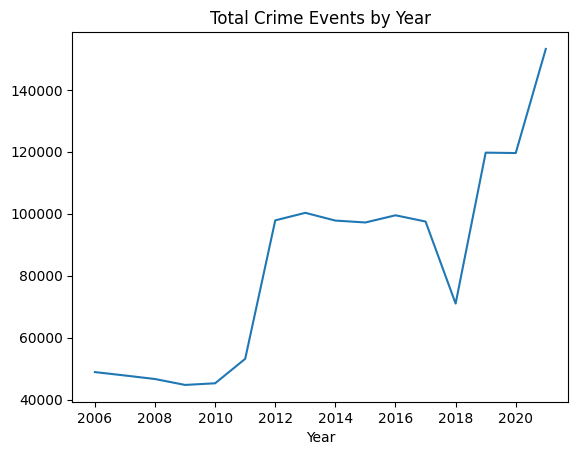

In [ ]:
# Extract the year from the date and count the occurrences of each year
year_counts = Treated_Data['RPT_DT'].str.findall(r'(\d{4})').apply(lambda x: x[0]).value_counts()

# Sort the value counts by index and create a line plot
year_counts_sorted = year_counts.sort_index()
ax = year_counts_sorted.plot(kind='line', title='Total Crime Events by Year')
ax.set_xlabel('Year')
plt.show()

The graph shows an interesting result, with the original dataset the line goes only down from 2006. The assumption is that the occurrence report interval is the reason behind the graph. Therefore we check this in the next step.

Text(0.5, 0, 'Year')

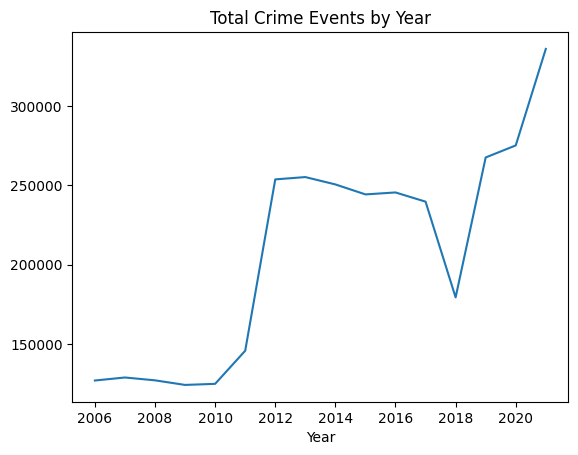

In [ ]:
Filtered_Data = Full_Data[Full_Data['Occurrence_Report_Interval'] == 0]

year_counts = Filtered_Data['RPT_DT'].str.findall(r'(\d{4})').apply(lambda x: x[0]).value_counts()


# Sort the value counts by index and create a line plot
year_counts_sorted = year_counts.sort_index()
ax = year_counts_sorted.plot(kind='line', title='Total Crime Events by Year')
ax.set_xlabel('Year')
plt.show()


We inded see that the occurrence report interval is the reason behind the increasing number of crime events in our dataset. 

In [ ]:
ce 

In [ ]:
c

#### 2.2.2 Distribution victims and suspects

The characteristics of the victims and suspects are being analysed by race, age and gender. We have to keep in mind that Race, Gender and Age age protected characteristics by the UK Equality ACT 2010. 

#### 2.2.2.1 Race

<Axes: >

Text(0.5, 1.0, 'Race of victims')

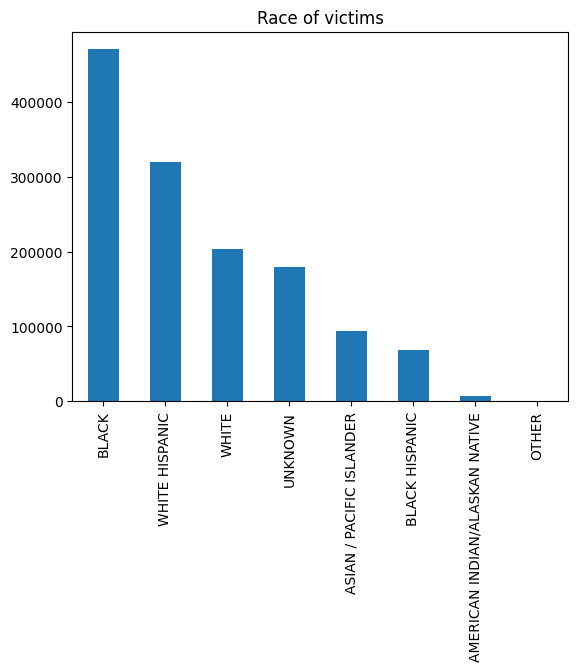

<Axes: >

Text(0.5, 1.0, 'Race of suspects')

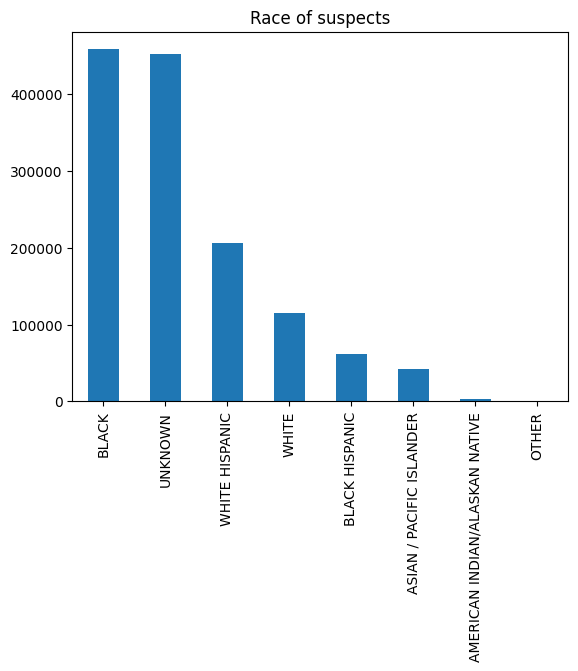

In [ ]:
# create a bar diagram to check the race categories for suspects
Treated_Data['VIC_RACE'].value_counts().plot(kind='bar')
plt.title("Race of victims")
plt.show()


# create a bar diagram to check the race categories for suspects
Treated_Data['SUSP_RACE'].value_counts().plot(kind='bar')
plt.title("Race of suspects")
plt.show()

#### 2.2.2.2 Gender

<Axes: >

Text(0.5, 1.0, 'Sex of victims')

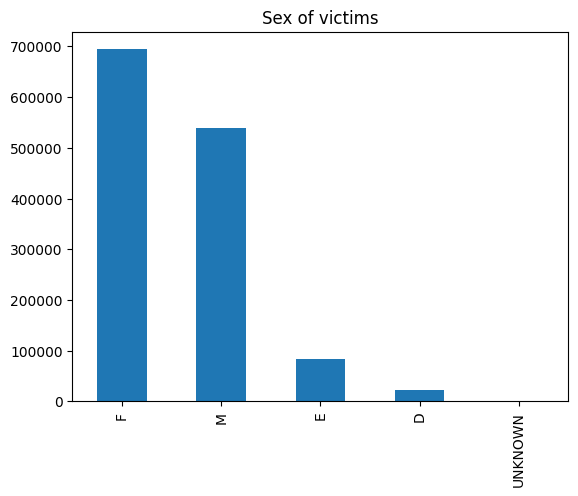

<Axes: >

Text(0.5, 1.0, 'Sex of suspects')

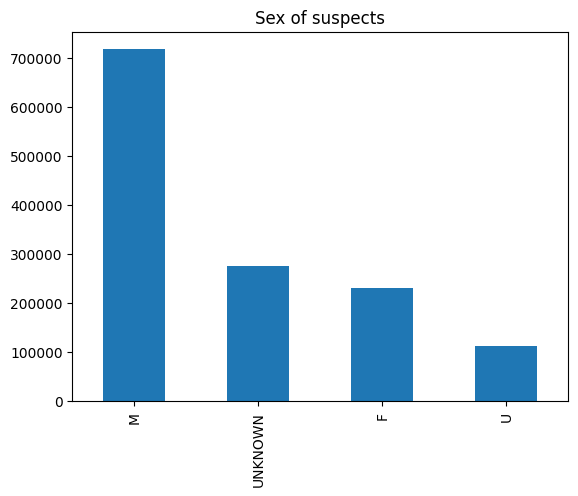

In [ ]:
# create a bar diagram to check the race categories for suspects
Treated_Data['VIC_SEX'].value_counts().plot(kind='bar')
plt.title("Sex of victims")
plt.show()


# create a bar diagram to check the race categories for suspects
Treated_Data['SUSP_SEX'].value_counts().plot(kind='bar')
plt.title("Sex of suspects")
plt.show()

#### 2.2.2.3 Age

<Axes: >

Text(0.5, 1.0, 'Age of victims')

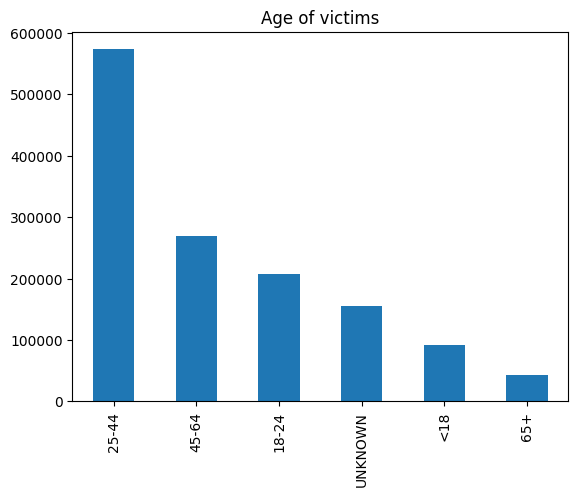

<Axes: >

Text(0.5, 1.0, 'Age of suspects')

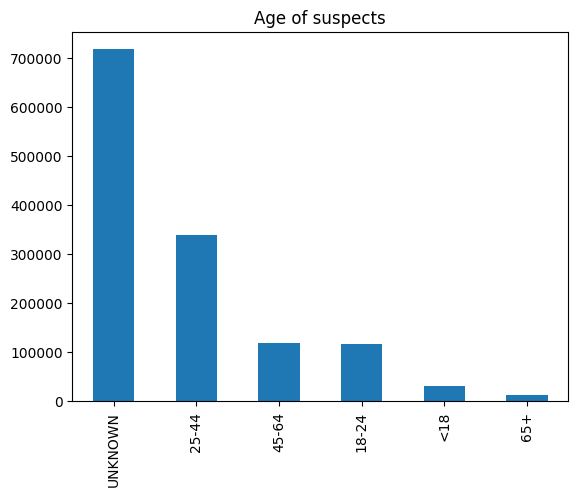

In [ ]:
# create a bar diagram to check the race categories for suspects
Treated_Data['VIC_AGE_GROUP'].value_counts().plot(kind='bar')
plt.title("Age of victims")
plt.show()


# create a bar diagram to check the race categories for suspects
Treated_Data['SUSP_AGE_GROUP'].value_counts().plot(kind='bar')
plt.title("Age of suspects")
plt.show()

###2.2.3 Distribution of types of crime

#### 2.2.3.1 KY_CD

<BarContainer object of 10 artists>

Text(0.5, 1.0, 'Top 10 categories of KY_CD')

Text(0.5, 0, 'Category')

Text(0, 0.5, 'Frequency')

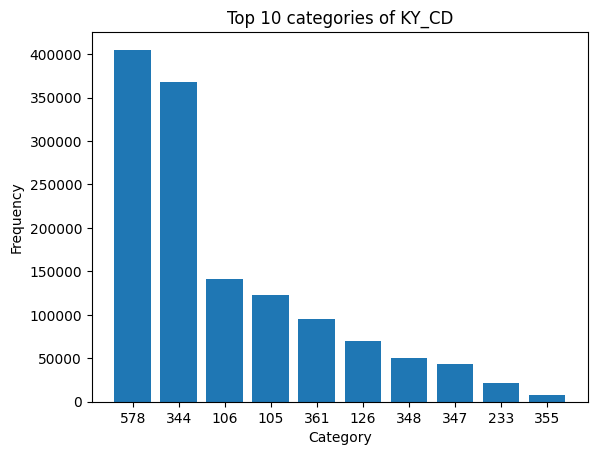

In [ ]:
# Count the number of occurrences of each category in KY_CD
category_counts = Treated_Data['KY_CD'].value_counts()

# Select the top 10 categories by frequency
top_10_categories = category_counts[:10]

# Create a bar plot of the top 10 categories
plt.bar(top_10_categories.index.astype(str), top_10_categories)
plt.title('Top 10 categories of KY_CD')
plt.xlabel('Category')
plt.ylabel('Frequency')
plt.show()

#### 2.2.3.2 LAW_CAT_CD

<Axes: >

Text(0.5, 1.0, 'Types of crimes')

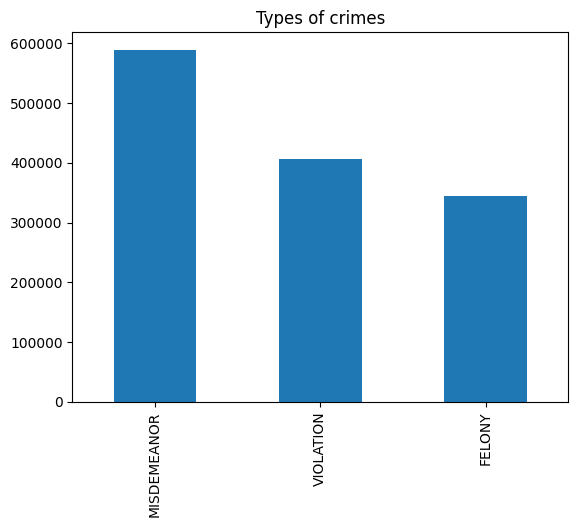

In [ ]:
# create a bar diagram to
Treated_Data['LAW_CAT_CD'].value_counts().plot(kind='bar')
plt.title("Types of crimes")
plt.show()

## 2.3 Geographical distributions

In terms of location 6 variables are important.


*   BORO_NM - The name of the borough in which the incident occurerred
*   LOC_OF_OCCUR_DECS - Specific location of occurence
*   PREM_TYP_DESC - Specific description of premises   
*   ADDR_PCT_CD - The precinct in which the incident occurererd
*   Latitude
*    Longitude

In [ ]:
# Import all required libraries
import pandas as pd

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

import matplotlib.pyplot as plt
%matplotlib inline

from scipy.stats import chi2_contingency

import seaborn as sns

import folium
from folium.plugins import HeatMap

### 2.3.1 BORO_NM, LOC_OF_OCCUR_DESC & PREM_TYPE_DESC

Text(0.5, 1.0, 'Specific location of occurence')

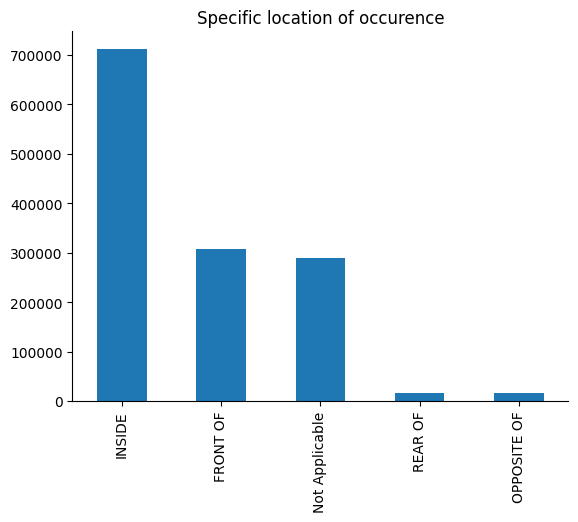

In [ ]:
# Create the bar plot
ax = Treated_Data['LOC_OF_OCCUR_DESC'].value_counts().plot(kind='bar')

# Customize the plot
ax.set_title("Specific location of occurence", fontsize=12)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Show the plot
plt.show()

For PREM_TYPE_DESC there are 74 different categories. Therefore only the categories that include more than 1.5% of the cases is presented in the following graph 

Number of unique values in 'PREM_TYP_DESC': 74


<Figure size 2000x600 with 0 Axes>

(array([0. , 0.2, 0.4, 0.6, 0.8, 1. ]),
 [Text(0.0, 0, '0.0'),
  Text(0.2, 0, '0.2'),
  Text(0.4, 0, '0.4'),
  Text(0.6000000000000001, 0, '0.6'),
  Text(0.8, 0, '0.8'),
  Text(1.0, 0, '1.0')])

<BarContainer object of 8 artists>

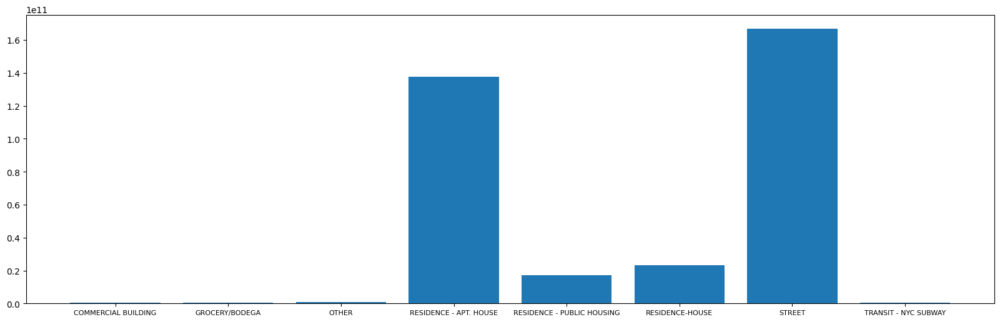

In [ ]:
# First check the number of unique categories
num_prem_types = Treated_Data['PREM_TYP_DESC'].nunique()
print("Number of unique values in 'PREM_TYP_DESC':", num_prem_types)

# there are too much to show in a bar plot, therefore only premises with more than 1.5% of total cases will be further explored

# calculate the count for all categories 
total_count = Treated_Data["PREM_TYP_DESC"].count()

# filter the dataset to only include categories above 2%
filtered = Treated_Data.groupby("PREM_TYP_DESC").filter(lambda x: len(x)/total_count > 0.015)

# add the total count to the filtered dataframe
filtered['total_count'] = filtered.groupby('PREM_TYP_DESC')['PREM_TYP_DESC'].transform('count')

grouped = filtered.groupby("PREM_TYP_DESC")['total_count'].sum()

# Change the size of the plot and of the text
plt.figure(figsize=(20, 6))
plt.xticks(fontsize=8)


plt.bar(grouped.index, grouped.values)

There are only 8 categories of the 74 that have more than 1.5% of the cases. With Street and Residence APT. House as clearly the biggest categories 

Now lets compare this to the total dataset to see if there is a difference.

Number of unique values in 'PREM_TYP_DESC': 74


<Figure size 2000x600 with 0 Axes>

(array([0. , 0.2, 0.4, 0.6, 0.8, 1. ]),
 [Text(0.0, 0, '0.0'),
  Text(0.2, 0, '0.2'),
  Text(0.4, 0, '0.4'),
  Text(0.6000000000000001, 0, '0.6'),
  Text(0.8, 0, '0.8'),
  Text(1.0, 0, '1.0')])

<BarContainer object of 4 artists>

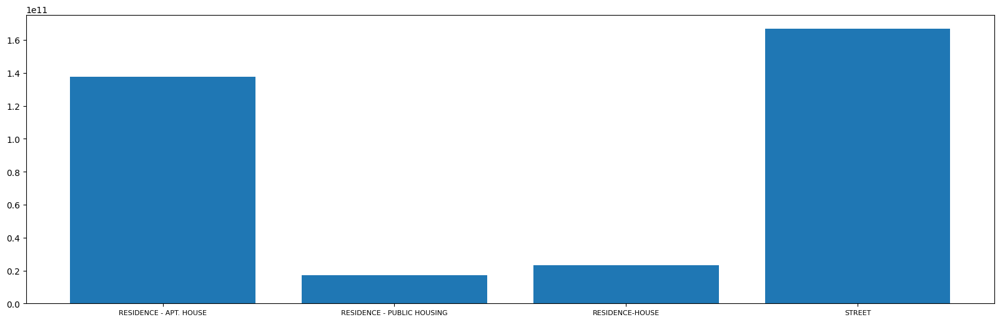

In [ ]:
# First check the number of unique categories
num_prem_types = Full_Data['PREM_TYP_DESC'].nunique()
print("Number of unique values in 'PREM_TYP_DESC':", num_prem_types)

# there are too much to show in a bar plot, therefore only premises with more than 1.5% of total cases will be further explored

# calculate the count for all categories 
total_count = Full_Data["PREM_TYP_DESC"].count()

# filter the dataset to only include categories above 2%
filtered = Treated_Data.groupby("PREM_TYP_DESC").filter(lambda x: len(x)/total_count > 0.015)

# add the total count to the filtered dataframe
filtered['total_count'] = filtered.groupby('PREM_TYP_DESC')['PREM_TYP_DESC'].transform('count')

grouped = filtered.groupby("PREM_TYP_DESC")['total_count'].sum()

# Change the size of the plot and of the text
plt.figure(figsize=(20, 6))
plt.xticks(fontsize=8)


plt.bar(grouped.index, grouped.values)



We see that in the total dataset the distribution is even  more focused with only 4 categories with more than 1.5% of the total cases

### 2.3.2 Geographical distribution

The second step is to explore the geograpical distribution of the cases based on their latitude and longitude

In [ ]:
# Get the center of the map based on the latitude and longitude data
center_lat = Treated_Data['Latitude'].mean()
center_long = Treated_Data['Longitude'].mean()

# Create a map object
m = folium.Map(location=[center_lat, center_long], zoom_start=10)

# In case of runtime errors, it is sometimes better to select a subset of the whole dataset
data_sample = Treated_Data

In [ ]:
# Group the data by latitude and longitude, and count the number of points in each group
data_grouped = data_sample.groupby(['Latitude', 'Longitude']).size().reset_index(name='count')

# Normalize the data
max_intensity = data_grouped['count'].max()
data_grouped['normalized_count'] = data_grouped['count'] / max_intensity

# Create a list of coordinates and intensity values from the latitude, longitude, and normalized count columns
coordinates = list(zip(data_grouped['Latitude'], data_grouped['Longitude'], data_grouped['normalized_count']))


In [ ]:
# Create a heatmap layer with normalized intensity values
heatmap = HeatMap(coordinates, min_opacity=0.2 , max_val=data_grouped['normalized_count'].max(), radius=8, blur=10)

# Add the heatmap layer to the map
heatmap.add_to(m)

# Display the map
m

<ipython-input-32-2368a11e9ed8>:2: UserWarning: The `max_val` parameter is no longer necessary. The largest intensity is calculated automatically.
  heatmap = HeatMap(coordinates, min_opacity=0.2 , max_val=data_grouped['normalized_count'].max(), radius=8, blur=10)


The map shows "hot spots" of EMS required crimes

Also, there seems to be incicents outside of New York. But, all of them are either on a horinzontal line or on a vertical line. This suggest that either the latitude or longitude is inserted incorrectly

Now, we compare it to the heatmap of all crimes to see if there are differences


In [ ]:
# create new dataset with only the rows where EMS = 0
Data_EMS_0 = Full_Data[Full_Data['EMS'] == 0]

Data_EMS_0.shape
# Get the center of the map based on the latitude and longitude data
center_lat = Treated_Data['Latitude'].mean()
center_long = Treated_Data['Longitude'].mean()

# Create a map object
m = folium.Map(location=[center_lat, center_long], zoom_start=10)

# In case of runtime errors, it is sometimes better to select a subset of the whole dataset
data_sample = Data_EMS_0

(6443374, 25)

In [ ]:
# Group the data by latitude and longitude, and count the number of points in each group
data_grouped = data_sample.groupby(['Latitude', 'Longitude']).size().reset_index(name='count')

# Normalize the data
max_intensity = data_grouped['count'].max()
data_grouped['normalized_count'] = data_grouped['count'] / max_intensity

# Create a list of coordinates and intensity values from the latitude, longitude, and normalized count columns
coordinates = list(zip(data_grouped['Latitude'], data_grouped['Longitude'], data_grouped['normalized_count']))


In [ ]:
# Create a heatmap layer with normalized intensity values
heatmap = HeatMap(coordinates, min_opacity=0.2 , max_val=data_grouped['normalized_count'].max(), radius=8, blur=10)

# Add the heatmap layer to the map
heatmap.add_to(m)

# Display the map
m

<ipython-input-35-2368a11e9ed8>:2: UserWarning: The `max_val` parameter is no longer necessary. The largest intensity is calculated automatically.
  heatmap = HeatMap(coordinates, min_opacity=0.2 , max_val=data_grouped['normalized_count'].max(), radius=8, blur=10)


# 3 Diagnostic Analysis 

The goal of this diagnostic analysis it to determine the causes of trends and correlations between variables. The structure is the following:

1.   Visualizations of relationships
2.   Testing correlations between variables
3.   Testing correlations with target variable 



In [4]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

In [5]:
# Import the dataset with only EMS
Treated_Data = pd.read_csv(r'/content/drive/My Drive/Colab Notebooks/SEN163B/Treated_Data.csv')

In [6]:
# Import the full dataset
Data_Full = pd.read_csv(r'/content/drive/My Drive/Colab Notebooks/SEN163B/Treated_Full_Data.csv')

<ipython-input-6-b3492c0647f0>:2: DtypeWarning: Columns (23) have mixed types. Specify dtype option on import or set low_memory=False.
  Data_Full = pd.read_csv(r'/content/drive/My Drive/Colab Notebooks/SEN163B/Treated_Full_Data.csv')


## 3.1 Visualizations 

The following variables are being visualized
1.   Characteristics of Suspects and Victims
2.   Location variables

### 3.1.1 Characteristics of Suspects and Victims

In [7]:
# Calculate the crosstab of VIC_RACE and VIC_AGE_GROUP
df = pd.crosstab(Treated_Data['VIC_AGE_GROUP'], Treated_Data['VIC_RACE'])

# Display the table
df

VIC_RACE,AMERICAN INDIAN/ALASKAN NATIVE,ASIAN / PACIFIC ISLANDER,BLACK,BLACK HISPANIC,OTHER,UNKNOWN,WHITE,WHITE HISPANIC
VIC_AGE_GROUP,,,,,,,,
18-24,1027,13694,84203,13636,1,6665,25697,62395
25-44,3486,45791,219865,32718,2,19407,93680,158410
45-64,1738,23733,105735,12710,1,9234,57388,58158
65+,222,3599,14203,1662,0,1303,13391,8213
<18,402,5368,39068,6919,1,3070,9375,27999
UNKNOWN,101,1248,6815,872,0,139669,3349,3886


In [8]:
# Calculate the percentage of each SUSP_RACE category for each SUSP_AGE_GROUP
df = pd.crosstab(Treated_Data['SUSP_AGE_GROUP'], Treated_Data['SUSP_RACE'])

# Display the table
df

SUSP_RACE,AMERICAN INDIAN/ALASKAN NATIVE,ASIAN / PACIFIC ISLANDER,BLACK,BLACK HISPANIC,OTHER,UNKNOWN,WHITE,WHITE HISPANIC
SUSP_AGE_GROUP,,,,,,,,
18-24,383,4503,59572,9722,0,5222,8443,30081
25-44,1292,16921,160924,24114,1,14753,38816,83426
45-64,580,8259,52029,6132,0,5390,23728,22777
65+,71,1044,4031,508,0,612,4046,2129
<18,77,933,17676,2537,0,1848,2078,7189
UNKNOWN,1096,10982,164196,19016,1,424214,38499,60258


Comparing both the suspects and the victims some things stand out. First, the unknown group is much larger for the suspects. This is understable because the suspect is not always caugh or seen. Second, range distribution of age is broader among the victims. Finally, for both the victims and the suspects, the black category is over present compared to the population of New York. 

This is caused by historical bias, because is reinforces stereotypes without looking deeper into the reasons for this over  representation
Another reason could be measurement bias, because the police in New York openly said that "unfair and racist policicing have been going on for centuries in our county", and therefore it is possible that suspects are more often described as black. https://www.ny1.com/nyc/manhattan/public-safety/2021/02/24/commissioner-shea-apologizes-for-systemic-racism-in-the-nypd

<Axes: xlabel='VIC_RACE', ylabel='VIC_AGE_GROUP'>

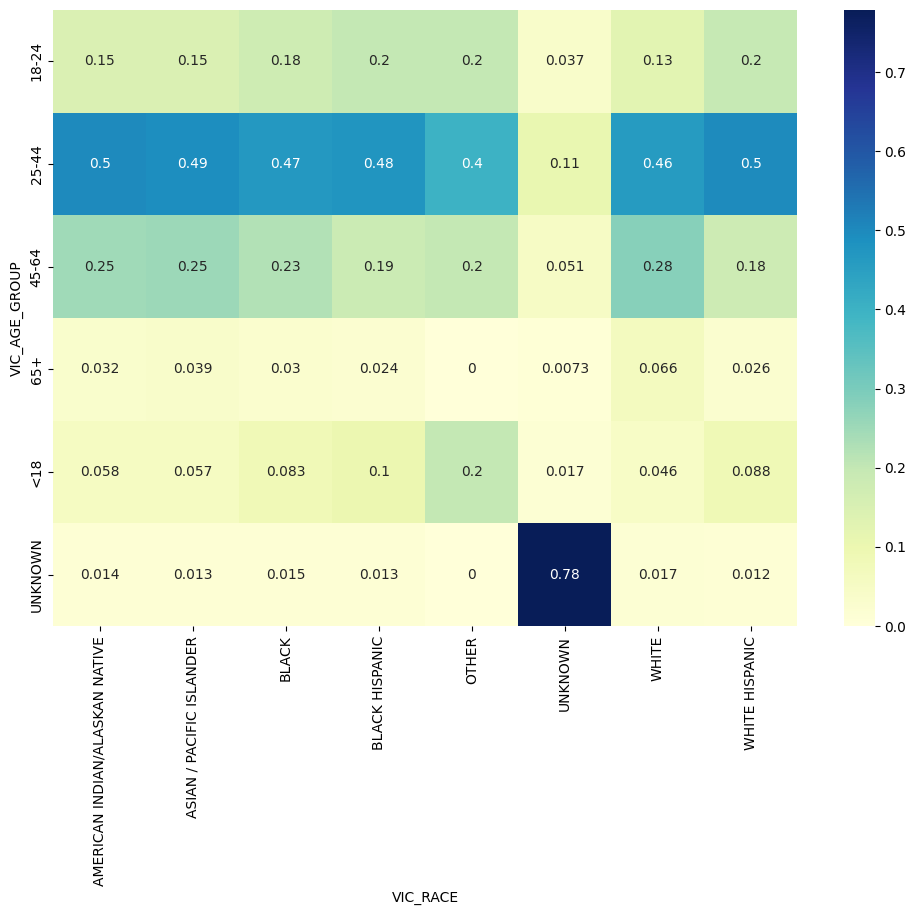

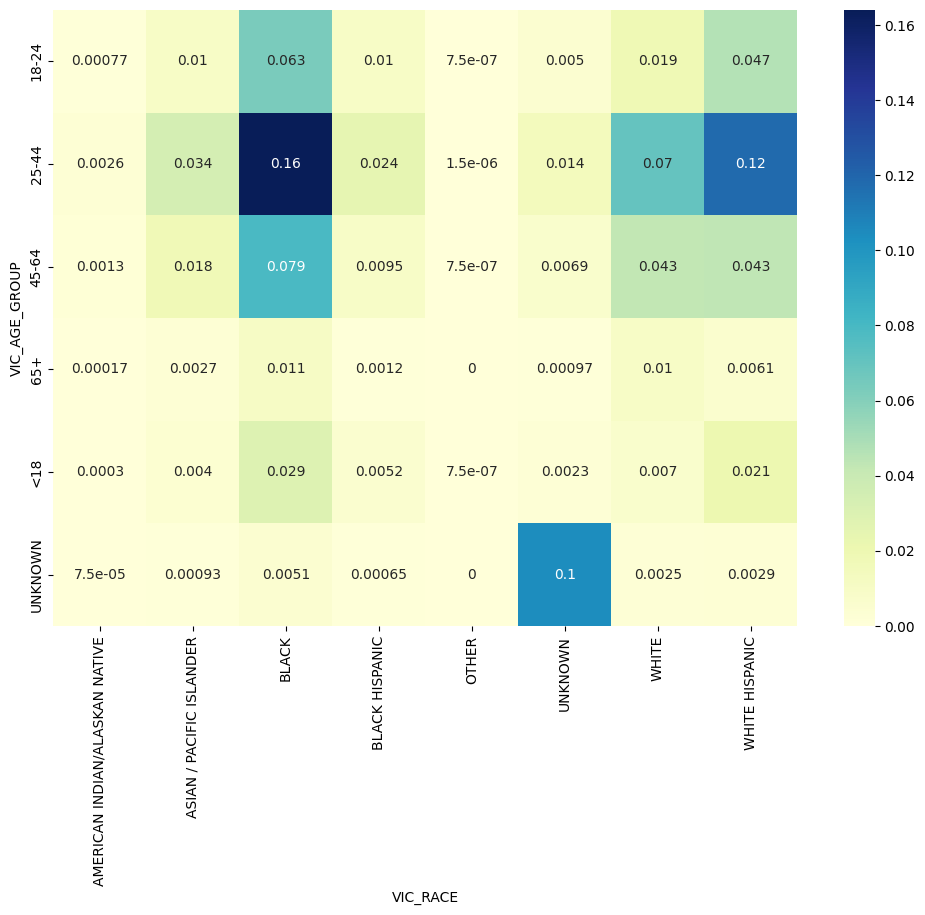

In [10]:
# Note the naming is not corresponding to the groups (because of copy pasting)
# Calculate the crosstab 
Count_LAW_CAT_CD__BORO_NM = pd.crosstab(Treated_Data['VIC_AGE_GROUP'], Treated_Data['VIC_RACE'], margins=True, margins_name="Total")
Count_LAW_CAT_CD__BORO_NM_NoTot = pd.crosstab(Treated_Data['VIC_AGE_GROUP'], Treated_Data['VIC_RACE'])

# Calculate the sum of each column
col_sum = Count_LAW_CAT_CD__BORO_NM.sum()

# Calculate the percentage of each LAW_CAT_CD category across all BORO_NM categories
Percent_LAW_CAT_CD__BORO_NM_Col = pd.crosstab(Treated_Data['VIC_AGE_GROUP'], Treated_Data['VIC_RACE'], normalize='columns', margins = True)
Percent_LAW_CAT_CD__BORO_NM_Col_NoTot = pd.crosstab(Treated_Data['VIC_AGE_GROUP'], Treated_Data['VIC_RACE'], normalize='columns')
Percent_LAW_CAT_CD__BORO_NM_Overall = pd.crosstab(Treated_Data['VIC_AGE_GROUP'], Treated_Data['VIC_RACE'], normalize='all', margins = True)
Percent_LAW_CAT_CD__BORO_NM_Overall_NoTot = pd.crosstab(Treated_Data['VIC_AGE_GROUP'], Treated_Data['VIC_RACE'], normalize='all')

# Visualize the data with a heat map
plt.figure(figsize=(12,8))
Plot_LAW_CAT_CD__BORO_NM_Col_NoTot = sns.heatmap(Percent_LAW_CAT_CD__BORO_NM_Col_NoTot, annot=True, cmap="YlGnBu")
plt.figure(figsize=(12,8))
Plot_LAW_CAT_CD__BORO_NM_Overall_NoTot = sns.heatmap(Percent_LAW_CAT_CD__BORO_NM_Overall_NoTot, annot=True, cmap="YlGnBu")


Count_LAW_CAT_CD__BORO_NM 
Percent_LAW_CAT_CD__BORO_NM_Col
Percent_LAW_CAT_CD__BORO_NM_Overall
Plot_LAW_CAT_CD__BORO_NM_Overall_NoTot
Plot_LAW_CAT_CD__BORO_NM_Col_NoTot

<Axes: xlabel='SUSP_RACE', ylabel='SUSP_AGE_GROUP'>

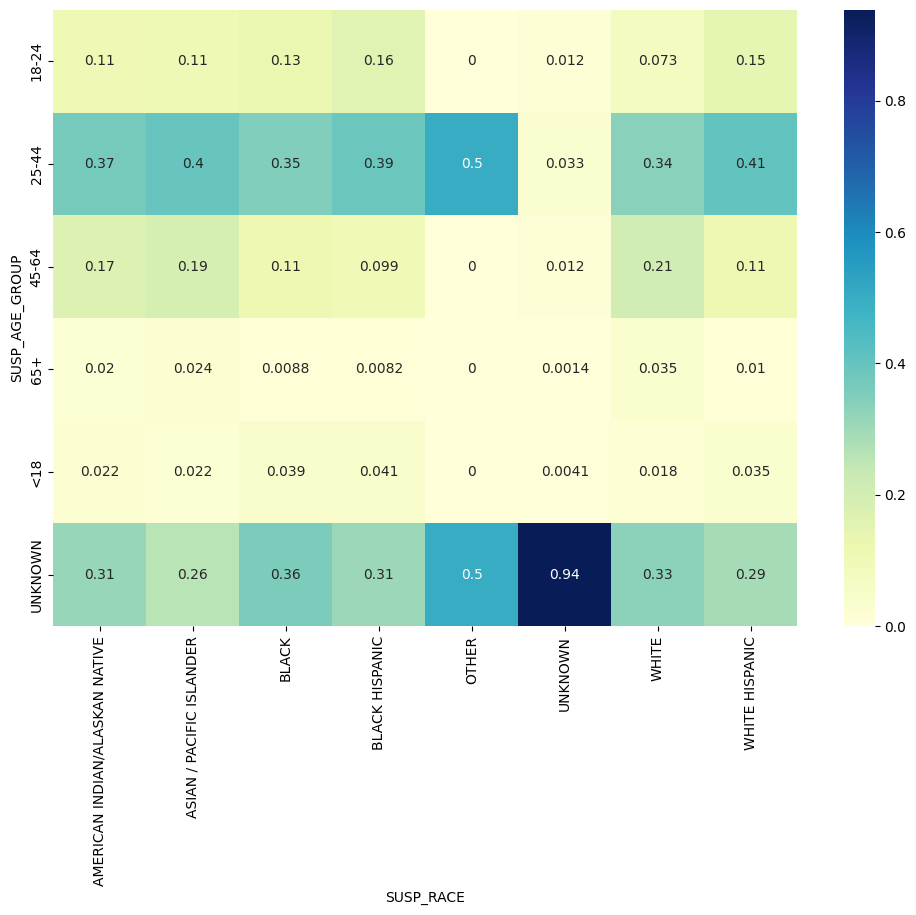

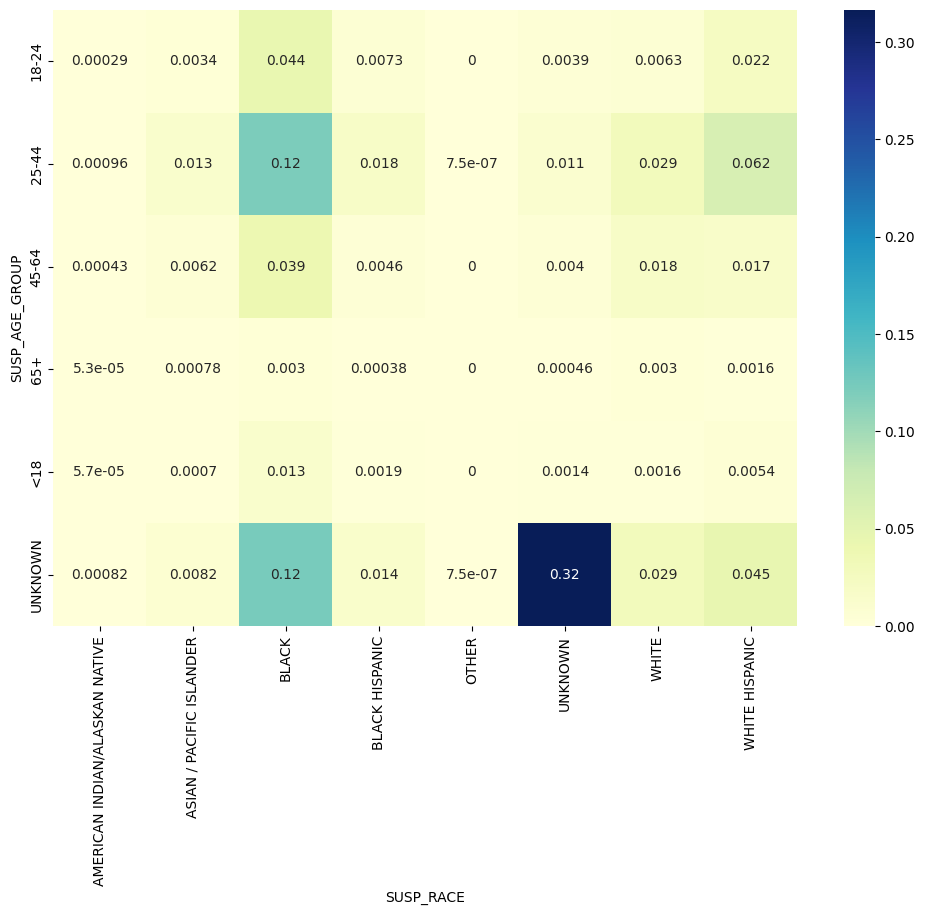

In [12]:
# Note the naming is not corresponding to the groups (because of copy pasting)
# Calculate the crosstab 
Count_LAW_CAT_CD__BORO_NM = pd.crosstab(Treated_Data['SUSP_AGE_GROUP'], Treated_Data['SUSP_RACE'], margins=True, margins_name="Total")
Count_LAW_CAT_CD__BORO_NM_NoTot = pd.crosstab(Treated_Data['SUSP_AGE_GROUP'], Treated_Data['SUSP_RACE'])

# Calculate the sum of each column
col_sum = Count_LAW_CAT_CD__BORO_NM.sum()

# Calculate the percentage of each LAW_CAT_CD category across all BORO_NM categories
Percent_LAW_CAT_CD__BORO_NM_Col = pd.crosstab(Treated_Data['SUSP_AGE_GROUP'], Treated_Data['SUSP_RACE'], normalize='columns', margins = True)
Percent_LAW_CAT_CD__BORO_NM_Col_NoTot = pd.crosstab(Treated_Data['SUSP_AGE_GROUP'], Treated_Data['SUSP_RACE'], normalize='columns')
Percent_LAW_CAT_CD__BORO_NM_Overall = pd.crosstab(Treated_Data['SUSP_AGE_GROUP'], Treated_Data['SUSP_RACE'], normalize='all', margins = True)
Percent_LAW_CAT_CD__BORO_NM_Overall_NoTot = pd.crosstab(Treated_Data['SUSP_AGE_GROUP'], Treated_Data['SUSP_RACE'], normalize='all')

# Visualize the data with a heat map
plt.figure(figsize=(12,8))
Plot_LAW_CAT_CD__BORO_NM_Col_NoTot = sns.heatmap(Percent_LAW_CAT_CD__BORO_NM_Col_NoTot, annot=True, cmap="YlGnBu")
plt.figure(figsize=(12,8))
Plot_LAW_CAT_CD__BORO_NM_Overall_NoTot = sns.heatmap(Percent_LAW_CAT_CD__BORO_NM_Overall_NoTot, annot=True, cmap="YlGnBu")


Count_LAW_CAT_CD__BORO_NM 
Percent_LAW_CAT_CD__BORO_NM_Col
Percent_LAW_CAT_CD__BORO_NM_Overall
Plot_LAW_CAT_CD__BORO_NM_Overall_NoTot
Plot_LAW_CAT_CD__BORO_NM_Col_NoTot

In [13]:
# Calculate the crosstab of VIC_RACE and VIC_SEX
df = pd.crosstab(Treated_Data['VIC_RACE'], Treated_Data['VIC_SEX'])


df

VIC_SEX,D,E,F,M,UNKNOWN
VIC_RACE,,,,,
AMERICAN INDIAN/ALASKAN NATIVE,6,2,2464,4504,0
ASIAN / PACIFIC ISLANDER,86,34,38419,54894,0
BLACK,104,233,290931,178621,0
BLACK HISPANIC,16,41,37049,31411,0
OTHER,0,0,1,4,0
UNKNOWN,22398,82700,39226,34998,26
WHITE,80,187,103308,99305,0
WHITE HISPANIC,68,169,182664,136160,0


In [14]:
# Calculate the crosstab of VIC_RACE and VIC_SEX
df = pd.crosstab(Treated_Data['SUSP_RACE'], Treated_Data['SUSP_SEX'])


df

SUSP_SEX,F,M,U,UNKNOWN
SUSP_RACE,,,,
AMERICAN INDIAN/ALASKAN NATIVE,619,2791,80,9
ASIAN / PACIFIC ISLANDER,8015,33629,919,79
BLACK,111580,331269,14181,1398
BLACK HISPANIC,13471,46688,1700,170
OTHER,0,2,0,0
UNKNOWN,22276,67662,88791,273310
WHITE,26895,85651,2664,400
WHITE HISPANIC,49600,150701,5088,471


### 3.1.2 Correlation EMS and location variables  

We compare the correlation of the four following variables with EMS required yes/no


*   BORO_NM
*   ADDR_PCT_CD
*   LOC_OF_OCCUR_DESC
*   PREM_TYP_DESC



#### 3.1.2.1 BORO_NM

In [ ]:
# Create a pivot table to calculate the average of EMS for the categories
pivot_table = pd.pivot_table(Data_Full, values='EMS', aggfunc='mean', columns=['BORO_NM'])

Average_EMS = Data_Full["EMS"].mean()
print(Average_EMS)

# Style the pivot table
styled_table = pivot_table.style\
    .background_gradient(cmap='coolwarm', axis=None)\
    .set_precision(2)

# Display the styled table
display(styled_table)



0.1721734344380273


<ipython-input-22-fb2a055c35e8>:8: FutureWarning: this method is deprecated in favour of `Styler.format(precision=..)`
  styled_table = pivot_table.style\


BORO_NM,BRONX,BROOKLYN,MANHATTAN,QUEENS,STATEN ISLAND
EMS,0.18,0.18,0.14,0.18,0.18


The differences between most borough is negligible. The only borough that stands out is Manhatten where less EMS is required than the others (+- 4% less)

#### 3.1.2.2 ADDR_PCT_CD

In [ ]:
# Create a pivot table to calculate the average of EMS for the categories
pivot_table = pd.pivot_table(Data_Full, values='EMS', aggfunc='mean', columns=['ADDR_PCT_CD'])

Average_EMS = Data_Full["EMS"].mean()
print(Average_EMS)

# Style the pivot table
styled_table = pivot_table.style\
    .background_gradient(cmap='coolwarm', axis=None)\
    .set_precision(2)

# Display the styled table
display(styled_table)



0.1721734344380273


<ipython-input-23-d162cadbacda>:8: FutureWarning: this method is deprecated in favour of `Styler.format(precision=..)`
  styled_table = pivot_table.style\


ADDR_PCT_CD,1.000000,5.000000,6.000000,7.000000,9.000000,10.000000,13.000000,14.000000,17.000000,18.000000,19.000000,20.000000,22.000000,23.000000,24.000000,25.000000,26.000000,28.000000,30.000000,32.000000,33.000000,34.000000,40.000000,41.000000,42.000000,43.000000,44.000000,45.000000,46.000000,47.000000,48.000000,49.000000,50.000000,52.000000,60.000000,61.000000,62.000000,63.000000,66.000000,67.000000,68.000000,69.000000,70.000000,71.000000,72.000000,73.000000,75.000000,76.000000,77.000000,78.000000,79.000000,81.000000,83.000000,84.000000,88.000000,90.000000,94.000000,100.000000,101.000000,102.000000,103.000000,104.000000,105.000000,106.000000,107.000000,108.000000,109.000000,110.000000,111.000000,112.000000,113.000000,114.000000,115.000000,120.000000,121.000000,122.000000,123.000000
EMS,0.11,0.14,0.12,0.16,0.13,0.14,0.13,0.10,0.13,0.13,0.12,0.12,0.14,0.18,0.14,0.17,0.16,0.16,0.18,0.19,0.17,0.18,0.18,0.18,0.20,0.18,0.17,0.17,0.19,0.20,0.19,0.18,0.15,0.17,0.17,0.16,0.17,0.16,0.17,0.21,0.16,0.20,0.18,0.18,0.18,0.20,0.19,0.15,0.18,0.15,0.20,0.19,0.19,0.15,0.16,0.17,0.15,0.20,0.22,0.19,0.19,0.16,0.19,0.19,0.16,0.17,0.16,0.17,0.14,0.13,0.19,0.18,0.19,0.18,0.25,0.16,0.15



The differences between the differenct precints are bigger than for the boroughs. Precint 42, 47, 67, 69, 73, 79, 100, 101 and especially 121 are >= 20%

#### 3.1.2.3 LOC_OF_OCCUR_DESC

In [ ]:
# Create a pivot table to calculate the average of EMS for the categories
pivot_table = pd.pivot_table(Data_Full, values='EMS', aggfunc='mean', columns=['LOC_OF_OCCUR_DESC'])

Average_EMS = Data_Full["EMS"].mean()
print(Average_EMS)

# Style the pivot table
styled_table = pivot_table.style\
    .background_gradient(cmap='coolwarm', axis=None)\
    .set_precision(2)

# Display the styled table
display(styled_table)

0.1721734344380273


<ipython-input-24-23ab65d48a61>:8: FutureWarning: this method is deprecated in favour of `Styler.format(precision=..)`
  styled_table = pivot_table.style\


LOC_OF_OCCUR_DESC,FRONT OF,INSIDE,Not Applicable,OPPOSITE OF,REAR OF
EMS,0.17,0.18,0.18,0.08,0.11


The differences between the specific location also show interesting signes. Insinde, NA and Front of show more EMS than Opposite of and Rear of. However, Opposite of and Rear of are also the smallest categories, so that could also be the reason. 

#### 3.1.2.4 PREM_TYP_DESC

In [ ]:
# Create a pivot table to calculate the average of EMS for the categories
pivot_table = pd.pivot_table(Data_Full, values='EMS', aggfunc='mean', columns=['PREM_TYP_DESC'])

Average_EMS = Data_Full["EMS"].mean()
print(Average_EMS)

# Style the pivot table
styled_table = pivot_table.style\
    .background_gradient(cmap='coolwarm', axis=None)\
    .set_precision(2)

# Display the styled table
display(styled_table)


0.1721734344380273


<ipython-input-25-2fa6a5ab8453>:8: FutureWarning: this method is deprecated in favour of `Styler.format(precision=..)`
  styled_table = pivot_table.style\


PREM_TYP_DESC,ABANDONED BUILDING,AIRPORT TERMINAL,ATM,BANK,BAR/NIGHT CLUB,BEAUTY & NAIL SALON,BOOK/CARD,BRIDGE,BUS (NYC TRANSIT),BUS (OTHER),BUS STOP,BUS TERMINAL,CANDY STORE,CEMETERY,CHAIN STORE,CHECK CASHING BUSINESS,CHURCH,CLOTHING/BOUTIQUE,COMMERCIAL BUILDING,CONSTRUCTION SITE,DAYCARE FACILITY,DEPARTMENT STORE,DOCTOR/DENTIST OFFICE,DRUG STORE,DRY CLEANER/LAUNDRY,FACTORY/WAREHOUSE,FAST FOOD,FERRY/FERRY TERMINAL,FOOD SUPERMARKET,GAS STATION,GROCERY/BODEGA,GYM/FITNESS FACILITY,HIGHWAY/PARKWAY,HOMELESS SHELTER,HOSPITAL,HOTEL/MOTEL,JEWELRY,LIQUOR STORE,LOAN COMPANY,MAILBOX INSIDE,MAILBOX OUTSIDE,MARINA/PIER,MOSQUE,OPEN AREAS (OPEN LOTS),OTHER,OTHER HOUSE OF WORSHIP,PARK/PLAYGROUND,PARKING LOT/GARAGE (PRIVATE),PARKING LOT/GARAGE (PUBLIC),PHOTO/COPY,PRIVATE/PAROCHIAL SCHOOL,PUBLIC BUILDING,PUBLIC SCHOOL,RESIDENCE - APT. HOUSE,RESIDENCE - PUBLIC HOUSING,RESIDENCE-HOUSE,RESTAURANT/DINER,SHOE,SMALL MERCHANT,SOCIAL CLUB/POLICY,STORAGE FACILITY,STORE UNCLASSIFIED,STREET,SYNAGOGUE,TAXI (LIVERY LICENSED),TAXI (YELLOW LICENSED),TAXI/LIVERY (UNLICENSED),TELECOMM. STORE,TRAMWAY,TRANSIT - NYC SUBWAY,TRANSIT FACILITY (OTHER),TUNNEL,VARIETY STORE,VIDEO STORE
EMS,0.06,0.14,0.04,0.11,0.17,0.18,0.07,0.23,0.25,0.19,0.20,0.14,0.19,0.10,0.07,0.10,0.10,0.05,0.11,0.06,0.18,0.03,0.16,0.06,0.17,0.11,0.18,0.23,0.09,0.16,0.21,0.06,0.27,0.39,0.20,0.19,0.09,0.15,0.10,0.01,0.00,0.12,0.15,0.11,0.15,0.15,0.16,0.07,0.10,0.09,0.12,0.14,0.15,0.21,0.21,0.19,0.14,0.07,0.11,0.19,0.09,0.11,0.17,0.12,0.18,0.12,0.21,0.10,0.09,0.15,0.10,0.17,0.11,0.11


Finally we looked at the differences between the specific description of the premises and the differences here are also the largest. 

For example it is clearly that in the category 'Homeless Shelter' has the most EMS required crimes

## 3.2 Variable Correlations

The following variables are being tested on relationship:
1. Level of offene and Borough
2. Race and Borough
3. Victim characteristics 

Because almost all variables in the dataset are categorical variables, the statistical tests to that can be done to check a relationship between two variables is chi square test

NOTE: with a dataset this big, the chances of finding statistical differences are big 


In [ ]:
from scipy.stats import chi2_contingency

### 3.2.1 Level of Offence and Borough 

In [ ]:
# Chi-square test of independence.

# H₀: The two categorical variables have no relationship (They are independent)
# H₁: There is a relationship between two categorical variables (They are correlated)

# α = 5%

alpha=0.05

c, p, dof, expected = chi2_contingency(Count_LAW_CAT_CD__BORO_NM_NoTot)

print(p)

if p<alpha:
  print("There is significant statistical evidence to reject the null hypothesis.")
else:
  print("Failed to reject the null hypothesis.")

0.0
There is significant statistical evidence to reject the null hypothesis.


### 3.2.2 Race and Borough

In [ ]:
# Note: with a dataset this big, the chances of finding statistical differences are big 

# Chi-square test of independence.

# H₀: The two categorical variables have no relationship (They are independent)
# H₁: There is a relationship between two categorical variables (They are correlated)

# α = 5%

# Test for SUSP RACE against borough

contingency_table = pd.crosstab(Treated_Data['SUSP_RACE'], Treated_Data['BORO_NM'])
stat, p, dof, expected = chi2_contingency(contingency_table)

print("Test SUSP Race and Borough")
print(p)

if p<alpha:
  print("There is significant statistical evidence to reject the null hypothesis.")
else:
  print("Failed to reject the null hypothesis.")


contingency_table = pd.crosstab(Treated_Data['VIC_RACE'], Treated_Data['BORO_NM'])
stat, p, dof, expected = chi2_contingency(contingency_table)

print("Test VIC Race and Borough")
print(p)

if p<alpha:
  print("There is significant statistical evidence to reject the null hypothesis.")
else:
  print("Failed to reject the null hypothesis.")

Test SUSP Race and Borough
0.0
There is significant statistical evidence to reject the null hypothesis.
Test VIC Race and Borough
0.0
There is significant statistical evidence to reject the null hypothesis.


### 3.2.3 Victim characteristics

In [ ]:
contingency_table = pd.crosstab(Treated_Data['VIC_RACE'], Treated_Data['SUSP_RACE'])
stat, p, dof, expected = chi2_contingency(contingency_table)

print("Test VIC Race and SUSP Race")
print(p)

if p<alpha:
  print("There is significant statistical evidence to reject the null hypothesis.")
else:
  print("Failed to reject the null hypothesis.")

contingency_table = pd.crosstab(Treated_Data['VIC_AGE_GROUP'], Treated_Data['SUSP_AGE_GROUP'])
stat, p, dof, expected = chi2_contingency(contingency_table)

print("Test VIC Age and SUSP Age")
print(p)

if p<alpha:
  print("There is significant statistical evidence to reject the null hypothesis.")
else:
  print("Failed to reject the null hypothesis.")



contingency_table = pd.crosstab(Treated_Data['VIC_SEX'], Treated_Data['SUSP_SEX'])
stat, p, dof, expected = chi2_contingency(contingency_table)

print("Test VIC Sex and SUSP Sex")
print(p)

if p<alpha:
  print("There is significant statistical evidence to reject the null hypothesis.")
else:
  print("Failed to reject the null hypothesis.")


Test VIC Race and SUSP Race
0.0
There is significant statistical evidence to reject the null hypothesis.
Test VIC Age and SUSP Age
0.0
There is significant statistical evidence to reject the null hypothesis.
Test VIC Sex and SUSP Sex
0.0
There is significant statistical evidence to reject the null hypothesis.


## 3.3 Regression

A logistic regression model is trained on the whole datset to check whether there is a relationship between the binary variable EMS and the other variables. 

For this logistic regression the following tutorial has been used: https://www.kaggle.com/code/prashant111/logistic-regression-classifier-tutorial & the code from the lecture

In [ ]:
# Import libraries 
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt # data visualization
import seaborn as sns # statistical data visualization
%matplotlib inline

In [ ]:
Data_Full.head(10)

,ID,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,ADDR_PCT_CD,RPT_DT,KY_CD,PD_CD,LAW_CAT_CD,...,SUSP_RACE,SUSP_SEX,Latitude,Longitude,PATROL_BORO,VIC_AGE_GROUP,VIC_RACE,VIC_SEX,Occurrence_Report_Interval,EMS
0,0,2018-03-29 00:00:00,1900-01-01 20:30:00,2018-03-29 00:00:00,1900-01-01 20:30:00,32.0,2018-03-30,351,254.0,MISDEMEANOR,...,UNKNOWN,UNKNOWN,40.810877,-73.941064,PATROL BORO MAN NORTH,25-44,WHITE,F,1,0.0
1,1,2018-02-06 00:00:00,1900-01-01 23:15:00,2018-02-06 00:00:00,1900-01-01 23:15:00,52.0,2018-02-07,341,333.0,MISDEMEANOR,...,BLACK,F,40.873671,-73.908014,PATROL BORO BRONX,UNKNOWN,UNKNOWN,D,1,0.0
2,2,2018-11-21 00:00:00,1900-01-01 00:15:00,2018-11-21 00:00:00,1900-01-01 00:20:00,75.0,2018-11-21,341,321.0,MISDEMEANOR,...,WHITE HISPANIC,F,40.651782,-73.885457,PATROL BORO BKLYN NORTH,UNKNOWN,UNKNOWN,D,0,0.0
3,3,2018-06-09 00:00:00,1900-01-01 21:42:00,2018-06-09 00:00:00,1900-01-01 21:43:00,10.0,2018-06-10,361,639.0,MISDEMEANOR,...,WHITE HISPANIC,M,40.759310,-73.994706,PATROL BORO MAN SOUTH,18-24,WHITE HISPANIC,F,1,0.0
4,4,2018-11-10 00:00:00,1900-01-01 19:40:00,2018-11-10 00:00:00,1900-01-01 19:45:00,19.0,2018-11-10,341,333.0,MISDEMEANOR,...,BLACK HISPANIC,F,40.764536,-73.970728,PATROL BORO MAN NORTH,UNKNOWN,UNKNOWN,D,0,0.0
5,5,2018-03-12 00:00:00,1900-01-01 11:48:00,2018-03-12 00:00:00,1900-01-01 11:48:00,25.0,2018-03-12,113,729.0,FELONY,...,UNKNOWN,UNKNOWN,40.804384,-73.937422,PATROL BORO MAN NORTH,UNKNOWN,UNKNOWN,E,0,0.0
6,6,2013-04-07 00:00:00,1900-01-01 16:00:00,2013-04-07 00:00:00,1900-01-01 16:00:00,103.0,2013-04-07,118,793.0,FELONY,...,UNKNOWN,UNKNOWN,40.703555,-73.799677,PATROL BORO QUEENS SOUTH,UNKNOWN,UNKNOWN,E,0,0.0
7,7,2018-09-12 00:00:00,1900-01-01 18:30:00,2018-09-12 00:00:00,1900-01-01 18:35:00,46.0,2018-09-12,121,269.0,FELONY,...,BLACK,M,40.853653,-73.906892,PATROL BORO BRONX,UNKNOWN,UNKNOWN,D,0,0.0
8,8,2018-01-16 00:00:00,1900-01-01 14:30:00,2018-01-16 00:00:00,1900-01-01 15:00:00,69.0,2018-01-16,344,101.0,MISDEMEANOR,...,BLACK,U,40.635516,-73.913278,PATROL BORO BKLYN SOUTH,<18,BLACK,M,0,1.0
9,9,2018-08-04 00:00:00,1900-01-01 22:15:00,2018-08-04 00:00:00,1900-01-01 22:15:00,44.0,2018-08-04,344,101.0,MISDEMEANOR,...,WHITE HISPANIC,M,40.826170,-73.916831,PATROL BORO BRONX,25-44,WHITE HISPANIC,F,0,1.0


Drop all the features not relevant for the logistic regression model: all the different variables regarding the data

In [ ]:
Data = Data_Full.drop(['ID','CMPLNT_FR_DT','CMPLNT_FR_TM','CMPLNT_TO_DT','CMPLNT_TO_TM','RPT_DT','Occurrence_Report_Interval'], axis=1)

In [ ]:
# Variable Types
print(Data.dtypes)

ADDR_PCT_CD          float64
KY_CD                  int64
PD_CD                float64
LAW_CAT_CD            object
BORO_NM               object
LOC_OF_OCCUR_DESC     object
PREM_TYP_DESC         object
JURISDICTION_CODE    float64
SUSP_AGE_GROUP        object
SUSP_RACE             object
SUSP_SEX              object
Latitude             float64
Longitude            float64
PATROL_BORO           object
VIC_AGE_GROUP         object
VIC_RACE              object
VIC_SEX               object
EMS                  float64
dtype: object


Another step is to randomly cut the dataset in six otherwhise the program kept crashing

In [ ]:
num_rows = len(Data) // 6
Data = Data.sample(n=num_rows, random_state=42)


The next step is to encode the categorical variables to one-hot encoding

In [ ]:
! pip install --upgrade category_encoders


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import category_encoders as ce

# encode remaining variables with one-hot encoding
encoder = ce.OneHotEncoder(cols=['LAW_CAT_CD', 'BORO_NM', 'PREM_TYP_DESC', 'SUSP_AGE_GROUP', 
                                 'SUSP_RACE', 'SUSP_SEX', 'PATROL_BORO','VIC_AGE_GROUP','VIC_RACE','VIC_SEX', 'LOC_OF_OCCUR_DESC'])

Data = encoder.fit_transform(Data)



In [ ]:
Data.head(10)


,ADDR_PCT_CD,KY_CD,PD_CD,LAW_CAT_CD_1,LAW_CAT_CD_2,LAW_CAT_CD_3,BORO_NM_1,BORO_NM_2,BORO_NM_3,BORO_NM_4,...,VIC_RACE_5,VIC_RACE_6,VIC_RACE_7,VIC_RACE_8,VIC_SEX_1,VIC_SEX_2,VIC_SEX_3,VIC_SEX_4,VIC_SEX_5,Occurrence_Report_Interval
4737525,18.0,341,333.0,1,0,0,1,0,0,0,...,0,0,0,0,1,0,0,0,0,0
4742556,103.0,344,101.0,1,0,0,0,1,0,0,...,0,0,0,0,0,1,0,0,0,0
290266,122.0,578,638.0,0,1,0,0,0,1,0,...,0,0,0,0,0,0,1,0,0,17
4873776,13.0,121,269.0,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
3434294,75.0,351,254.0,1,0,0,0,0,0,1,...,0,0,0,0,0,0,1,0,0,0
3694353,44.0,351,259.0,1,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,1
2227343,114.0,341,313.0,1,0,0,0,1,0,0,...,0,0,0,0,0,1,0,0,0,7
1056160,114.0,341,333.0,1,0,0,0,1,0,0,...,0,0,0,0,1,0,0,0,0,0
3741564,75.0,106,109.0,0,0,1,0,0,0,1,...,0,0,0,0,0,1,0,0,0,0
215163,20.0,341,333.0,1,0,0,1,0,0,0,...,0,0,0,0,1,0,0,0,0,0


Set a target variable (dependent) and drop it from the main dataset

In [ ]:
Y = Data['EMS']

Data = Data.drop(['EMS'], axis=1)


Install the library for the logistic regression model 

In [ ]:
pip install pingouin


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import pingouin as pg
X = Data

Train the model and show the results 

In [ ]:
results = pg.logistic_regression(X, Y)


/usr/local/lib/python3.9/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/sklearn/utils/optimize.py:210: ConvergenceWarning: newton-cg failed to converge. Increase the number of iterations.
  warnings.warn(


In [ ]:
results

,names,coef,se,z,pval,CI[2.5%],CI[97.5%]
0,Intercept,0.711960,1.593364,0.446828,0.654999,-2.410976,3.834896
1,ADDR_PCT_CD,-0.000102,0.000658,-0.155471,0.876450,-0.001392,0.001187
2,KY_CD,0.006077,0.000133,45.835158,0.000000,0.005817,0.006337
3,PD_CD,-0.001225,0.000014,-87.744317,0.000000,-0.001253,-0.001198
4,LAW_CAT_CD_1,-0.052082,0.531212,-0.098043,0.921898,-1.093238,0.989074
...,...,...,...,...,...,...,...
133,VIC_SEX_1,-1.004534,0.339171,-2.961731,0.003059,-1.669298,-0.339771
134,VIC_SEX_2,0.746137,0.339007,2.200950,0.027740,0.081696,1.410578
135,VIC_SEX_3,0.633207,0.338991,1.867917,0.061774,-0.031203,1.297616
136,VIC_SEX_4,0.395836,0.338892,1.168028,0.242796,-0.268381,1.060052


Because of the one-hot encoding of the categorical variables, it is not clear which ones are statisticly significant and which ones are not. Therefore, only the significant variables are plotted with an alpha of 5%

In [ ]:
sig_vars = results.loc[results['pval'] < 0.05, ['names', 'coef', 'pval']]


In [ ]:
sig_vars

,names,coef,pval
2,KY_CD,0.006077,0.000000e+00
3,PD_CD,-0.001225,0.000000e+00
6,LAW_CAT_CD_3,1.315841,1.333605e-02
17,PREM_TYP_DESC_1,-0.260411,1.242604e-04
18,PREM_TYP_DESC_2,0.312986,1.772618e-12
21,PREM_TYP_DESC_5,0.260934,3.496721e-09
23,PREM_TYP_DESC_7,0.193485,1.114266e-05
25,PREM_TYP_DESC_9,-0.314949,5.365755e-08
26,PREM_TYP_DESC_10,0.185494,4.163569e-03
27,PREM_TYP_DESC_11,0.185843,3.688765e-03


The results show their is a relationship between the KY_CD, PD_CD and the EMS prediction. This is expected, becuase the EMS variable is made with the KY_CD and PD_CD

Secondly, the LAW_CAT_CD and PREM_TYP_DESC are significantly significant. 

Finally in regards to the victims and suspect the only variable that is statistically significant is the victim's sex. 

# 4. Predictive Analyis

The goal of the predictive analysis is to build a predictive model in order to be able to make predictions on unseen data. For this part the code is seperated into three parts, one for every research question. For every research question at least one model is trained. The model for research question one will be considered the main model because it involves all relevant features whereas the models for RQ 2 and RQ 3 only involve sub-sets of the features. 

In [3]:
# first, important all used libraries 
import pandas as pd
import numpy as np
from datetime import datetime
import seaborn as sns
import matplotlib.pyplot as plt
import sklearn as skl
import pickle

from sklearn import model_selection
from sklearn.utils import resample
from sklearn.utils import shuffle
from sklearn.model_selection import cross_val_score
from sklearn.metrics import (
    accuracy_score,
    recall_score,
    roc_curve,
    auc,
    confusion_matrix,
    ConfusionMatrixDisplay,
)
from sklearn.datasets import load_iris
from sklearn.naive_bayes import GaussianNB
from sklearn import neighbors
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import export_graphviz
from IPython.display import Image
import graphviz
from sklearn.feature_selection import SelectFromModel
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import roc_auc_score
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.preprocessing import MinMaxScaler
import statsmodels.api as sm

In [2]:
# Read the Dataset with all the crimes, labelled as needing or not a response by the Emergency Medical Service of New York City
Data = pd.read_csv(r'/content/drive/My Drive/Colab Notebooks/SEN163B/Treated_Full_Data.csv')

<ipython-input-2-d9a7feefe7da>:2: DtypeWarning: Columns (23) have mixed types. Specify dtype option on import or set low_memory=False.
  Data = pd.read_csv(r'/content/drive/My Drive/Colab Notebooks/SEN163B/Treated_Full_Data.csv')


## 4.1 Research Question 1: What types of crimes are likely to require EMS interventions?  

### 4.1.1 Data pre-processing

To get the dataset X with the predictor features, the classifying column EMS, as well as the columns concerning dates, are dropped:

CMPLNT_FR_DT
CMPLNT_TO_DT
RPT_DT
These features are not considered in the context of this research question, as it is considered not be time dependent. A crime that would need an emergency response 5 or 10 years ago, will also need it today. This means, that the dates will not be considered when predicting the need for an EMS response. However, this also implies the assumption that seasonality (different seasons within a year) does not have an impact on the need of EMS in the occurence of a crime.

In [3]:
X = Data.drop('EMS', axis=1)
X = X.drop(['CMPLNT_FR_DT','CMPLNT_TO_DT','RPT_DT'], axis=1)

The column ID is merely used an indexer of the crimes, and as such, is not considered to be a useful predictor of the EMS label. It is dropped from the dataset X.

In [4]:
X = X.drop('ID', axis=1)

During the Data Cleaning Process, missing values in features concerning time (CMPLNT_FR_TM and CMPLNT_TO_TM) were replaced by the value 'Time Unknown'.

This step in the cleaning of the data was done to make it useful to visualize the missing vlaue cases when grouping the data. Now that these variables are to be used to predict, they have to be changed to an actual hour and minute stamp, as the predicting models cannot use string type features. Therefore, in these cases, it has been assumed that the complaint times where at noon, exactly (middle of the day).

As the features had their values saved as string, they are to be converted to datetime objects.

In [5]:
# convert the date string to a datetime object
X['CMPLNT_FR_TM'] = X['CMPLNT_FR_TM'].replace(['Time Unknown'], '1900-01-01 12:00:00')
X['CMPLNT_TO_TM'] = X['CMPLNT_TO_TM'].replace(['Time Unknown'], '1900-01-01 12:00:00')

X['CMPLNT_FR_TM'] = pd.to_datetime(X['CMPLNT_FR_TM'])
X['CMPLNT_TO_TM'] = pd.to_datetime(X['CMPLNT_TO_TM'])

These datetime objects are further engineered to create four further features, *CMPLNT_FR_HOUR* and *CMPLNT_TO_HOUR*. The former features are dropped from the dataset.

In [6]:
X['CMPLNT_FR_HOUR'] = X['CMPLNT_FR_TM'].apply(lambda x: x.hour)
X['CMPLNT_TO_HOUR'] = X['CMPLNT_TO_TM'].apply(lambda x: x.hour)

X = X.drop(['CMPLNT_FR_TM','CMPLNT_TO_TM'], axis=1)

In [7]:
def get_time_of_day(hour):
    if 7 < hour < 13:
        return 'morning'
    elif 13 <= hour < 19:
        return 'afternoon'
    else:
        return 'night'

X['CMPLNT_FR_TD'] = X['CMPLNT_FR_HOUR'].apply(get_time_of_day)
X['CMPLNT_TO_TD'] = X['CMPLNT_TO_HOUR'].apply(get_time_of_day)

X = X.drop(['CMPLNT_FR_HOUR','CMPLNT_TO_HOUR'], axis=1)

During the Data Cleaning Process, missing values in the feature *Occurrence_Report_Interval* were replaced by the value 'Unknown'. 

This step in the cleaning of the data was done to make it useful to visualize the missing vlaue cases when grouping the data. For a model to be able to predict, these records are now replaced by the mean of the feature's values.

In [8]:
def replace_unknown_with_mean(series):
    numerical_values = pd.to_numeric(series, errors='coerce')
    mean = numerical_values.mean()
    series = series.replace('Unknown', mean)
    return series

X['Occurrence_Report_Interval'] = replace_unknown_with_mean(X['Occurrence_Report_Interval'])

#### 4.1.1.1 Dummy Variables

*Dummy* variables for the different categorical features are created.
The PREM_Table with the dummy variables for the different types of spaces is 
imported and merged with an outer join with the former dataset. The *PREM_TYP_DESC* feature can therefore be dropped.

In [9]:
X_noDummies = X
X = pd.get_dummies(X, columns= ['SUSP_SEX','SUSP_RACE','BORO_NM','PATROL_BORO','VIC_RACE','VIC_SEX','LOC_OF_OCCUR_DESC',
                                    'LAW_CAT_CD','SUSP_AGE_GROUP','VIC_AGE_GROUP', 'CMPLNT_FR_TD','CMPLNT_TO_TD'])
PREM_Table = pd.read_excel(r'/content/drive/My Drive/Colab Notebooks/SEN163B/PREM_Table_Dummies.xlsx')
X = X.merge(PREM_Table, how='outer')
X = X.drop(['PREM_TYP_DESC'], axis=1)

In [10]:
# Print the number of observations and variables in the dataset
print("Observations: ", X.shape[0])
print("Variables: ", X.shape[1])

Observations:  7783483
Variables:  89


In [11]:
Data.head(10)

,ID,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,ADDR_PCT_CD,RPT_DT,KY_CD,PD_CD,LAW_CAT_CD,...,SUSP_RACE,SUSP_SEX,Latitude,Longitude,PATROL_BORO,VIC_AGE_GROUP,VIC_RACE,VIC_SEX,Occurrence_Report_Interval,EMS
0,0,2018-03-29 00:00:00,1900-01-01 20:30:00,2018-03-29 00:00:00,1900-01-01 20:30:00,32.0,2018-03-30,351,254.0,MISDEMEANOR,...,UNKNOWN,UNKNOWN,40.810877,-73.941064,PATROL BORO MAN NORTH,25-44,WHITE,F,1,0.0
1,1,2018-02-06 00:00:00,1900-01-01 23:15:00,2018-02-06 00:00:00,1900-01-01 23:15:00,52.0,2018-02-07,341,333.0,MISDEMEANOR,...,BLACK,F,40.873671,-73.908014,PATROL BORO BRONX,UNKNOWN,UNKNOWN,D,1,0.0
2,2,2018-11-21 00:00:00,1900-01-01 00:15:00,2018-11-21 00:00:00,1900-01-01 00:20:00,75.0,2018-11-21,341,321.0,MISDEMEANOR,...,WHITE HISPANIC,F,40.651782,-73.885457,PATROL BORO BKLYN NORTH,UNKNOWN,UNKNOWN,D,0,0.0
3,3,2018-06-09 00:00:00,1900-01-01 21:42:00,2018-06-09 00:00:00,1900-01-01 21:43:00,10.0,2018-06-10,361,639.0,MISDEMEANOR,...,WHITE HISPANIC,M,40.759310,-73.994706,PATROL BORO MAN SOUTH,18-24,WHITE HISPANIC,F,1,0.0
4,4,2018-11-10 00:00:00,1900-01-01 19:40:00,2018-11-10 00:00:00,1900-01-01 19:45:00,19.0,2018-11-10,341,333.0,MISDEMEANOR,...,BLACK HISPANIC,F,40.764536,-73.970728,PATROL BORO MAN NORTH,UNKNOWN,UNKNOWN,D,0,0.0
5,5,2018-03-12 00:00:00,1900-01-01 11:48:00,2018-03-12 00:00:00,1900-01-01 11:48:00,25.0,2018-03-12,113,729.0,FELONY,...,UNKNOWN,UNKNOWN,40.804384,-73.937422,PATROL BORO MAN NORTH,UNKNOWN,UNKNOWN,E,0,0.0
6,6,2013-04-07 00:00:00,1900-01-01 16:00:00,2013-04-07 00:00:00,1900-01-01 16:00:00,103.0,2013-04-07,118,793.0,FELONY,...,UNKNOWN,UNKNOWN,40.703555,-73.799677,PATROL BORO QUEENS SOUTH,UNKNOWN,UNKNOWN,E,0,0.0
7,7,2018-09-12 00:00:00,1900-01-01 18:30:00,2018-09-12 00:00:00,1900-01-01 18:35:00,46.0,2018-09-12,121,269.0,FELONY,...,BLACK,M,40.853653,-73.906892,PATROL BORO BRONX,UNKNOWN,UNKNOWN,D,0,0.0
8,8,2018-01-16 00:00:00,1900-01-01 14:30:00,2018-01-16 00:00:00,1900-01-01 15:00:00,69.0,2018-01-16,344,101.0,MISDEMEANOR,...,BLACK,U,40.635516,-73.913278,PATROL BORO BKLYN SOUTH,<18,BLACK,M,0,1.0
9,9,2018-08-04 00:00:00,1900-01-01 22:15:00,2018-08-04 00:00:00,1900-01-01 22:15:00,44.0,2018-08-04,344,101.0,MISDEMEANOR,...,WHITE HISPANIC,M,40.826170,-73.916831,PATROL BORO BRONX,25-44,WHITE HISPANIC,F,0,1.0


#### 4.1.1.2 Data Normalization

In [12]:
# get the numerical variables
numerical_vars = X.select_dtypes(include=['float64', 'int64']).columns.tolist()

print('Numerical variables:')
print(numerical_vars)

Numerical variables:
['ADDR_PCT_CD', 'KY_CD', 'PD_CD', 'JURISDICTION_CODE', 'Latitude', 'Longitude', "Positive' Space", 'Negative Space', 'Ambiguous Space', 'Private Space', 'Other', 'Civic Space', 'Public Open Space', 'Movement Space', 'Service Space', 'Undefined Space', 'Interchange Space', "Public 'Private' Space", 'Retail Space', 'Third Place Spaces', "Private 'Public' Space", 'Visible Private Space', 'External Private Space', 'Internal Private Space']


In [13]:
# create a MinMaxScaler object
scaler = MinMaxScaler()

# define the columns to normalize
cols_to_normalize = ['ADDR_PCT_CD', 'KY_CD', 'PD_CD', 'JURISDICTION_CODE', 'Occurrence_Report_Interval']

# apply the scaler to the selected columns
X[cols_to_normalize] = scaler.fit_transform(X[cols_to_normalize])

### 4.1.2 Training, Testing & Validation split

In [14]:
y = Data['EMS']

**Train, test and validation datasets** are created. The original dataset is divided in the following way:

*   X_train, y_train : 54% (Training set)
*   X_test, y_test   : 10% (Testing set)
*   X_val, y_val     : 36% (Validation set)

The **training set** is used to train the machine learning models, as well as tuning the parameters and hyperparameters of the different models (neighborhood size in K-NN, or the number of estimators in Random Forest or Gradient Boosting, for example).

The **testing set** is used to evaluate the models' performance when predicting on data not previously seen during the training phase. Accuracy metrics, such as the ROC curve and the respective AUROC value, are computed in this phase.

Finally, the **validation set**, in the case of this question, will serve the purpose of validating the robustness of the best performing model when subjected
to the Boosting Ensemble Method.

When dividing into these datasets, the original dataset is first shuffled.






In [15]:
X_train, X_test, y_train, y_test = skl.model_selection.train_test_split(X, y, test_size=0.1, random_state=1, shuffle=True)
X_train, X_val, y_train, y_val = skl.model_selection.train_test_split(X_train, y_train, test_size=0.4, random_state=1) # 0.9 x 0.4 = 0.36

In [16]:
print("X_train:", len(X_train))
print("X_test:", len(X_test))
print("X_val:", len(X_val))
print("y_train:", len(y_train))
print("y_test:", len(y_test))
print("y_val:", len(y_val))


X_train: 4203080
X_test: 778349
X_val: 2802054
y_train: 4203080
y_test: 778349
y_val: 2802054


### 4.1.3 Downsampling

When looking at *y_train* set containing the EMS labels, one may notice that the classes (1 or 0) are imbalanced. 82.79% of the data points in the training set are labelled as 0 (or, not needing EMS intervention).

In [17]:
print("No EMS in y_train:", len(y_train[y_train==0]))
print("EMS in y_train::", len(y_train[y_train==1]))

No EMS in y_train: 3479591
EMS in y_train:: 723489


Therefore, for the training set, the technique of **downsapling** is utilized to bring the number of cases not needing an EMS response to the same as the cases needing EMS.

It is specially important that after this procedure, the dataset is reshuffled.

In [18]:
Data_train = pd.concat([X_train, y_train], axis=1)

Data_train_majority = Data_train[Data_train['EMS']==0]
Data_train_minority = Data_train[Data_train['EMS']==1]
 
# Downsample majority class
Data_train_majority_downsampled = resample(Data_train_majority, 
                                 replace=False,    # sample without replacement
                                 n_samples=len(Data_train_minority),  # to match minority class
                                 random_state=1234) # reproducible results
 
# Combine minority class with downsampled majority class
Data_train_downsampled = pd.concat([Data_train_majority_downsampled, Data_train_minority])
Data_train_downsampled = shuffle(Data_train_downsampled)

# Get new X_train and y_train datasets
X_train = Data_train_downsampled.drop('EMS', axis=1)
y_train = Data_train_downsampled['EMS']


Now, the training dataset is balanced. Machine Learning models will have the same chances to learn to identify cases needing and not needing EMS.

In [19]:
print("No EMS in y_train:", len(y_train[y_train==0]))
print("EMS in y_train::", len(y_train[y_train==1]))

No EMS in y_train: 723489
EMS in y_train:: 723489


In [20]:
X_train.to_csv(r'/content/drive/My Drive/Colab Notebooks/SEN163B/X_train.csv')
y_train.to_csv(r'/content/drive/My Drive/Colab Notebooks/SEN163B/y_train.csv')


X_test.to_csv(r'/content/drive/My Drive/Colab Notebooks/SEN163B/X_test.csv')
y_test.to_csv(r'/content/drive/My Drive/Colab Notebooks/SEN163B/y_test.csv')

X_val.to_csv(r'/content/drive/My Drive/Colab Notebooks/SEN163B/X_val.csv')
y_val.to_csv(r'/content/drive/My Drive/Colab Notebooks/SEN163B/y_val.csv')



### 4.1.4 Choosing the best prediction model

As proposed for this project, **5 different machine learning models** are trained to predict the need for an EMS intervention in the case of a crime in New York City. As the the variable to be predicted is binary (*EMS*), the problem at hands is one of **classification**. The tested models are the following:

*   Naive Bayesian Model
*   K-NearestNeighbor
*   Logistic Regression (used as a classifier)
*   Random Forest
*   Gradient Boosting



In [2]:
X_train = pd.read_csv(r'/content/drive/My Drive/Colab Notebooks/SEN163B/X_train.csv')
y_train = pd.read_csv(r'/content/drive/My Drive/Colab Notebooks/SEN163B/y_train.csv')


X_test = pd.read_csv(r'/content/drive/My Drive/Colab Notebooks/SEN163B/X_test.csv')
y_test = pd.read_csv(r'/content/drive/My Drive/Colab Notebooks/SEN163B/y_test.csv')

X_val = pd.read_csv(r'/content/drive/My Drive/Colab Notebooks/SEN163B/X_val.csv')
y_val = pd.read_csv(r'/content/drive/My Drive/Colab Notebooks/SEN163B/y_val.csv')

In [3]:
X_train = X_train.drop(["Unnamed: 0"], axis=1)
y_train = y_train.drop(["Unnamed: 0"], axis=1)

X_test = X_test.drop(["Unnamed: 0"], axis=1)
y_test = y_test.drop(["Unnamed: 0"], axis=1)

X_val = X_val.drop(["Unnamed: 0"], axis=1)
y_val = y_val.drop(["Unnamed: 0"], axis=1)

#### 4.1.4.1 Naive Bayesian Model

As the training dataset contains almost 1.5 million data points, with over 80 features, RAM usage turns out to be a limiting factor, leading to the decision to train this model (and the following) following a logic of batch training: The training set is divided in 10 parts of the same size, and the instance of the model is trained each step by a different part of the training set.

In the case of the Naive Bayesian Model, the training in batches is done using the partial_fit function, meaning that the each time the model is fitted, the information from the past batch is used to create a stronger model.

##### 3.1.4.1.1 Fit

In [17]:
# assume X_train is a large dataset that cannot be loaded into RAM all at once
# split X_train into num_parts smaller parts
num_parts = 10

# calculate the part size based on the number of parts and the size of the dataset
part_size = int(np.ceil(len(X_train) / num_parts))

# initialize the Naive Bayes model
gnb = GaussianNB()

# loop through the parts of the dataset
for i in range(num_parts):
    # get the indices for the current part of the dataset
    start_idx = i * part_size
    end_idx = min(start_idx + part_size, len(X_train))
    
    # get the current part of the dataset
    X_train_part = X_train[start_idx:end_idx]
    y_train_part = y_train[start_idx:end_idx]
    
    # fit the model to the part of the dataset
    gnb.partial_fit(X_train_part, y_train_part, classes=np.unique(y_train))


/usr/local/lib/python3.9/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.9/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.9/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.9/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example 

In [18]:
# Save the fitted model to a file
with open(r'/content/drive/My Drive/Colab Notebooks/SEN163B/Models/gnb.pkl', 'wb') as f:
  pickle.dump(gnb, f)

##### 3.1.4.1.2 Predict

In [19]:
# Read the fitted model
with open(r'/content/drive/My Drive/Colab Notebooks/SEN163B/Models/gnb.pkl', 'rb') as f:
  gnb_loaded = pickle.load(f)

In [29]:
# Predict the EMS label for the test dataset
y_pred_gnb = gnb_loaded.predict(X_test)


[1. 1. 1. ... 1. 1. 1.]


##### 4.1.4.1.1 Performance

To evaluate the model's ability to predict the correct value for the *EMS* label, different metrics are used:

*   Accuracy
*   Sensitivity
*   Specificity
*   AUROC Score

**Accuracy** is used as a measure that identifies the overall capacity of the model to correctly label the data points. Nevertheless, it is uncapable to clearly identify bad performance in terms of false negatives and false positives, individually. A model's accuracy might be considered to be good, whereas the proportion of false negatives or false positives might be much higher than acceptable.

Therefore, measures as **Sensitivity** (for false negatives and true positives, this is, when the actual label is 1) and **Specificity** (for false positives and true negatives, this is, when the actual label is 0 - proportion of true negatives within the universe of true negatives and false positives) are utilized.

In the specific case of this research, the sensitivity is a specially important measure: While it is not very serious that the EMS service triggered in a case where it wouldn't be needed (as long as there is no other simultaneous case, where the used resource could have been deployed instead), it is very important to ensure that the model identifies a case that needs EMS correctly, thus recommending an EMS intervention when it is actually needed (true positive) and not incurring in the error of mislabelling the case (false negative).

To evaluate the global performance of the models, the AUROC score (area under the ROC curve) is computed. It provides a comparison to the benchmark case of randomly labelling the data. The goal is that the ROC curve of the model is as concave as possible, translating into a high AUROC score (which has the limit value of 1). This measure is the one used to compare which is the best performing model, while the other will help in assessing the changes made to the best performing model in order to make it better at predicting the need for EMS.

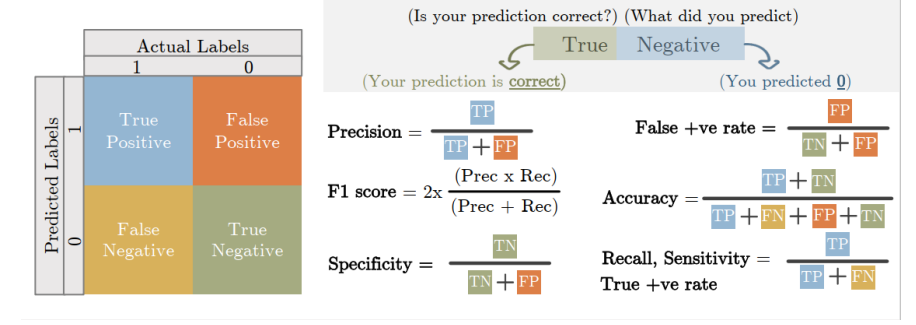



In [21]:
accuracy = accuracy_score(y_pred_gnb, y_test)
print("Accuracy:", accuracy)

Accuracy: 0.24456895300180254


In [23]:
sensitivity = recall_score(y_pred_gnb, y_test)
print("Sensitivity:", sensitivity)

Sensitivity: 0.18098396485077312


In [24]:
specificity = recall_score(y_pred_gnb, y_test, pos_label=0)
print("Specificity:", specificity)

Specificity: 0.9261891497146643




In the particular case of this model (and also the coming models), the accuracy may be considered to be reasonable, and so the specificity. This means that the model is fairly good at labelling cases where EMS is not needed. However, it lacks the ability to identify cases needing EMS, shown in the sensivity.

In [25]:
gnb = GaussianNB()


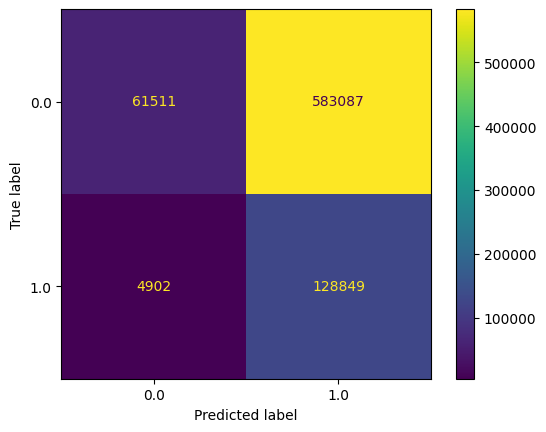

In [26]:
Matrix_gnb = confusion_matrix(y_test, y_pred_gnb, labels=gnb_loaded.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=Matrix_gnb, display_labels=gnb_loaded.classes_)
disp.plot()

The confusion matrix shows the distribution of the labels given to the data point in the test set, and if these are correct or not.

One may see again that the model is good at labelling the class 0 - no EMS, but bad at identifying cases in which EMS is needed.

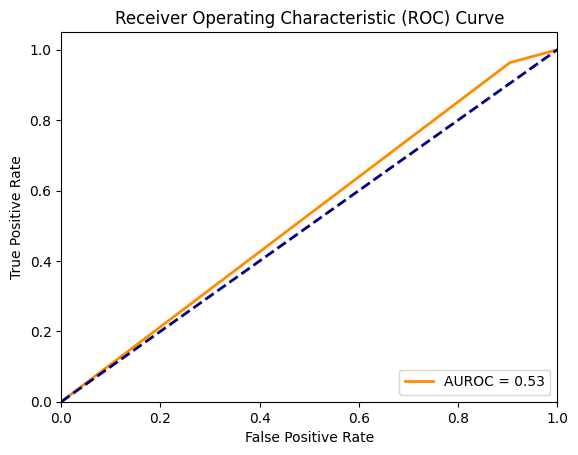

In [27]:
# assume y_test and y_pred are your true binary labels and predicted scores respectively
# y_score should be the probability estimates of the positive class (class 1)
# you can obtain y_true and y_score from your trained model's predictions

# compute fpr, tpr, thresholds and area under the curve (auc) using roc_curve and auc functions
fpr, tpr, thresholds = roc_curve(y_test, y_pred_gnb)
roc_auc = auc(fpr, tpr)

# plot the roc curve using matplotlib
plt.plot(fpr, tpr, color='darkorange', lw=2, label='AUROC = %0.2f' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()

The AUROC score achieved by this model is barely above the random labelling benchmark, which means that the model is performing very poorly.

#### 4.1.4.2 KNN

##### 4.1.4.2.1 Neigborhood size

Before initializing an istance of a K-NN model, the size of the neighborhood that the labeling of a data point will be based on, shall first be fine tuned to produce the best possible results. This is done by testing different values through the process of cross-validation and comparing instances by their AUROC scores.

In [4]:
k_values = [5,10,20,30,40,50,60,70,80,90,100,200,300,400,500]
scores_k = []
folds = 5

In [5]:
for k in k_values:
    knn = KNeighborsClassifier(n_neighbors=k)
    score_k = cross_val_score(knn, X_train[:10000], y_train[:10000], cv=5, scoring='roc_auc')
    scores_k.append(np.mean(score_k))

/usr/local/lib/python3.9/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.9/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.9/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.9/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for exam

As it can be seen, he neighborhood size for which the AUROC score is the highest is 100. Thus, this is the value chosen to train the model.

Text(0.5, 1.0, 'K-NN - Neighbors')

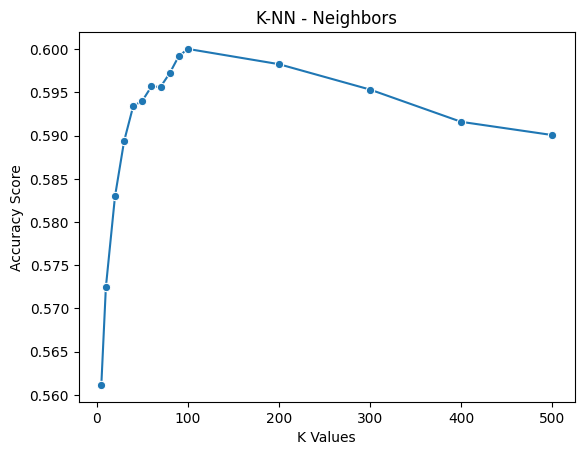

In [6]:
sns.lineplot(x = k_values, y = scores_k, marker = 'o')
plt.xlabel("K Values")
plt.ylabel("Accuracy Score")
plt.title('K-NN - Neighbors')

##### 4.1.4.2.2 Training 

As with the Naive Bayesian model, an instace of the K-NN model is fitted in batches. Nevertheless, in the case of this model (and the remaining), a partial fit is not possible. The idea of training the model in batches is therefore slightly different: Different instances of the model are generated by each batch. The outcomes of each model for the test set are combined and a joint label is agreed upon (voting system). 

In [7]:
# assume X_train is a large dataset that cannot be loaded into RAM all at once
# split X_train into num_parts smaller parts
num_parts = 10

# calculate the part size based on the number of parts and the size of the dataset
part_size = int(np.ceil(len(X_train) / num_parts))

# initialize the random forest model
knn = KNeighborsClassifier(n_neighbors=100)

# loop through the parts of the dataset
for i in range(num_parts):
    # get the indices for the current part of the dataset
    start_idx = i * part_size
    end_idx = min(start_idx + part_size, len(X_train))
    
    # get the current part of the dataset
    X_train_part = X_train[start_idx:end_idx]
    print(len(X_train_part))
    y_train_part = y_train[start_idx:end_idx]
    
    # fit the model to the part of the dataset
    knn.fit(X_train_part, y_train_part)

144698
144698


/usr/local/lib/python3.9/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.9/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


144698
144698
144698


/usr/local/lib/python3.9/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.9/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.9/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


144698
144698


/usr/local/lib/python3.9/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.9/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


144698
144698


/usr/local/lib/python3.9/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.9/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


144696


/usr/local/lib/python3.9/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


In [8]:
with open(r'/content/drive/My Drive/Colab Notebooks/SEN163B/Models/knn.pkl', 'wb') as f:
  pickle.dump(knn, f)

##### 4.1.4.2.3 Predicting

In [9]:
with open(r'/content/drive/My Drive/Colab Notebooks/SEN163B/Models/knn.pkl', 'rb') as f:
  knn_loaded = pickle.load(f)

In [10]:
y_pred_knn = knn_loaded.predict(X_test)

##### 4.1.4.2.4 Performance

In terms of performance, the K-NN model performs worse than the Naive Bayesian Model in the accuracy measure by a difference of roughly 0.2. However, it shows a better AUROC score (0.57, compared to 0.51) and Sensivity, which are the 

In [11]:
accuracy = accuracy_score(y_pred_knn, y_test)
print("Accuracy:", accuracy)

Accuracy: 0.5922960008942004


In [13]:
sensitivity = recall_score(y_pred_knn, y_test)
print("Sensitivity:", sensitivity)

Sensitivity: 0.2255443963725845


In [14]:
specificity = recall_score(y_pred_knn, y_test, pos_label=0)
print("Specificity:", specificity)

Specificity: 0.8686246327968713


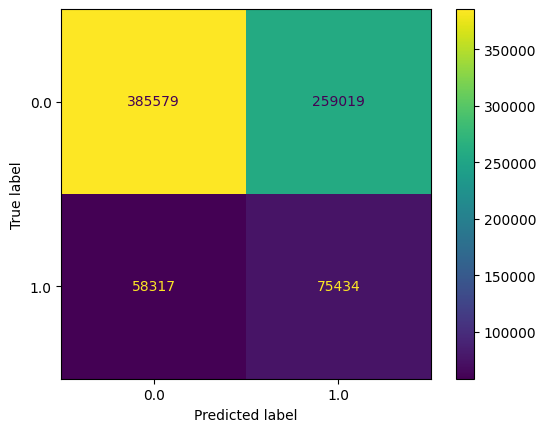

In [15]:
Matrix_knn = confusion_matrix(y_test, y_pred_knn, labels=knn.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=Matrix_knn, display_labels=knn.classes_)
disp.plot()

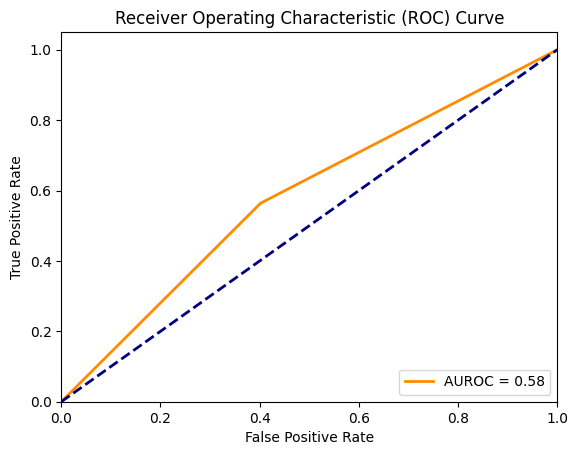

In [16]:
# assume y_test and y_pred are your true binary labels and predicted scores respectively
# y_score should be the probability estimates of the positive class (class 1)
# you can obtain y_true and y_score from your trained model's predictions

# compute fpr, tpr, thresholds and area under the curve (auc) using roc_curve and auc functions
fpr, tpr, thresholds = roc_curve(y_test, y_pred_knn)
roc_auc = auc(fpr, tpr)

# plot the roc curve using matplotlib
plt.plot(fpr, tpr, color='darkorange', lw=2, label='AUROC = %0.2f' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()

#### 4.1.4.3 Logistic Regression 

##### 4.1.4.3.1 Training 

For the logistic regression, the same method was used as for the K-NN to train  model in batches.

In [17]:
# assume X_train is a large dataset that cannot be loaded into RAM all at once
# split X_train into num_parts smaller parts
num_parts = 10

# calculate the part size based on the number of parts and the size of the dataset
part_size = int(np.ceil(len(X_train) / num_parts))

# initialize the random forest model
lr = LogisticRegression()

# loop through the parts of the dataset
for i in range(num_parts):
    # get the indices for the current part of the dataset
    start_idx = i * part_size
    end_idx = min(start_idx + part_size, len(X_train))
    
    # get the current part of the dataset
    X_train_part = X_train[start_idx:end_idx]
    print(len(X_train_part))
    y_train_part = y_train[start_idx:end_idx]
    
    # fit the model to the part of the dataset
    lr.fit(X_train_part, y_train_part)

144698


/usr/local/lib/python3.9/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.9/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.9/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().

144698


/usr/local/lib/python3.9/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


144698


/usr/local/lib/python3.9/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.9/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


144698


/usr/local/lib/python3.9/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.9/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.9/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().

144698


/usr/local/lib/python3.9/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


144698


/usr/local/lib/python3.9/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.9/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


144698


/usr/local/lib/python3.9/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.9/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.9/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().

144698


/usr/local/lib/python3.9/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.9/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


144698


/usr/local/lib/python3.9/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.9/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


144696


/usr/local/lib/python3.9/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [18]:
with open(r'/content/drive/My Drive/Colab Notebooks/SEN163B/Models/lr.pkl', 'wb') as f:
  pickle.dump(lr, f)

##### 4.1.4.3.2 Predict

In [19]:
with open(r'/content/drive/My Drive/Colab Notebooks/SEN163B/Models/lr.pkl', 'rb') as f:
  lr_loaded = pickle.load(f)

In [20]:
y_pred_lr = lr_loaded.predict(X_test)

##### 4.1.4.3.3 Performance

In [21]:
accuracy = accuracy_score(y_pred_lr, y_test)
print("Accuracy:", accuracy)

Accuracy: 0.6507761942264974


In [23]:
sensitivity = recall_score(y_pred_lr, y_test)
print("Sensitivity:", sensitivity)

Sensitivity: 0.2481494317870889


In [24]:
specificity = recall_score(y_pred_lr, y_test, pos_label=0)
print("Specificity:", specificity)

Specificity: 0.8696424746749589


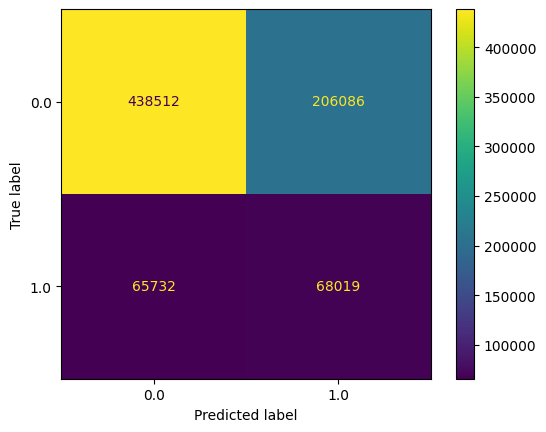

In [25]:
Matrix_rf = confusion_matrix(y_test, y_pred_lr, labels=lr.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=Matrix_rf, display_labels=lr.classes_)
disp.plot()

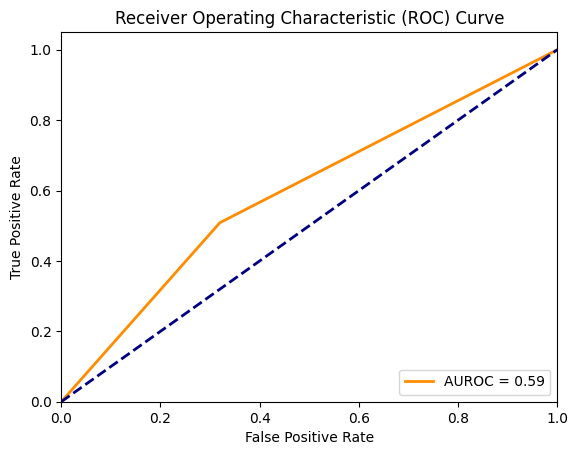

In [26]:
# assume y_test and y_pred are your true binary labels and predicted scores respectively
# y_score should be the probability estimates of the positive class (class 1)
# you can obtain y_true and y_score from your trained model's predictions

# compute fpr, tpr, thresholds and area under the curve (auc) using roc_curve and auc functions
fpr, tpr, thresholds = roc_curve(y_test, y_pred_lr)
roc_auc = auc(fpr, tpr)

# plot the roc curve using matplotlib
plt.plot(fpr, tpr, color='darkorange', lw=2, label='AUROC = %0.2f' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()

#### 4.1.4.4 Random Forest

##### 4.1.4.4.1 Feature selection

In [27]:
# assume X_train is a large dataset that cannot be loaded into RAM all at once
# split X_train into num_parts smaller parts
num_parts = 10

# calculate the part size based on the number of parts and the size of the dataset
part_size = int(np.ceil(len(X_train) / num_parts))

# initialize the random forest model
# Use SelectFromModel to select those features which importance is greater than the mean importance of all the features by default, but we can alter this threshold if we want.
rf = SelectFromModel(RandomForestClassifier())

# loop through the parts of the dataset
for i in range(num_parts):
    # get the indices for the current part of the dataset
    start_idx = i * part_size
    end_idx = min(start_idx + part_size, len(X_train))
    
    # get the current part of the dataset
    X_train_part = X_train[start_idx:end_idx]
    print(len(X_train_part))
    y_train_part = y_train[start_idx:end_idx]
    
    # fit the model to the part of the dataset
    rf.fit(X_train_part, y_train_part)

144698


/usr/local/lib/python3.9/dist-packages/sklearn/feature_selection/_from_model.py:357: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.estimator_.fit(X, y, **fit_params)


144698


/usr/local/lib/python3.9/dist-packages/sklearn/feature_selection/_from_model.py:357: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.estimator_.fit(X, y, **fit_params)


144698


/usr/local/lib/python3.9/dist-packages/sklearn/feature_selection/_from_model.py:357: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.estimator_.fit(X, y, **fit_params)


144698


/usr/local/lib/python3.9/dist-packages/sklearn/feature_selection/_from_model.py:357: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.estimator_.fit(X, y, **fit_params)


144698


/usr/local/lib/python3.9/dist-packages/sklearn/feature_selection/_from_model.py:357: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.estimator_.fit(X, y, **fit_params)


144698


/usr/local/lib/python3.9/dist-packages/sklearn/feature_selection/_from_model.py:357: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.estimator_.fit(X, y, **fit_params)


144698


/usr/local/lib/python3.9/dist-packages/sklearn/feature_selection/_from_model.py:357: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.estimator_.fit(X, y, **fit_params)


144698


/usr/local/lib/python3.9/dist-packages/sklearn/feature_selection/_from_model.py:357: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.estimator_.fit(X, y, **fit_params)


144698


/usr/local/lib/python3.9/dist-packages/sklearn/feature_selection/_from_model.py:357: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.estimator_.fit(X, y, **fit_params)


144696


/usr/local/lib/python3.9/dist-packages/sklearn/feature_selection/_from_model.py:357: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.estimator_.fit(X, y, **fit_params)


In [28]:
rf.get_support()

array([ True,  True,  True,  True,  True,  True,  True, False,  True,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False,  True, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False,  True,  True, False,
       False, False, False, False, False, False, False,  True, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False])

In [29]:
selected_feat= X_train.columns[(rf.get_support())]
len(selected_feat)

12

In [30]:
selected_feat = list(selected_feat)
print(selected_feat)

['ADDR_PCT_CD', 'KY_CD', 'PD_CD', 'JURISDICTION_CODE', 'Latitude', 'Longitude', 'Occurrence_Report_Interval', 'SUSP_SEX_M', 'VIC_RACE_BLACK', 'VIC_AGE_GROUP_25-44', 'VIC_AGE_GROUP_45-64', 'CMPLNT_TO_TD_night']


In [31]:
# Open a file for writing
with open(r'/content/drive/My Drive/Colab Notebooks/SEN163B/SelectedFeatures_RF.txt', 'w') as file:
    # Loop over the list and write each element to a new line in the file
    for item in selected_feat:
        file.write(str(item) + '\n')

In [32]:
X_train_rf = X_train[selected_feat] 
X_test_rf = X_test[selected_feat]
X_val_rf = X_val[selected_feat]

##### 4.1.4.4.2 Training 

In [33]:
# assume X_train is a large dataset that cannot be loaded into RAM all at once
# split X_train into num_parts smaller parts
num_parts = 10

# calculate the part size based on the number of parts and the size of the dataset
part_size = int(np.ceil(len(X_train_rf) / num_parts))

# initialize the random forest model
# Use SelectFromModel to select those features which importance is greater than the mean importance of all the features by default, but we can alter this threshold if we want.
rf = RandomForestClassifier(max_depth = 3, min_samples_leaf = 3, min_samples_split = 2, n_estimators = 50)

# # loop through the parts of the dataset
# for i in range(num_parts):
#     # get the indices for the current part of the dataset
#     start_idx = i * part_size
#     end_idx = min(start_idx + part_size, len(X_train_rf))
    
#     # get the current part of the dataset
#     X_train_part = X_train_rf[start_idx:end_idx]
#     print(len(X_train_part))
#     y_train_part = y_train[start_idx:end_idx]
    
#     # fit the model to the part of the dataset
rf.fit(X_train, y_train)

<ipython-input-33-6445b8f7bec2>:24: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  rf.fit(X_train, y_train)


RandomForestClassifier(max_depth=3, min_samples_leaf=3, n_estimators=50)

In [35]:
with open(r'/content/drive/My Drive/Colab Notebooks/SEN163B/Models/rf.pkl', 'wb') as f:
  pickle.dump(rf, f)

##### 4.1.4.4.3 Predicting 

In [36]:
with open(r'/content/drive/My Drive/Colab Notebooks/SEN163B/Models/rf.pkl', 'rb') as f:
  rf_loaded = pickle.load(f)

In [37]:
y_pred_rf = rf_loaded.predict(X_test)

##### 4.1.4.4.4 Performance

In [38]:
accuracy = accuracy_score(y_pred_rf, y_test)
print("Accuracy:", accuracy)

Accuracy: 0.6592030053356528


In [39]:
sensitivity = recall_score(y_pred_rf, y_test)
print("Sensitivity:", sensitivity)

Sensitivity: 0.2470260537695634


In [40]:
specificity = recall_score(y_pred_rf, y_test, pos_label=0)
print("Specificity:", specificity)

Specificity: 0.8658571635241356


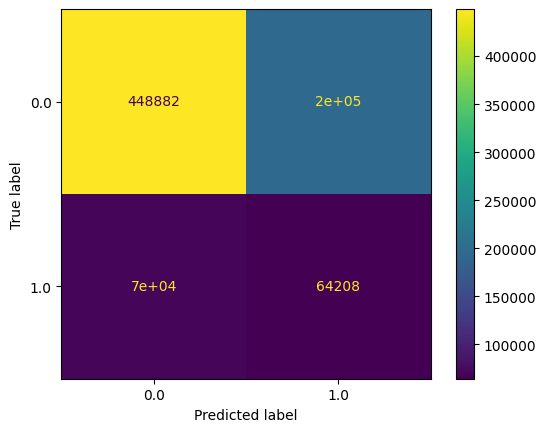

In [41]:
Matrix_rf = confusion_matrix(y_test, y_pred_rf, labels=rf.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=Matrix_rf, display_labels=rf.classes_)
disp.plot()

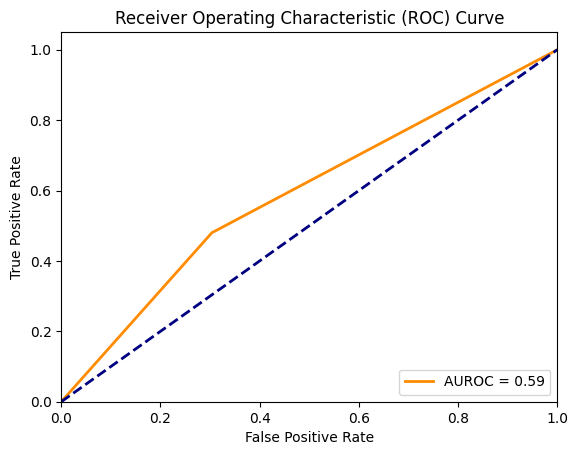

In [42]:
# assume y_test and y_pred are your true binary labels and predicted scores respectively
# y_score should be the probability estimates of the positive class (class 1)
# you can obtain y_true and y_score from your trained model's predictions

# compute fpr, tpr, thresholds and area under the curve (auc) using roc_curve and auc functions
fpr, tpr, thresholds = roc_curve(y_test, y_pred_rf)
roc_auc = auc(fpr, tpr)

# plot the roc curve using matplotlib
plt.plot(fpr, tpr, color='darkorange', lw=2, label='AUROC = %0.2f' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()

##### 4.1.4.4.5 Feature Evaluation 

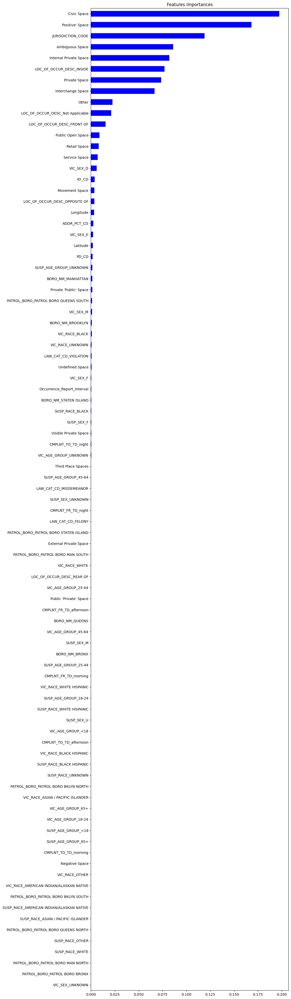

In [43]:
# Create a pd.Series of features importances
importances = pd.Series(data=rf.feature_importances_,
                        index= X_train.columns)
# Sort importances
importances_sorted = importances.sort_values()
# Draw a horizontal barplot of importances_sorted
plt.figure(figsize=(10,50))
importances_sorted.plot(kind='barh', color='blue')
plt.title('Features Importances')
plt.show()

### 4.1.5 Gradient Boosting (Final model)

#### 4.1.5.1 Feature Selection

As done for the Random Forest model, a series of features, according to their importance in the predicting process, are first selected with the use of the method SelectFromModel(), to scale down the models complexity, and so the duration of the fitting and predicting process. 

In [44]:
# assume X_train is a large dataset that cannot be loaded into RAM all at once
# split X_train into num_parts smaller parts
num_parts = 10

# calculate the part size based on the number of parts and the size of the dataset
part_size = int(np.ceil(len(X_train) / num_parts))

# initialize the random forest model
# Use SelectFromModel to select those features which importance is greater than the mean importance of all the features by default, but we can alter this threshold if we want.
gb = SelectFromModel(GradientBoostingClassifier())

# loop through the parts of the dataset
for i in range(num_parts):
    # get the indices for the current part of the dataset
    start_idx = i * part_size
    end_idx = min(start_idx + part_size, len(X_train))
    
    # get the current part of the dataset
    X_train_part = X_train[start_idx:end_idx]
    print(len(X_train_part))
    y_train_part = y_train[start_idx:end_idx]
    
    # fit the model to the part of the dataset
    gb.fit(X_train_part, y_train_part)

144698


/usr/local/lib/python3.9/dist-packages/sklearn/ensemble/_gb.py:437: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


144698


/usr/local/lib/python3.9/dist-packages/sklearn/ensemble/_gb.py:437: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


144698


/usr/local/lib/python3.9/dist-packages/sklearn/ensemble/_gb.py:437: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


144698


/usr/local/lib/python3.9/dist-packages/sklearn/ensemble/_gb.py:437: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


144698


/usr/local/lib/python3.9/dist-packages/sklearn/ensemble/_gb.py:437: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


144698


/usr/local/lib/python3.9/dist-packages/sklearn/ensemble/_gb.py:437: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


144698


/usr/local/lib/python3.9/dist-packages/sklearn/ensemble/_gb.py:437: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


144698


/usr/local/lib/python3.9/dist-packages/sklearn/ensemble/_gb.py:437: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


144698


/usr/local/lib/python3.9/dist-packages/sklearn/ensemble/_gb.py:437: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


144696


/usr/local/lib/python3.9/dist-packages/sklearn/ensemble/_gb.py:437: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


The method used selects those features which importance is greater than the mean importance of all the features. This way the dataset complexity is reduced, maintaining the variables that influence the model's outcome the most.

In [45]:
gb.get_support()

array([False, False, False,  True, False,  True, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False,  True,  True, False,  True,  True,  True,
        True, False,  True, False, False, False, False, False])

In [46]:
selected_feat= X_train.columns[(gb.get_support())]
len(selected_feat)

9

In [47]:
selected_feat = list(selected_feat)
print(selected_feat)

['JURISDICTION_CODE', 'Longitude', 'Other', 'Civic Space', 'Movement Space', 'Service Space', 'Undefined Space', 'Interchange Space', 'Retail Space']


In [48]:
# Open a file for writing
with open(r'/content/drive/My Drive/Colab Notebooks/SEN163B/SelectedFeatures_RF.txt', 'w') as file:
    # Loop over the list and write each element to a new line in the file
    for item in selected_feat:
        file.write(str(item) + '\n')

#### 4.1.5.2 Re-compute training, testing and validation sets 

The datasets are shrinked in number of features in accordance to the selection.

In [49]:
X_train = X_train[selected_feat] 
X_test = X_test[selected_feat]
X_val = X_val[selected_feat]

#### 4.1.5.3 Hyperparameter Tuning

In [50]:
# Number of trees in Random Forest
gb_n_estimators = [int(x) for x in np.linspace(200, 1000, 5)]
gb_n_estimators.append(1500)
gb_n_estimators.append(2000)

# Maximum number of levels in tree
gb_max_depth = [int(x) for x in np.linspace(5, 55, 11)]
# Add the default as a possible value
gb_max_depth.append(None)

# Number of features to consider at every split
gb_max_features = ['auto', 'sqrt', 'log2']

# Criterion to split on
gb_criterion = ['friedman_mse', 'squared_error']

# Minimum number of samples required to split a node
gb_min_samples_split = [int(x) for x in np.linspace(2, 10, 9)]

# Minimum decrease in impurity required for split to happen
gb_min_impurity_decrease = [0.0, 0.05, 0.1]

# Create the grid
gb_grid = {'n_estimators': gb_n_estimators,
               'max_depth': gb_max_depth,
               'max_features': gb_max_features,
               'criterion': gb_criterion,
               'min_samples_split': gb_min_samples_split,
               'min_impurity_decrease': gb_min_impurity_decrease}

In [51]:
print(gb_grid)

{'n_estimators': [200, 400, 600, 800, 1000, 1500, 2000], 'max_depth': [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, None], 'max_features': ['auto', 'sqrt', 'log2'], 'criterion': ['friedman_mse', 'squared_error'], 'min_samples_split': [2, 3, 4, 5, 6, 7, 8, 9, 10], 'min_impurity_decrease': [0.0, 0.05, 0.1]}


In [53]:
# Initialize the Random Forest Classifier
gb_tuning = GradientBoostingClassifier()

# Initialize the GridSearchCV object with 5-fold cross-validation
grid_search = RandomizedSearchCV(estimator = gb_tuning, param_distributions = gb_grid, scoring='roc_auc', 
                               n_iter = 100, cv = 3, verbose = 2, random_state = 42, 
                               n_jobs = -1)

# Fit the GridSearchCV object to the data
grid_search.fit(X_train[:10000], y_train[:10000])

# Print the best hyperparameters and corresponding AUROC score
print("Best Hyperparameters:", grid_search.best_params_)
print("Best AUROC Score:", grid_search.best_score_)


Fitting 3 folds for each of 100 candidates, totalling 300 fits


KeyboardInterrupt: ignored

In [ ]:
# Open a file for writing in binary mode
with open(r'/content/drive/My Drive/Colab Notebooks/SEN163B/BestHyperparameters_gb.txt', 'wb') as f:
    # Write the dictionary to the file using pickle
    pickle.dump(grid_search.best_params_, f)

In [ ]:
# Get the results of the grid search as a DataFrame
results = pd.DataFrame(grid_search.cv_results_)
results.to_excel(r'/content/drive/My Drive/Colab Notebooks/SEN163B/Hyperparameters_gb.xlsx')

#### 4.1.5.4 Results tuning

In [ ]:
# Open the file for reading in binary mode
with open(r'/content/drive/My Drive/Colab Notebooks/SEN163B/BestHyperparameters_gb.txt', 'rb') as f:
    # Load the dictionary from the file using pickle
    loaded_dict = pickle.load(f)

# Print the loaded dictionary
print(loaded_dict)

In [ ]:
criterion_gb = loaded_dict['criterion']
max_depth_gb = loaded_dict['max_depth']
min_impurity_decrease_gb = loaded_dict['min_impurity_decrease']
min_samples_split_gb = loaded_dict['min_samples_split']
n_estimators_gb = loaded_dict['n_estimators']
max_features_gb = loaded_dict['max_features']

In [ ]:
results = pd.read_excel(r'/content/drive/My Drive/Colab Notebooks/SEN163B/Hyperparameters_gb.xlsx')
results

#### 4.1.5.5 Training

The best values for the hyperparameters are passed onto an instance of the model, now to be trained and tested.

In [ ]:
# assume X_train is a large dataset that cannot be loaded into RAM all at once
# split X_train into num_parts smaller parts
num_parts = 10

# calculate the part size based on the number of parts and the size of the dataset
part_size = int(np.ceil(len(X_train) / num_parts))

# initialize the random forest model
# Use SelectFromModel to select those features which importance is greater than the mean importance of all the features by default, but we can alter this threshold if we want.
gb = GradientBoostingClassifier(criterion = criterion_gb, max_depth = max_depth_gb, min_impurity_decrease = min_impurity_decrease_gb, min_samples_split = min_samples_split_gb, n_estimators = n_estimators_gb, max_features = max_features_gb)

# loop through the parts of the dataset
for i in range(num_parts):
    # get the indices for the current part of the dataset
    start_idx = i * part_size
    end_idx = min(start_idx + part_size, len(X_train))
    
    # get the current part of the dataset
    X_train_part = X_train[start_idx:end_idx]
    print(len(X_train_part))
    y_train_part = y_train[start_idx:end_idx]
    
    # fit the model to the part of the dataset
    gb.fit(X_train_part, y_train_part)

In [ ]:
with open(r'/content/drive/My Drive/Colab Notebooks/SEN163B/Models/gb.pkl', 'wb') as f:
  pickle.dump(gb, f)


#### 4.1.5.6 Predicting

In [ ]:
with open(r'/content/drive/My Drive/Colab Notebooks/SEN163B/Models/gb.pkl', 'rb') as f:
  gb_loaded = pickle.load(f)

In [ ]:
y_pred_gb = gb_loaded.predict(X_test)

In [ ]:
y_pred_gb_df = pd.DataFrame(data=y_pred_gb, columns=["label_value"])

In [ ]:
y_pred_gb_df.head()

In [ ]:
y_pred_gb_df['label_value'] = y_pred_gb_df['label_value'].astype(str)

In [ ]:
y_pred_gb_df.to_csv(r'/content/drive/My Drive/Colab Notebooks/y_pred_gb.csv')

#### 4.1.5.7 Performance

In [ ]:
accuracy = accuracy_score(y_pred_gb, y_test)
print("Accuracy:", accuracy)

In [ ]:
sensitivity = recall_score(y_pred_gb, y_test)
print("Sensitivity:", sensitivity)

In [ ]:
specificity = recall_score(y_pred_gb, y_test, pos_label=0)
print("Specificity:", specificity)

In [ ]:
Matrix_gb = confusion_matrix(y_test, y_pred_gb, labels=gb.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=Matrix_gb, display_labels=gb.classes_)
disp.plot()

In [ ]:
# assume y_test and y_pred are your true binary labels and predicted scores respectively
# y_score should be the probability estimates of the positive class (class 1)
# you can obtain y_true and y_score from your trained model's predictions

# compute fpr, tpr, thresholds and area under the curve (auc) using roc_curve and auc functions
fpr, tpr, thresholds = roc_curve(y_test, y_pred_gb)
roc_auc = auc(fpr, tpr)

# plot the roc curve using matplotlib
plt.plot(fpr, tpr, color='darkorange', lw=2, label='AUROC = %0.2f' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()

#### 4.1.5.8 Feature evaluation 

The importances of the features in the behavior of the model are extracted, in order to understand on which features the model beases its decision on. This helps **explaining** the model's outcome, and may be used as a first tool to be **transparent** about its behavior.

In [ ]:
# Create a pd.Series of features importances
importances = pd.Series(data=gb.feature_importances_,
                        index= X_train.columns)
# Sort importances
importances_sorted = importances.sort_values()
# Draw a horizontal barplot of importances_sorted
plt.figure(figsize=(10,10))
importances_sorted.plot(kind='barh', color='blue')
plt.title('Features Importances')
plt.show()

## 4.2 Research Question 2: *In which locations are crimes that require EMS interventions likely to happen?*

NOTE: For this part, the dataset with only crimes that are likely tor require EMS, is used

In [2]:
# Import the dataset 
Treated_Data = pd.read_csv(r'/content/drive/My Drive/Colab Notebooks/Treated_Data.csv')

### 4.2.1 Naive Bayesian Model 

For this Naive Bayesian model the following tutorial and code are used: https://www.kaggle.com/code/prashant111/naive-bayes-classifier-in-python#8.-Declare-feature-vector-and-target-variable-

This section will cover a Naive Bayesian model trying to predict whether a crime happened inside or outside.Therefore we first need to make a new variable Location that classifies Inside, Outside and Not Applicable

#### 4.2.1.1 Pre-processing steps for model build

In [3]:
# add a variable with inside and oustide (grouping front, rear and opposite of)
Treated_Data['LOCATION'] = Treated_Data['LOC_OF_OCCUR_DESC'].replace(['FRONT OF', 'REAR OF', 'OPPOSITE OF'], 'OUTSIDE')

# Declare target variable and drop the columns that we are not using
X = Treated_Data.drop(['LOCATION'], axis=1)

X = X.drop(['LOC_OF_OCCUR_DESC', 'CMPLNT_FR_DT','CMPLNT_FR_TM','CMPLNT_TO_DT','CMPLNT_TO_TM','RPT_DT'], axis=1)

y = Treated_Data['LOCATION']

# Split data into seperate training and test set
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 0)

# define categorical variables 
categorical = [col for col in X_train.columns if X_train[col].dtypes == 'O']

# define numerical variables
numerical = [col for col in X_train.columns if X_train[col].dtypes != 'O']

In [4]:
print("X_train:", len(X_train))
print("X_test:", len(X_test))
print("y_train:", len(y_train))
print("y_test:", len(y_test))

# test whether there are missing values
print("\n")
print("test if there are missing values")
X_test[categorical].isnull().sum()
X_train[numerical].isnull().sum()

X_train: 938076
X_test: 402033
y_train: 938076
y_test: 402033


test if there are missing values


Unnamed: 0.1                  0
Unnamed: 0                    0
ADDR_PCT_CD                   0
KY_CD                         0
PD_CD                         0
JURISDICTION_CODE             0
Latitude                      0
Longitude                     0
Occurrence_Report_Interval    0
EMS                           0
dtype: int64

#### 4.2.1.2 One-hot encoding

The next step is to encode the categorical variables to one-hot encoding. Therefore the category_encoders library will be used

In [5]:
pip install category_encoders

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [6]:
import category_encoders as ce

# encode remaining variables with one-hot encoding
encoder = ce.OneHotEncoder(cols=['LAW_CAT_CD', 'BORO_NM', 'PREM_TYP_DESC', 'SUSP_AGE_GROUP', 
                                 'SUSP_RACE', 'SUSP_SEX', 'PATROL_BORO','VIC_AGE_GROUP','VIC_RACE','VIC_SEX'])

X_train = encoder.fit_transform(X_train)

X_test = encoder.transform(X_test)

In [20]:
# from the initial 19 columns, we now have 136 columns 
X_train.shape
X_test.shape
X_test.head(10)

#X_train = X_train.drop(["Unnamed: 0.1"], axis=1)
X_test = X_test.drop(["Unnamed: 0.1"], axis=1)

#### 4.2.1.3 Normalizing


After encoding the variables, the next step is to normalize the range of all the variables using **feature scaling**

In [21]:
cols = X_train.columns

from sklearn.preprocessing import RobustScaler

# for the scaling we use the RobustScaler from sklearn
scaler = RobustScaler()

X_train = scaler.fit_transform(X_train)

X_test = scaler.transform(X_test)

X_train = pd.DataFrame(X_train, columns=[cols])
X_test = pd.DataFrame(X_test, columns=[cols])

#### 4.2.1.4 Model training 

In [22]:
# train a Gaussian Naive Bayes classifier on the training set
from sklearn.naive_bayes import GaussianNB


# instantiate the model
gnb = GaussianNB()


# fit the model
gnb.fit(X_train, y_train)

y_pred = gnb.predict(X_test)

from sklearn.metrics import accuracy_score

print('Model accuracy score: {0:0.4f}'. format(accuracy_score(y_test, y_pred)))

Model accuracy score: 0.5914


#### 4.2.1.5 Model testing 

In [66]:
y_pred_train = gnb.predict(X_train)

# print the scores on training and test set

print("\n")
print('Training set score: {:.4f}'.format(gnb.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(gnb.score(X_test, y_test)))



Training set score: 0.5922
Test set score: 0.5914


The training set score and the test score are quite comparable, therefore no sign of overfitting. Now we just have to make sure the score we are getting, is indeed better than just taking a random quess for the biggest category (inside). We do this by comparing the test accuracy versus the null accuracy

In [67]:
y_test.value_counts()

# check null accuracy score (random quessing the biggest category)
null_accuracy = (213952/(213952+101912+86169))
print('Null accuracy score: {0:0.4f}'. format(null_accuracy))

Null accuracy score: 0.5322


The model accuracy score was 0.5914 and the null accuracy score was 0.5322. Therefore we can conclude that the model indeed predicts better than taking a random guess. However, the difference is not that big. 

Now it is time to dive deeper into the results by creating a confusion matrix, and by plotting the matrix with a heatmap


Confusion matrix:
                 Inside  Outside  Not Appplicable
Inside           132684     7658            73610
Outside            2365    81890             1914
Not Appplicable   20749    57965            23198


<Axes: >

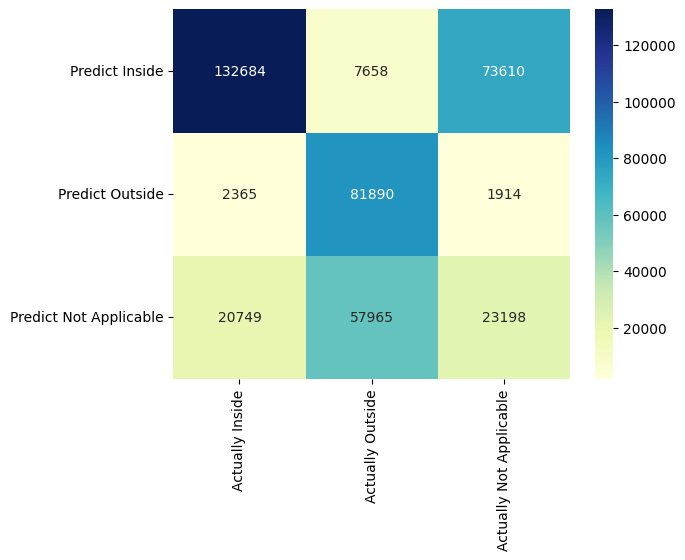

In [68]:
labels = ['Inside', 'Outside','Not Appplicable']

# Create a confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Print the confusion matrix
print('Confusion matrix:')
print(pd.DataFrame(cm, index=labels, columns=labels))


# visualize confusion matrix with seaborn heatmap

cm_matrix = pd.DataFrame(data=cm, columns=['Actually Inside', 'Actually Outside', 'Actually Not Applicable'], 
                                 index=['Predict Inside', 'Predict Outside', 'Predict Not Applicable'])

sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')

#### 4.2.1.6 Performance

In [69]:
accuracy = accuracy_score(y_pred, y_test)
print("Accuracy:", accuracy)

Accuracy: 0.591424087077429


In [75]:
sensitivity = recall_score(y_pred, y_test, average="macro")
print("Sensitivity:", sensitivity)

Sensitivity: 0.5472539416195449


In [76]:
specificity = recall_score(y_pred, y_test, pos_label=0, average="macro")
print("Specificity:", specificity)

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1396: UserWarning: Note that pos_label (set to 0) is ignored when average != 'binary' (got 'macro'). You may use labels=[pos_label] to specify a single positive class.
  warnings.warn(


Specificity: 0.5472539416195449


### 4.2.2 Gradient Booster

For this model, the same pre-processing steps are being use

#### 4.2.2.1 Training of the model

Note: the following code may take a long time to run

In [23]:
# This code is used to train the model. However, the runtime is over 1h.
gb = GradientBoostingClassifier()

gb.fit(X_train, y_train)


KeyboardInterrupt: ignored

In [27]:
# save the trained model to a file in Google Drive --> only required the first time after model training 
filename = '/content/drive/My Drive/Colab Notebooks/SEN163B/Models/gb_classifier.pkl'
with open(filename, 'wb') as file:
    pickle.dump(gb, file)
    

#### 4.2.2.2 Predicting 

In [28]:
# load the saved model from the file
filename = '/content/drive/My Drive/Colab Notebooks/gb_classifier.pkl'
with open(filename, 'rb') as file:
    loaded_model = pickle.load(file)

# now you can use the loaded model to make predictions
gb = loaded_model

In [29]:
# make predictions using the loaded model
y_pred_gb = loaded_model.predict(X_test)

# calculate accuracy
accuracy = accuracy_score(y_pred_gb, y_test)
print("Accuracy:", accuracy)

Accuracy: 0.5263199787082155


In [31]:
sensitivity = recall_score(y_pred_gb, y_test, average = "macro")
print("Sensitivity:", sensitivity)

Sensitivity: 0.47197041352277186


In [32]:
print("Number of mislabeled points out of a total %d points : %d" % (X_test.shape[0], (y_test != y_pred_gb).sum()))

Number of mislabeled points out of a total 402033 points : 190435


Confusion matrix:
                 Inside  Outside  Not Appplicable
Inside           127592    14857            71503
Outside           16162    66502             3505
Not Appplicable   26742    57666            17504


<Axes: >

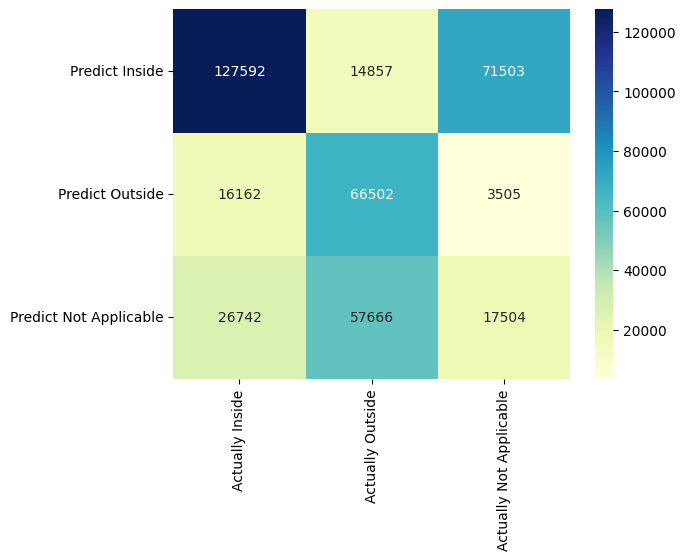

In [33]:
#Matrix_gb = confusion_matrix(y_test, y_pred_gb, labels=gb.classes_)
#disp = ConfusionMatrixDisplay(confusion_matrix=Matrix_gb, display_labels=gb.classes_)
#disp.plot()

labels = ['Inside', 'Outside','Not Appplicable']

# Create a confusion matrix
cm = confusion_matrix(y_test, y_pred_gb)
# Print the confusion matrix
print('Confusion matrix:')
print(pd.DataFrame(cm, index=labels, columns=labels))


# visualize confusion matrix with seaborn heatmap

cm_matrix = pd.DataFrame(data=cm, columns=['Actually Inside', 'Actually Outside', 'Actually Not Applicable'], 
                                 index=['Predict Inside', 'Predict Outside', 'Predict Not Applicable'])

sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')

## 4.3 Research Question 3: What characteristics would make persons more likely to become a victim requiring EMS intervention?

In [34]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix


In [4]:
Data1 = pd.read_csv(r'/content/drive/My Drive/Colab Notebooks/Treated_Full_Data.csv')

<ipython-input-4-a34d66115dce>:1: DtypeWarning: Columns (23) have mixed types. Specify dtype option on import or set low_memory=False.
  Data1 = pd.read_csv(r'/content/drive/My Drive/Colab Notebooks/Treated_Full_Data.csv')


### 4.3.1 Logistic regression model

#### 4.3.1.1 Data pre-processing

In [5]:
Data1 = Data1.drop(['ID','ADDR_PCT_CD','KY_CD','PD_CD','JURISDICTION_CODE','Latitude','Longitude','CMPLNT_FR_DT','CMPLNT_FR_TM','CMPLNT_TO_DT','CMPLNT_TO_TM','RPT_DT','LAW_CAT_CD','BORO_NM','LOC_OF_OCCUR_DESC','PREM_TYP_DESC','SUSP_AGE_GROUP', 'SUSP_RACE', 'SUSP_SEX','PATROL_BORO','Occurrence_Report_Interval'], axis=1)

In [6]:
categorical = [var for var in Data1.columns if Data1[var].dtype=='O']

print('There are {} categorical variables\n'.format(len(categorical)))

print('The categorical variables are :', categorical)

There are 3 categorical variables

The categorical variables are : ['VIC_AGE_GROUP', 'VIC_RACE', 'VIC_SEX']


In [7]:
X = Data1.drop(['EMS'], axis=1)

y = Data1['EMS']

Data1.dtypes


VIC_AGE_GROUP     object
VIC_RACE          object
VIC_SEX           object
EMS              float64
dtype: object

In [8]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)
#X_train, X_val, y_train, y_val = skl.model_selection.train_test_split(X_train, y_train, test_size=0.6, random_state=1, shuffle=True) # 0.85 x 0.5 = 0.425

In [9]:
X_train.shape, X_test.shape

((6226786, 3), (1556697, 3))

In [10]:
X_train.dtypes

VIC_AGE_GROUP    object
VIC_RACE         object
VIC_SEX          object
dtype: object

In [11]:
categorical = [col for col in X_train.columns if X_train[col].dtypes == 'O']

categorical

['VIC_AGE_GROUP', 'VIC_RACE', 'VIC_SEX']

In [12]:
! pip install --upgrade category_encoders

import category_encoders as ce

# encode remaining variables with one-hot encoding

encoder = ce.OneHotEncoder(cols=['VIC_AGE_GROUP','VIC_RACE','VIC_SEX'])

X_train = encoder.fit_transform(X_train)

X_test = encoder.transform(X_test)

# note: running 2x will crash it

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.2/81.2 kB 8.1 MB/s eta 0:00:00


#### 4.3.1.2 Training

In [13]:
# Fit logistic regression model on the training data
model = sm.Logit(y_train, sm.add_constant(X_train)).fit()

# Get the table with coefficients and p-values
table = model.summary2().tables[1]


         Current function value: 0.436249
         Iterations: 35


/usr/local/lib/python3.9/dist-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [14]:
# Predict on the test data
y_pred = model.predict(sm.add_constant(X_test))

                    Coef.     Std.Err.         z     P>|z|        [0.025  \
const           -1.536577          NaN       NaN       NaN           NaN   
VIC_AGE_GROUP_1 -0.212073  5643.752710 -0.000038  0.999970 -11061.764123   
VIC_AGE_GROUP_2 -0.064121  5643.752710 -0.000011  0.999991 -11061.616171   
VIC_AGE_GROUP_3 -0.353046  5643.752710 -0.000063  0.999950 -11061.905096   
VIC_AGE_GROUP_4 -0.500899  5652.732434 -0.000089  0.999929 -11079.652883   
VIC_AGE_GROUP_5 -0.296189  5643.752710 -0.000052  0.999958 -11061.848239   
VIC_AGE_GROUP_6 -0.110263  5607.690023 -0.000020  0.999984 -10990.980745   
VIC_RACE_1       0.106812  2354.752862  0.000045  0.999964  -4615.123990   
VIC_RACE_2       0.108759  2354.752862  0.000046  0.999963  -4615.122043   
VIC_RACE_3      -0.158132  2354.752862 -0.000067  0.999946  -4615.388934   
VIC_RACE_4       0.123322  2354.752862  0.000052  0.999958  -4615.107480   
VIC_RACE_5      -0.362867  2354.752862 -0.000154  0.999877  -4615.593669   
VIC_RACE_6  

The model shows that all variables regarding the characteristics of the victim are not statistically significant in relation with the dependent variable whether a crime requires EMS. 

In [19]:
# Round the predicted probabilities to binary values
y_pred = y_pred.round()


#### 4.3.1.3 Performance

In [20]:
accuracy = accuracy_score(y_pred, y_test)
print("Accuracy:", accuracy)

Accuracy: 0.8279922168540185


In [21]:
sensitivity = recall_score(y_pred, y_test)
print("Sensitivity:", sensitivity)

Sensitivity: 0.0


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [22]:
specificity = recall_score(y_pred, y_test, pos_label=0)
print("Specificity:", specificity)

Specificity: 0.8279922168540185


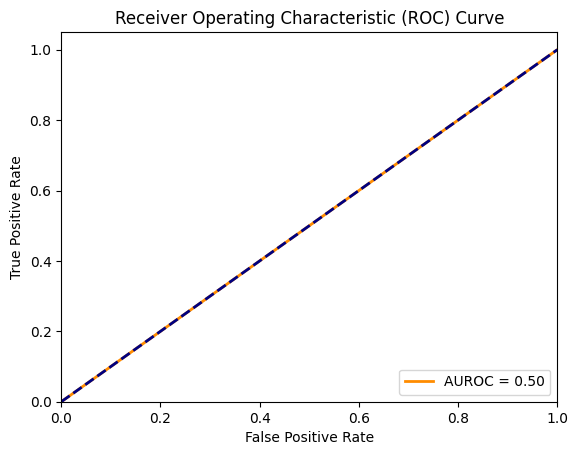

In [27]:
# assume y_test and y_pred are your true binary labels and predicted scores respectively
# y_score should be the probability estimates of the positive class (class 1)
# you can obtain y_true and y_score from your trained model's predictions

# compute fpr, tpr, thresholds and area under the curve (auc) using roc_curve and auc functions
fpr, tpr, thresholds = roc_curve(y_test, y_pred)
roc_auc = auc(fpr, tpr)

# plot the roc curve using matplotlib
plt.plot(fpr, tpr, color='darkorange', lw=2, label='AUROC = %0.2f' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()

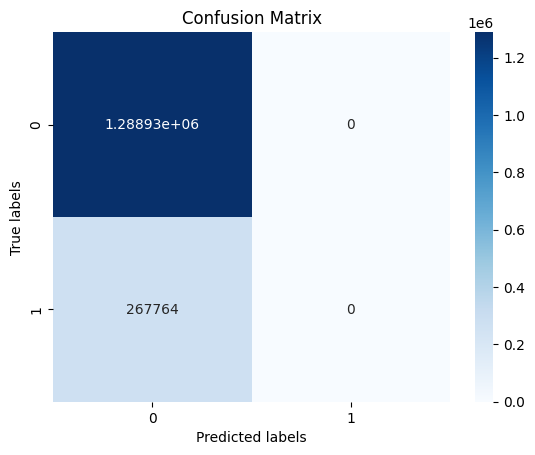

In [28]:
# Create confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Plot heatmap of confusion matrix
sns.heatmap(cm, annot=True, fmt='g', cmap='Blues')

# Add labels and title
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')

# Show plot
plt.show()

The results show that the model just guesses that every crime does not require EMS. This is because the independent variables in the model do not contain information to make a better prediction. Therefore, according to this logistic regression model, the conclusion can be made that the characteristics of the victim are not related to whether EMS is required or not for a crime.  

# 5 Prescriptive Analysis

In [1]:
# first, important all used libraries 
import pandas as pd
import numpy as np
from datetime import datetime
import seaborn as sns
import matplotlib.pyplot as plt
import sklearn as skl
import pickle

from sklearn import model_selection
from sklearn.utils import resample
from sklearn.utils import shuffle
from sklearn.model_selection import cross_val_score
from sklearn.metrics import (
    accuracy_score,
    recall_score,
    roc_curve,
    auc,
    confusion_matrix,
    ConfusionMatrixDisplay,
)
from sklearn.datasets import load_iris
from sklearn.naive_bayes import GaussianNB
from sklearn import neighbors
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import export_graphviz
from IPython.display import Image
import graphviz
from sklearn.feature_selection import SelectFromModel
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import roc_auc_score
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.preprocessing import MinMaxScaler
import statsmodels.api as sm

The first step is to load the model in order to to all the prescriptive analysis steps

In [2]:
with open(r'/content/drive/My Drive/Colab Notebooks/Kopie van gb.pkl', 'rb') as f:
  gb_loaded = pickle.load(f)

In [3]:
X_train = pd.read_csv(r'/content/drive/My Drive/Colab Notebooks/SEN163B/X_train.csv')
y_train = pd.read_csv(r'/content/drive/My Drive/Colab Notebooks/SEN163B/y_train.csv')


X_test = pd.read_csv(r'/content/drive/My Drive/Colab Notebooks/SEN163B/X_test.csv')
y_test = pd.read_csv(r'/content/drive/My Drive/Colab Notebooks/SEN163B/y_test.csv')

X_val = pd.read_csv(r'/content/drive/My Drive/Colab Notebooks/SEN163B/X_val.csv')
y_val = pd.read_csv(r'/content/drive/My Drive/Colab Notebooks/SEN163B/y_val.csv')

In [4]:
X_train = X_train.drop(["Unnamed: 0"], axis=1)
y_train = y_train.drop(["Unnamed: 0"], axis=1)

X_test = X_test.drop(["Unnamed: 0"], axis=1)
y_test = y_test.drop(["Unnamed: 0"], axis=1)

X_val = X_val.drop(["Unnamed: 0"], axis=1)
y_val = y_val.drop(["Unnamed: 0"], axis=1)

In [ ]:
y_pred_gb = gb_loaded.predict(X_test)

In [ ]:
y_pred_gb_df = pd.DataFrame(data=y_pred_gb, columns=["label_value"])

In [ ]:
y_pred_gb_df['label_value'] = y_pred_gb_df['label_value'].astype(str)

In [ ]:
y_pred_gb_df.to_csv(r'/content/drive/My Drive/Colab Notebooks/y_pred_gb.csv')

## 5.1 RQ 1 Model

### 5.1.1 Validation

To assess the model's robustness, a cross validation is carried out on the validation set, and a boxplot with the distribution of the AUROC score of the different instances is built.

In [ ]:
# Perform 10-fold cross-validation on the boosted classifier
scores = cross_val_score(gb_loaded, X_val, y_val, cv=10, scoring='roc_auc')

# Print the accuracy scores for each fold and the mean score
print("Accuracy scores for each fold:", scores)
print("Mean accuracy score:", scores.mean())

/usr/local/lib/python3.9/dist-packages/sklearn/ensemble/_gb.py:437: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.9/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/py

In [ ]:
# Generate a boxplot of the AUROC values
plt.boxplot(scores)
plt.title("Distribution of AUROC values")
plt.ylabel("AUROC")
plt.show()

## 5.1.2 Operationel Fairness

In [ ]:
#!pip install aequitas

In [ ]:
from aequitas.group import Group
from aequitas.bias import Bias
from aequitas.fairness import Fairness
import aequitas.plot as ap

In [ ]:
#Fair_Data = pd.read_csv(r'/content/drive/My Drive/Colab Notebooks/Aequitas_Data.csv')

In [ ]:
y_pred_gb_df.to_csv(r'/content/drive/My Drive/Colab Notebooks/y_pred_gb.csv')

In [ ]:
label_value = label_value.set_index('Unnamed: 0')
label_value.index.names = ['ID']

In [ ]:
idx_to_drop = X_noDummies.index.isin(X_test.index)
Fair_Data = X_noDummies[idx_to_drop]

In [ ]:
Fair_Data['label_value'] = label_value['label_value'].values
Fair_Data['score'] = y_test

In [ ]:
pd.set_option('display.max_columns', None)
Fair_Data.head()

In [ ]:
# Drop the numeric columns from the dataset, except label_value and score
Fair_Data = Fair_Data.drop(['ADDR_PCT_CD','KY_CD','PD_CD','JURISDICTION_CODE','Latitude','Longitude','Occurrence_Report_Interval', 'Unnamed: 0'], axis=1)

In [ ]:
Fair_Data.to_csv(r'/content/drive/My Drive/Colab Notebooks/Aequitas_Data.csv')

In [ ]:
Fair_Data.head()

In [ ]:
g = Group()
xtab, _ = g.get_crosstabs(Fair_Data)
xtab.head()

In [ ]:
absolute_metrics = g.list_absolute_metrics(xtab)
xtab = xtab[['attribute_name', 'attribute_value'] + absolute_metrics].round(2)

In [ ]:
xtab.to_excel(r'/content/drive/My Drive/Colab Notebooks/Aequitas_Table_OnlyGroups.xlsx')

In [ ]:
b = Bias()

In [ ]:
Fair_Data_Vic = Fair_Data.drop(['LAW_CAT_CD','BORO_NM','LOC_OF_OCCUR_DESC','PREM_TYP_DESC','SUSP_AGE_GROUP','SUSP_RACE','SUSP_SEX', 'PATROL_BORO','CMPLNT_FR_TD','CMPLNT_TO_TD'], axis=1)

In [ ]:
g_vic = Group()
xtab_vic, _ = g.get_crosstabs(Fair_Data_Vic)
xtab_vic.head()

In [ ]:
bdf = b.get_disparity_predefined_groups(xtab_vic, original_df=Fair_Data_Vic, ref_groups_dict={'VIC_RACE':'WHITE', 'VIC_SEX':'M', 'VIC_AGE_GROUP':'25-44'}, alpha=0.05, mask_significance=True)
bdf.style

In [ ]:
calculated_disparities = b.list_disparities(bdf)
disparity_significance = b.list_significance(bdf)

In [ ]:
f = Fairness()
fdf = f.get_group_value_fairness(bdf)

parity_detrminations = f.list_parities(fdf)
Aequitas_Table = fdf[['attribute_name', 'attribute_value'] + absolute_metrics + calculated_disparities + parity_detrminations].style

In [ ]:
Aequitas_Table

## 5.1.3 Explainability

#### 5.1.3.1 Feature Evaluation 

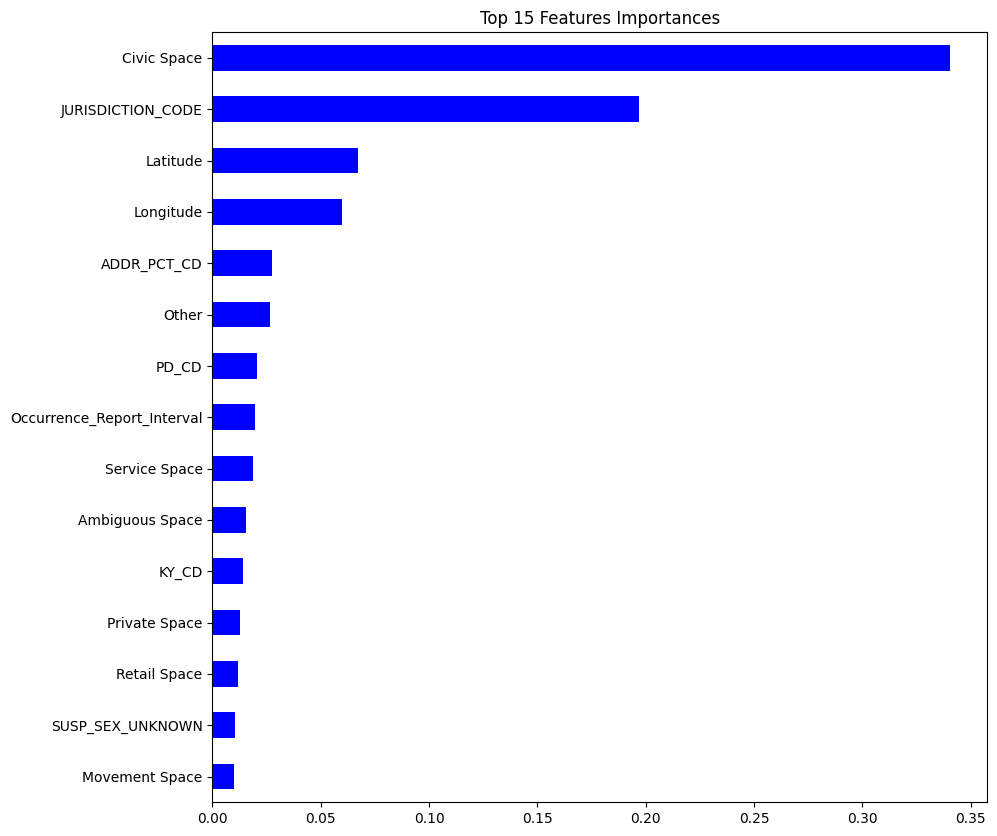

In [7]:
# Create a pd.Series of features importances
importances = pd.Series(data=gb_loaded.feature_importances_,
                        index= X_train.columns)
# Sort importances
importances_sorted = importances.sort_values()

importances_top15 = importances_sorted[-15:]

# Draw a horizontal barplot of the top 15 most important features
plt.figure(figsize=(10,10))
importances_top15.plot(kind='barh', color='blue')
plt.title('Top 15 Features Importances')
plt.show()

## 5.2 RQ2 Model 

First, load the model

In [ ]:
# load the saved model from the file
filename = '/content/drive/My Drive/Colab Notebooks/gb_classifier.pkl'
with open(filename, 'rb') as file:
    loaded_model = pickle.load(file)

# now you can use the loaded model to make predictions
gb = loaded_model

In [ ]:
Treated_Data = pd.read_csv(r'/content/drive/My Drive/Colab Notebooks/Treated_Data.csv')

In [ ]:
# add a variable with inside and oustide (grouping front, rear and opposite of)
Treated_Data['LOCATION'] = Treated_Data['LOC_OF_OCCUR_DESC'].replace(['FRONT OF', 'REAR OF', 'OPPOSITE OF'], 'OUTSIDE')

# Declare target variable and drop the columns that we are not using
X = Treated_Data.drop(['LOCATION'], axis=1)

X = X.drop(['LOC_OF_OCCUR_DESC', 'CMPLNT_FR_DT','CMPLNT_FR_TM','CMPLNT_TO_DT','CMPLNT_TO_TM','RPT_DT'], axis=1)

y = Treated_Data['LOCATION']

# Split data into seperate training and test set
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 0)

# define categorical variables 
categorical = [col for col in X_train.columns if X_train[col].dtypes == 'O']

# define numerical variables
numerical = [col for col in X_train.columns if X_train[col].dtypes != 'O']

In [ ]:
import category_encoders as ce

# encode remaining variables with one-hot encoding
encoder = ce.OneHotEncoder(cols=['LAW_CAT_CD', 'BORO_NM', 'PREM_TYP_DESC', 'SUSP_AGE_GROUP', 
                                 'SUSP_RACE', 'SUSP_SEX', 'PATROL_BORO','VIC_AGE_GROUP','VIC_RACE','VIC_SEX'])

X_train = encoder.fit_transform(X_train)

X_test = encoder.transform(X_test)

In [ ]:
cols = X_train.columns

from sklearn.preprocessing import RobustScaler

# for the scaling we use the RobustScaler from sklearn
scaler = RobustScaler()

X_train = scaler.fit_transform(X_train)

X_test = scaler.transform(X_test)

X_train = pd.DataFrame(X_train, columns=[cols])
X_test = pd.DataFrame(X_test, columns=[cols])

In [ ]:
X_train = X_train.drop(["Unnamed: 0"], axis=1)


### 5.2.1 Validation  

In [ ]:
# Applying 5-Fold Cross Validation

from sklearn.model_selection import cross_val_score

scores = cross_val_score(gb, X_train, y_train, cv = 5, scoring='accuracy')

print('Cross-validation scores:{}'.format(scores))

print('Average cross-validation score: {:.4f}'.format(scores.mean()))

### 5.2.2 Explainability

#### 5.2.2.1 Feature performance

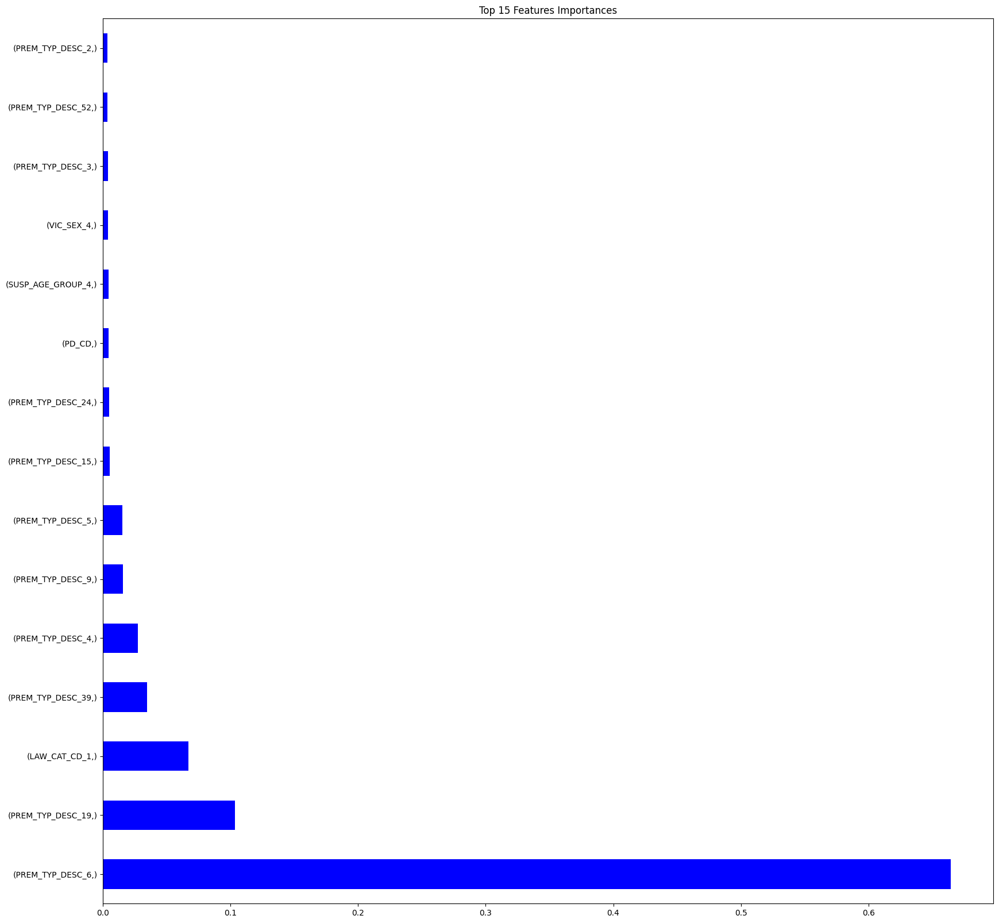

In [21]:
# Create a pd.Series of feature importances
importances = pd.Series(data=gb.feature_importances_, index=X_train.columns)

# Sort importances and select the top 10
importances_sorted = importances.sort_values(ascending=False)[:15]

# Draw a horizontal barplot of importances_sorted
plt.figure(figsize=(20, 20))
importances_sorted.plot(kind='barh', color='blue')
plt.title('Top 15 Features Importances')
plt.show()
